# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

A subdirectory or file data already exists.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')

In [5]:
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

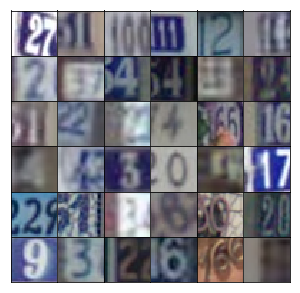

In [6]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [7]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [8]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [9]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [10]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, **we want a sigmoid output**, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like **convolution > batch norm > leaky ReLU**.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [11]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [12]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [13]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [14]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [15]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [16]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [17]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.3194... Generator Loss: 0.8729
Epoch 1/25... Discriminator Loss: 0.3414... Generator Loss: 2.5081
Epoch 1/25... Discriminator Loss: 0.2214... Generator Loss: 2.1089
Epoch 1/25... Discriminator Loss: 0.2755... Generator Loss: 1.7331
Epoch 1/25... Discriminator Loss: 0.1863... Generator Loss: 2.3578
Epoch 1/25... Discriminator Loss: 0.0990... Generator Loss: 2.8611
Epoch 1/25... Discriminator Loss: 0.1928... Generator Loss: 2.4827
Epoch 1/25... Discriminator Loss: 0.1445... Generator Loss: 3.2843
Epoch 1/25... Discriminator Loss: 0.3789... Generator Loss: 1.4016
Epoch 1/25... Discriminator Loss: 0.1337... Generator Loss: 5.5113


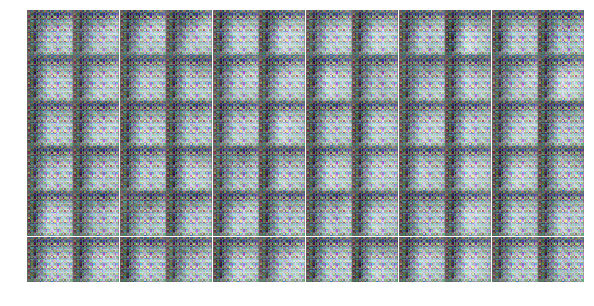

Epoch 1/25... Discriminator Loss: 0.1985... Generator Loss: 2.4010
Epoch 1/25... Discriminator Loss: 0.2774... Generator Loss: 2.9593
Epoch 1/25... Discriminator Loss: 0.9187... Generator Loss: 3.1525
Epoch 1/25... Discriminator Loss: 0.6180... Generator Loss: 1.9929
Epoch 1/25... Discriminator Loss: 0.5948... Generator Loss: 1.1323
Epoch 1/25... Discriminator Loss: 0.3592... Generator Loss: 2.2378
Epoch 1/25... Discriminator Loss: 0.4186... Generator Loss: 1.3214
Epoch 1/25... Discriminator Loss: 0.2517... Generator Loss: 2.5905
Epoch 1/25... Discriminator Loss: 0.2902... Generator Loss: 2.1027
Epoch 1/25... Discriminator Loss: 0.9192... Generator Loss: 1.8122


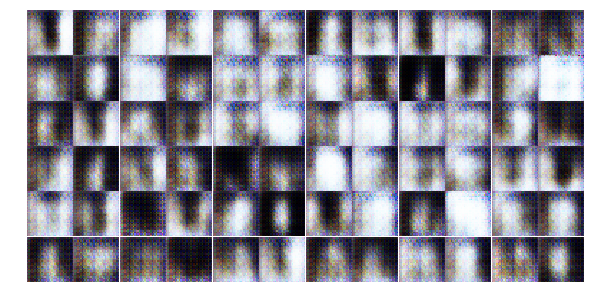

Epoch 1/25... Discriminator Loss: 0.9421... Generator Loss: 0.8324
Epoch 1/25... Discriminator Loss: 0.2583... Generator Loss: 2.5756
Epoch 1/25... Discriminator Loss: 0.1532... Generator Loss: 3.4183
Epoch 1/25... Discriminator Loss: 0.1465... Generator Loss: 4.3964
Epoch 1/25... Discriminator Loss: 0.0478... Generator Loss: 5.1894
Epoch 1/25... Discriminator Loss: 1.9576... Generator Loss: 4.1605
Epoch 1/25... Discriminator Loss: 1.0780... Generator Loss: 1.3774
Epoch 1/25... Discriminator Loss: 1.3945... Generator Loss: 0.8988
Epoch 1/25... Discriminator Loss: 0.8427... Generator Loss: 1.1842
Epoch 1/25... Discriminator Loss: 0.3274... Generator Loss: 2.7212


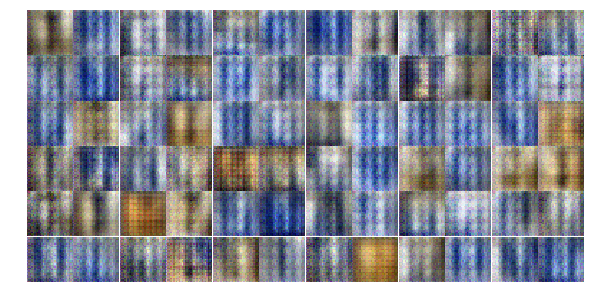

Epoch 1/25... Discriminator Loss: 0.6698... Generator Loss: 1.0008
Epoch 1/25... Discriminator Loss: 0.6717... Generator Loss: 1.0659
Epoch 1/25... Discriminator Loss: 0.4612... Generator Loss: 1.5121
Epoch 1/25... Discriminator Loss: 0.4582... Generator Loss: 1.6939
Epoch 1/25... Discriminator Loss: 1.1595... Generator Loss: 0.7037
Epoch 1/25... Discriminator Loss: 0.7357... Generator Loss: 1.2095
Epoch 1/25... Discriminator Loss: 1.1801... Generator Loss: 1.0037
Epoch 1/25... Discriminator Loss: 0.8004... Generator Loss: 1.4643
Epoch 1/25... Discriminator Loss: 0.5156... Generator Loss: 2.2168
Epoch 1/25... Discriminator Loss: 0.5199... Generator Loss: 1.5866


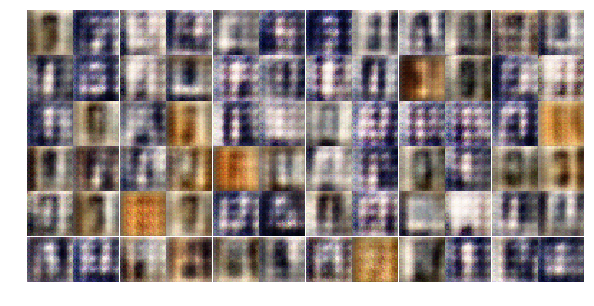

Epoch 1/25... Discriminator Loss: 0.4057... Generator Loss: 2.0706
Epoch 1/25... Discriminator Loss: 0.4060... Generator Loss: 2.0572
Epoch 1/25... Discriminator Loss: 0.5043... Generator Loss: 2.2396
Epoch 1/25... Discriminator Loss: 1.7760... Generator Loss: 0.4124
Epoch 1/25... Discriminator Loss: 0.6950... Generator Loss: 1.4675
Epoch 1/25... Discriminator Loss: 0.6185... Generator Loss: 1.3294
Epoch 1/25... Discriminator Loss: 0.4689... Generator Loss: 1.9059
Epoch 1/25... Discriminator Loss: 0.6650... Generator Loss: 1.5992
Epoch 1/25... Discriminator Loss: 0.6556... Generator Loss: 2.0268
Epoch 1/25... Discriminator Loss: 0.8280... Generator Loss: 1.1668


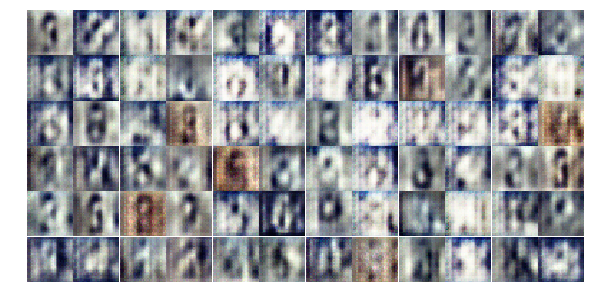

Epoch 1/25... Discriminator Loss: 0.5969... Generator Loss: 1.7286
Epoch 1/25... Discriminator Loss: 0.9022... Generator Loss: 0.8618
Epoch 1/25... Discriminator Loss: 0.6237... Generator Loss: 1.4312
Epoch 1/25... Discriminator Loss: 1.1384... Generator Loss: 0.6982
Epoch 1/25... Discriminator Loss: 0.9510... Generator Loss: 1.5317
Epoch 1/25... Discriminator Loss: 0.6408... Generator Loss: 1.5453
Epoch 1/25... Discriminator Loss: 0.7304... Generator Loss: 1.3126
Epoch 2/25... Discriminator Loss: 1.0102... Generator Loss: 1.3710
Epoch 2/25... Discriminator Loss: 0.6589... Generator Loss: 1.5471
Epoch 2/25... Discriminator Loss: 1.0349... Generator Loss: 0.8837


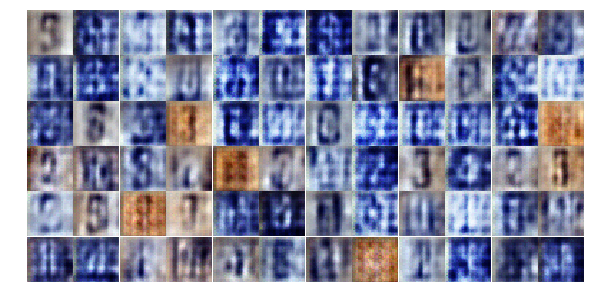

Epoch 2/25... Discriminator Loss: 1.0533... Generator Loss: 1.0782
Epoch 2/25... Discriminator Loss: 1.8048... Generator Loss: 0.3082
Epoch 2/25... Discriminator Loss: 0.9829... Generator Loss: 1.0938
Epoch 2/25... Discriminator Loss: 0.8746... Generator Loss: 1.2679
Epoch 2/25... Discriminator Loss: 0.9739... Generator Loss: 1.1484
Epoch 2/25... Discriminator Loss: 0.8305... Generator Loss: 1.1782
Epoch 2/25... Discriminator Loss: 0.6295... Generator Loss: 1.5167
Epoch 2/25... Discriminator Loss: 0.7425... Generator Loss: 1.2927
Epoch 2/25... Discriminator Loss: 0.8754... Generator Loss: 0.9854
Epoch 2/25... Discriminator Loss: 1.2627... Generator Loss: 0.6914


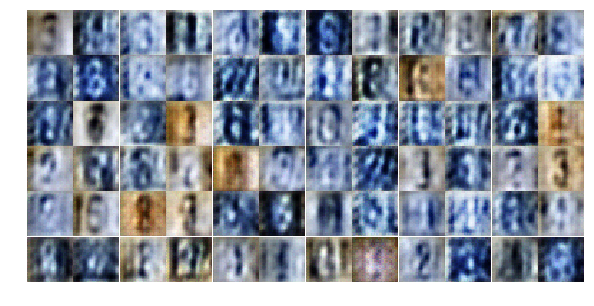

Epoch 2/25... Discriminator Loss: 1.2462... Generator Loss: 1.2714
Epoch 2/25... Discriminator Loss: 1.1531... Generator Loss: 1.9182
Epoch 2/25... Discriminator Loss: 0.7307... Generator Loss: 1.3217
Epoch 2/25... Discriminator Loss: 0.5321... Generator Loss: 1.6586
Epoch 2/25... Discriminator Loss: 1.3482... Generator Loss: 1.3425
Epoch 2/25... Discriminator Loss: 1.1535... Generator Loss: 0.9219
Epoch 2/25... Discriminator Loss: 1.0523... Generator Loss: 1.0564
Epoch 2/25... Discriminator Loss: 1.1851... Generator Loss: 0.7187
Epoch 2/25... Discriminator Loss: 1.2366... Generator Loss: 0.8928
Epoch 2/25... Discriminator Loss: 1.3313... Generator Loss: 0.8124


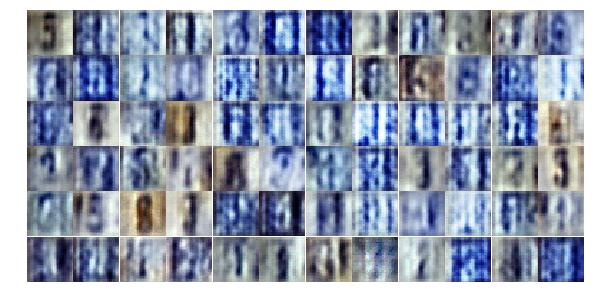

Epoch 2/25... Discriminator Loss: 1.0022... Generator Loss: 0.8610
Epoch 2/25... Discriminator Loss: 0.8812... Generator Loss: 0.8676
Epoch 2/25... Discriminator Loss: 0.7626... Generator Loss: 1.2704
Epoch 2/25... Discriminator Loss: 1.5941... Generator Loss: 0.4536
Epoch 2/25... Discriminator Loss: 0.9200... Generator Loss: 1.6876
Epoch 2/25... Discriminator Loss: 0.7968... Generator Loss: 1.1152
Epoch 2/25... Discriminator Loss: 1.0079... Generator Loss: 0.9445
Epoch 2/25... Discriminator Loss: 1.4321... Generator Loss: 1.0812
Epoch 2/25... Discriminator Loss: 1.2145... Generator Loss: 0.8397
Epoch 2/25... Discriminator Loss: 0.9279... Generator Loss: 0.9717


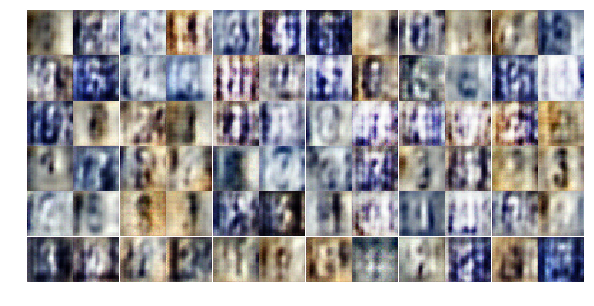

Epoch 2/25... Discriminator Loss: 1.6753... Generator Loss: 0.4360
Epoch 2/25... Discriminator Loss: 1.0779... Generator Loss: 0.8608
Epoch 2/25... Discriminator Loss: 1.5452... Generator Loss: 0.5709
Epoch 2/25... Discriminator Loss: 1.1510... Generator Loss: 0.7072
Epoch 2/25... Discriminator Loss: 1.0899... Generator Loss: 1.0496
Epoch 2/25... Discriminator Loss: 1.0462... Generator Loss: 1.2534
Epoch 2/25... Discriminator Loss: 0.8946... Generator Loss: 1.1769
Epoch 2/25... Discriminator Loss: 0.9867... Generator Loss: 1.0615
Epoch 2/25... Discriminator Loss: 1.0790... Generator Loss: 0.8981
Epoch 2/25... Discriminator Loss: 0.8347... Generator Loss: 1.2753


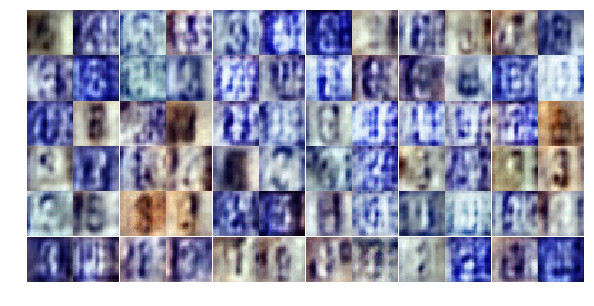

Epoch 2/25... Discriminator Loss: 0.9232... Generator Loss: 1.2544
Epoch 2/25... Discriminator Loss: 1.0958... Generator Loss: 1.0482
Epoch 2/25... Discriminator Loss: 1.1334... Generator Loss: 1.0206
Epoch 2/25... Discriminator Loss: 1.3190... Generator Loss: 0.6073
Epoch 2/25... Discriminator Loss: 0.9456... Generator Loss: 0.9925
Epoch 2/25... Discriminator Loss: 1.2194... Generator Loss: 0.7623
Epoch 2/25... Discriminator Loss: 1.2994... Generator Loss: 1.0904
Epoch 2/25... Discriminator Loss: 1.1671... Generator Loss: 1.2488
Epoch 2/25... Discriminator Loss: 0.8838... Generator Loss: 1.2537
Epoch 2/25... Discriminator Loss: 1.0294... Generator Loss: 0.9535


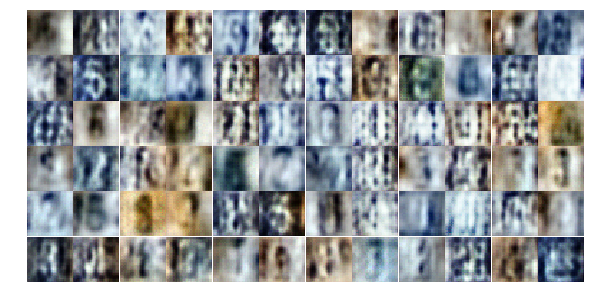

Epoch 2/25... Discriminator Loss: 1.3375... Generator Loss: 1.2694
Epoch 2/25... Discriminator Loss: 1.2452... Generator Loss: 1.0608
Epoch 2/25... Discriminator Loss: 1.0888... Generator Loss: 0.7519
Epoch 2/25... Discriminator Loss: 0.8750... Generator Loss: 0.9540
Epoch 3/25... Discriminator Loss: 0.9122... Generator Loss: 1.6260
Epoch 3/25... Discriminator Loss: 0.9942... Generator Loss: 1.0963
Epoch 3/25... Discriminator Loss: 1.1611... Generator Loss: 0.8554
Epoch 3/25... Discriminator Loss: 0.8462... Generator Loss: 0.9889
Epoch 3/25... Discriminator Loss: 0.8316... Generator Loss: 1.0021
Epoch 3/25... Discriminator Loss: 0.8861... Generator Loss: 1.1793


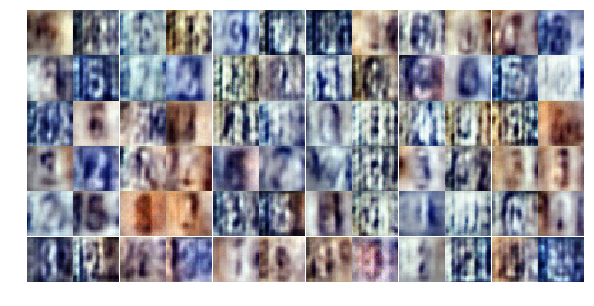

Epoch 3/25... Discriminator Loss: 1.0697... Generator Loss: 0.7081
Epoch 3/25... Discriminator Loss: 1.3083... Generator Loss: 0.5936
Epoch 3/25... Discriminator Loss: 0.8794... Generator Loss: 1.1317
Epoch 3/25... Discriminator Loss: 0.8693... Generator Loss: 1.2150
Epoch 3/25... Discriminator Loss: 0.9222... Generator Loss: 0.9981
Epoch 3/25... Discriminator Loss: 0.8360... Generator Loss: 1.4269
Epoch 3/25... Discriminator Loss: 1.0717... Generator Loss: 1.1702
Epoch 3/25... Discriminator Loss: 0.7277... Generator Loss: 1.2228
Epoch 3/25... Discriminator Loss: 0.9658... Generator Loss: 0.7604
Epoch 3/25... Discriminator Loss: 0.9901... Generator Loss: 0.8524


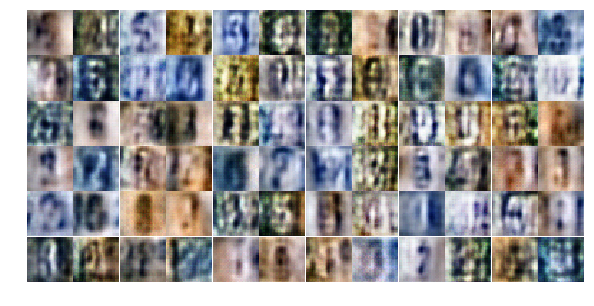

Epoch 3/25... Discriminator Loss: 1.0146... Generator Loss: 1.2645
Epoch 3/25... Discriminator Loss: 0.6852... Generator Loss: 1.2495
Epoch 3/25... Discriminator Loss: 0.8397... Generator Loss: 1.1496
Epoch 3/25... Discriminator Loss: 0.8698... Generator Loss: 1.0999
Epoch 3/25... Discriminator Loss: 0.9471... Generator Loss: 1.0500
Epoch 3/25... Discriminator Loss: 0.7453... Generator Loss: 1.1194
Epoch 3/25... Discriminator Loss: 0.7600... Generator Loss: 2.2239
Epoch 3/25... Discriminator Loss: 1.1814... Generator Loss: 1.6388
Epoch 3/25... Discriminator Loss: 0.7865... Generator Loss: 1.2884
Epoch 3/25... Discriminator Loss: 0.6602... Generator Loss: 1.1310


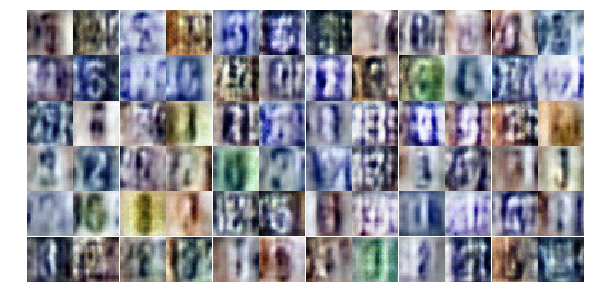

Epoch 3/25... Discriminator Loss: 0.6804... Generator Loss: 1.8496
Epoch 3/25... Discriminator Loss: 0.8921... Generator Loss: 0.9664
Epoch 3/25... Discriminator Loss: 1.2767... Generator Loss: 0.4996
Epoch 3/25... Discriminator Loss: 0.7649... Generator Loss: 1.1534
Epoch 3/25... Discriminator Loss: 0.8436... Generator Loss: 0.8165
Epoch 3/25... Discriminator Loss: 0.6384... Generator Loss: 1.3417
Epoch 3/25... Discriminator Loss: 0.9489... Generator Loss: 0.8594
Epoch 3/25... Discriminator Loss: 0.6424... Generator Loss: 1.8758
Epoch 3/25... Discriminator Loss: 0.7320... Generator Loss: 1.1072
Epoch 3/25... Discriminator Loss: 0.8647... Generator Loss: 0.9133


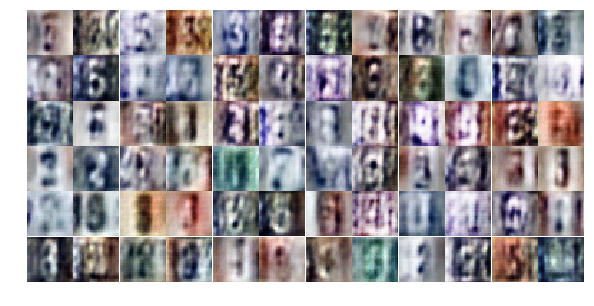

Epoch 3/25... Discriminator Loss: 0.5977... Generator Loss: 1.4972
Epoch 3/25... Discriminator Loss: 0.3378... Generator Loss: 2.0807
Epoch 3/25... Discriminator Loss: 0.8968... Generator Loss: 0.8911
Epoch 3/25... Discriminator Loss: 0.8523... Generator Loss: 0.8523
Epoch 3/25... Discriminator Loss: 0.8014... Generator Loss: 1.3864
Epoch 3/25... Discriminator Loss: 1.0433... Generator Loss: 0.8856
Epoch 3/25... Discriminator Loss: 0.7905... Generator Loss: 1.1258
Epoch 3/25... Discriminator Loss: 0.3641... Generator Loss: 1.9772
Epoch 3/25... Discriminator Loss: 0.4538... Generator Loss: 1.6815
Epoch 3/25... Discriminator Loss: 0.7828... Generator Loss: 0.9012


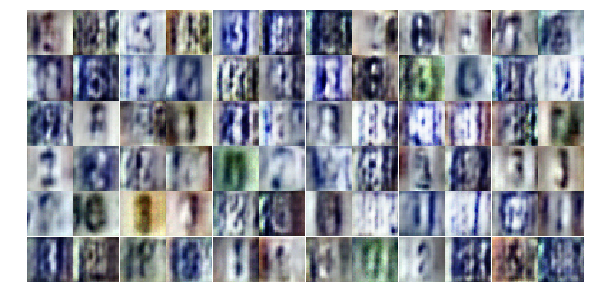

Epoch 3/25... Discriminator Loss: 0.6682... Generator Loss: 1.3165
Epoch 3/25... Discriminator Loss: 1.2352... Generator Loss: 0.5659
Epoch 3/25... Discriminator Loss: 0.4345... Generator Loss: 1.7834
Epoch 3/25... Discriminator Loss: 0.6992... Generator Loss: 1.5391
Epoch 3/25... Discriminator Loss: 0.4932... Generator Loss: 2.1834
Epoch 3/25... Discriminator Loss: 0.5189... Generator Loss: 2.1669
Epoch 3/25... Discriminator Loss: 0.6362... Generator Loss: 2.2534
Epoch 3/25... Discriminator Loss: 0.3889... Generator Loss: 1.7120
Epoch 3/25... Discriminator Loss: 0.7354... Generator Loss: 1.1956
Epoch 3/25... Discriminator Loss: 0.4536... Generator Loss: 2.4050


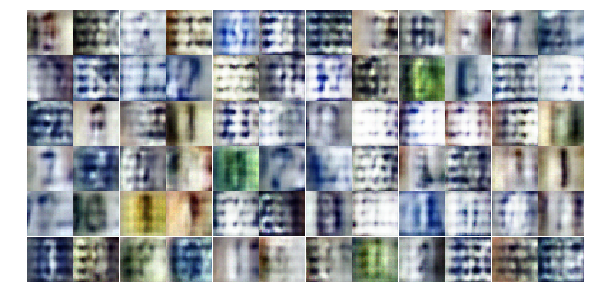

Epoch 3/25... Discriminator Loss: 1.3849... Generator Loss: 0.4717
Epoch 4/25... Discriminator Loss: 1.0689... Generator Loss: 0.6568
Epoch 4/25... Discriminator Loss: 0.6239... Generator Loss: 1.8889
Epoch 4/25... Discriminator Loss: 0.6012... Generator Loss: 1.5978
Epoch 4/25... Discriminator Loss: 0.4228... Generator Loss: 2.6598
Epoch 4/25... Discriminator Loss: 0.4298... Generator Loss: 2.0528
Epoch 4/25... Discriminator Loss: 0.8390... Generator Loss: 0.8730
Epoch 4/25... Discriminator Loss: 0.4217... Generator Loss: 1.7903
Epoch 4/25... Discriminator Loss: 0.4066... Generator Loss: 1.7502
Epoch 4/25... Discriminator Loss: 0.4198... Generator Loss: 1.9326


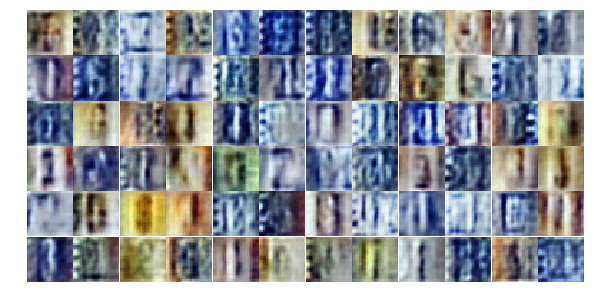

Epoch 4/25... Discriminator Loss: 0.4243... Generator Loss: 2.4544
Epoch 4/25... Discriminator Loss: 0.4418... Generator Loss: 1.4967
Epoch 4/25... Discriminator Loss: 1.1101... Generator Loss: 1.2910
Epoch 4/25... Discriminator Loss: 1.5786... Generator Loss: 0.4668
Epoch 4/25... Discriminator Loss: 0.7848... Generator Loss: 1.0510
Epoch 4/25... Discriminator Loss: 0.7466... Generator Loss: 1.1044
Epoch 4/25... Discriminator Loss: 0.6890... Generator Loss: 1.6953
Epoch 4/25... Discriminator Loss: 0.6593... Generator Loss: 1.1450
Epoch 4/25... Discriminator Loss: 0.6517... Generator Loss: 1.3228
Epoch 4/25... Discriminator Loss: 0.4287... Generator Loss: 1.7634


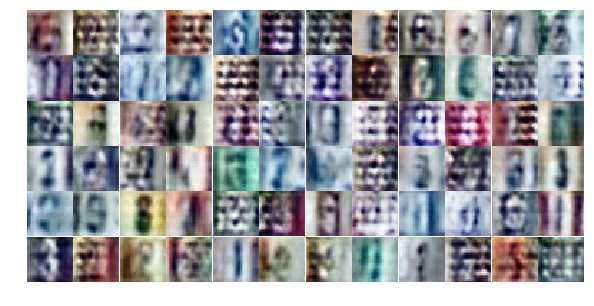

Epoch 4/25... Discriminator Loss: 0.4617... Generator Loss: 1.6855
Epoch 4/25... Discriminator Loss: 0.2722... Generator Loss: 2.2412
Epoch 4/25... Discriminator Loss: 0.5435... Generator Loss: 1.7020
Epoch 4/25... Discriminator Loss: 1.0662... Generator Loss: 2.9035
Epoch 4/25... Discriminator Loss: 0.5890... Generator Loss: 1.7149
Epoch 4/25... Discriminator Loss: 0.3748... Generator Loss: 2.1173
Epoch 4/25... Discriminator Loss: 0.5666... Generator Loss: 1.5049
Epoch 4/25... Discriminator Loss: 0.7035... Generator Loss: 0.9554
Epoch 4/25... Discriminator Loss: 0.4810... Generator Loss: 1.5382
Epoch 4/25... Discriminator Loss: 1.3861... Generator Loss: 2.0193


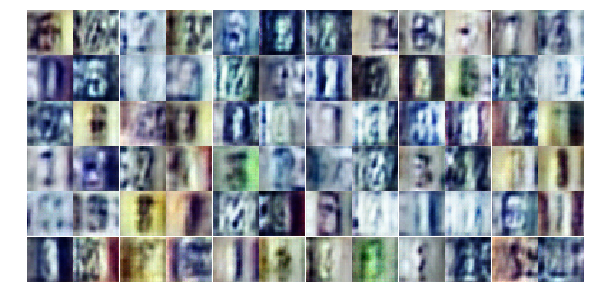

Epoch 4/25... Discriminator Loss: 0.7835... Generator Loss: 0.8958
Epoch 4/25... Discriminator Loss: 0.7036... Generator Loss: 1.3431
Epoch 4/25... Discriminator Loss: 0.6377... Generator Loss: 1.6101
Epoch 4/25... Discriminator Loss: 0.5933... Generator Loss: 1.3903
Epoch 4/25... Discriminator Loss: 0.6330... Generator Loss: 1.1705
Epoch 4/25... Discriminator Loss: 0.5380... Generator Loss: 1.4441
Epoch 4/25... Discriminator Loss: 0.6401... Generator Loss: 1.6586
Epoch 4/25... Discriminator Loss: 0.5973... Generator Loss: 1.6795
Epoch 4/25... Discriminator Loss: 0.7608... Generator Loss: 0.9884
Epoch 4/25... Discriminator Loss: 0.7262... Generator Loss: 0.9866


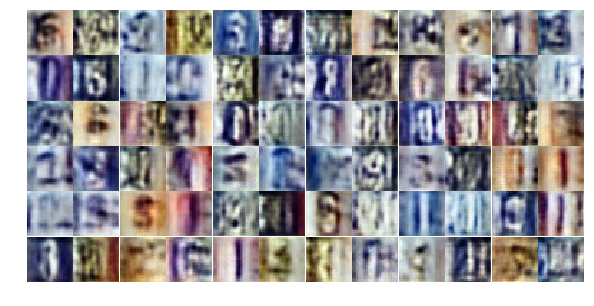

Epoch 4/25... Discriminator Loss: 0.7720... Generator Loss: 1.4066
Epoch 4/25... Discriminator Loss: 0.5481... Generator Loss: 2.1484
Epoch 4/25... Discriminator Loss: 1.0412... Generator Loss: 0.6296
Epoch 4/25... Discriminator Loss: 0.6885... Generator Loss: 2.2005
Epoch 4/25... Discriminator Loss: 0.5722... Generator Loss: 1.2928
Epoch 4/25... Discriminator Loss: 1.0012... Generator Loss: 0.6896
Epoch 4/25... Discriminator Loss: 1.9337... Generator Loss: 0.2199
Epoch 4/25... Discriminator Loss: 0.6713... Generator Loss: 1.2389
Epoch 4/25... Discriminator Loss: 0.7195... Generator Loss: 0.9758
Epoch 4/25... Discriminator Loss: 0.8019... Generator Loss: 1.0352


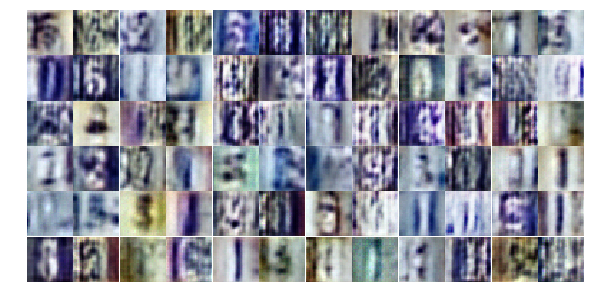

Epoch 4/25... Discriminator Loss: 0.4260... Generator Loss: 1.9904
Epoch 4/25... Discriminator Loss: 0.5595... Generator Loss: 1.3267
Epoch 4/25... Discriminator Loss: 0.4744... Generator Loss: 1.5177
Epoch 4/25... Discriminator Loss: 0.6009... Generator Loss: 1.5298
Epoch 4/25... Discriminator Loss: 1.0177... Generator Loss: 0.7061
Epoch 4/25... Discriminator Loss: 0.5699... Generator Loss: 1.3845
Epoch 4/25... Discriminator Loss: 0.3514... Generator Loss: 2.3897
Epoch 4/25... Discriminator Loss: 0.6338... Generator Loss: 1.1312
Epoch 4/25... Discriminator Loss: 0.5702... Generator Loss: 1.3104
Epoch 5/25... Discriminator Loss: 0.4599... Generator Loss: 1.8246


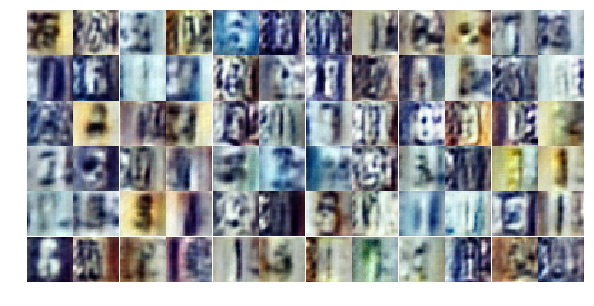

Epoch 5/25... Discriminator Loss: 0.7365... Generator Loss: 0.9237
Epoch 5/25... Discriminator Loss: 0.5885... Generator Loss: 1.1580
Epoch 5/25... Discriminator Loss: 0.6805... Generator Loss: 1.3569
Epoch 5/25... Discriminator Loss: 0.3019... Generator Loss: 1.9133
Epoch 5/25... Discriminator Loss: 0.5557... Generator Loss: 2.8308
Epoch 5/25... Discriminator Loss: 0.5275... Generator Loss: 1.2468
Epoch 5/25... Discriminator Loss: 0.4085... Generator Loss: 2.1880
Epoch 5/25... Discriminator Loss: 0.8534... Generator Loss: 0.7987
Epoch 5/25... Discriminator Loss: 0.4719... Generator Loss: 1.6813
Epoch 5/25... Discriminator Loss: 0.6280... Generator Loss: 2.1877


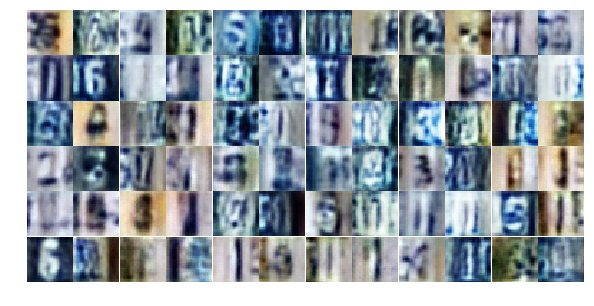

Epoch 5/25... Discriminator Loss: 1.5181... Generator Loss: 0.4503
Epoch 5/25... Discriminator Loss: 0.3149... Generator Loss: 2.0346
Epoch 5/25... Discriminator Loss: 0.6555... Generator Loss: 1.0957
Epoch 5/25... Discriminator Loss: 0.7864... Generator Loss: 0.8856
Epoch 5/25... Discriminator Loss: 0.4113... Generator Loss: 1.7771
Epoch 5/25... Discriminator Loss: 0.4769... Generator Loss: 1.9698
Epoch 5/25... Discriminator Loss: 0.4863... Generator Loss: 1.3865
Epoch 5/25... Discriminator Loss: 0.4134... Generator Loss: 1.8410
Epoch 5/25... Discriminator Loss: 0.3788... Generator Loss: 1.9049
Epoch 5/25... Discriminator Loss: 0.3502... Generator Loss: 1.7628


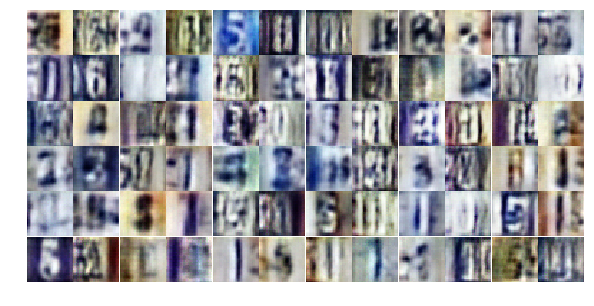

Epoch 5/25... Discriminator Loss: 0.2912... Generator Loss: 2.1352
Epoch 5/25... Discriminator Loss: 0.6003... Generator Loss: 1.3686
Epoch 5/25... Discriminator Loss: 0.4098... Generator Loss: 1.8437
Epoch 5/25... Discriminator Loss: 0.5075... Generator Loss: 1.3534
Epoch 5/25... Discriminator Loss: 0.4993... Generator Loss: 1.2632
Epoch 5/25... Discriminator Loss: 0.4532... Generator Loss: 1.4028
Epoch 5/25... Discriminator Loss: 0.5616... Generator Loss: 1.2652
Epoch 5/25... Discriminator Loss: 0.4547... Generator Loss: 1.4924
Epoch 5/25... Discriminator Loss: 0.4868... Generator Loss: 1.5188
Epoch 5/25... Discriminator Loss: 0.8499... Generator Loss: 0.7675


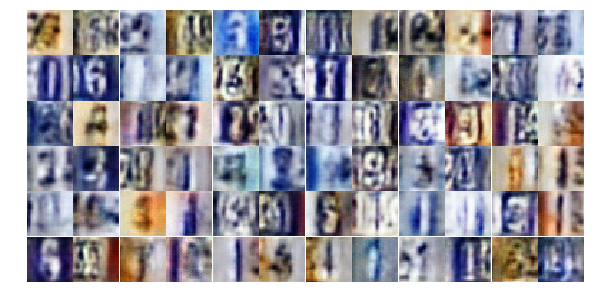

Epoch 5/25... Discriminator Loss: 0.7241... Generator Loss: 1.1016
Epoch 5/25... Discriminator Loss: 0.3881... Generator Loss: 1.6699
Epoch 5/25... Discriminator Loss: 0.4236... Generator Loss: 1.7462
Epoch 5/25... Discriminator Loss: 0.6729... Generator Loss: 0.9767
Epoch 5/25... Discriminator Loss: 0.5247... Generator Loss: 3.3532
Epoch 5/25... Discriminator Loss: 0.3839... Generator Loss: 1.8704
Epoch 5/25... Discriminator Loss: 0.6751... Generator Loss: 0.9579
Epoch 5/25... Discriminator Loss: 0.5155... Generator Loss: 1.1811
Epoch 5/25... Discriminator Loss: 0.8246... Generator Loss: 0.8668
Epoch 5/25... Discriminator Loss: 0.6862... Generator Loss: 1.0683


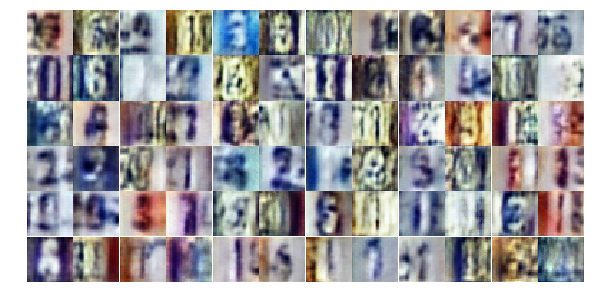

Epoch 5/25... Discriminator Loss: 0.3687... Generator Loss: 1.8038
Epoch 5/25... Discriminator Loss: 1.0834... Generator Loss: 0.6503
Epoch 5/25... Discriminator Loss: 1.6178... Generator Loss: 0.3055
Epoch 5/25... Discriminator Loss: 0.5678... Generator Loss: 1.3857
Epoch 5/25... Discriminator Loss: 0.5530... Generator Loss: 1.4853
Epoch 5/25... Discriminator Loss: 1.6805... Generator Loss: 0.3080
Epoch 5/25... Discriminator Loss: 0.9055... Generator Loss: 1.9767
Epoch 5/25... Discriminator Loss: 0.4237... Generator Loss: 1.7525
Epoch 5/25... Discriminator Loss: 0.6875... Generator Loss: 1.0629
Epoch 5/25... Discriminator Loss: 0.5704... Generator Loss: 1.2305


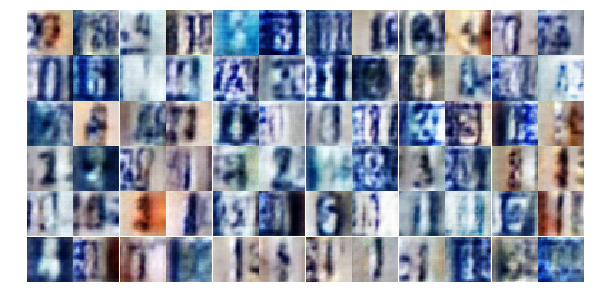

Epoch 5/25... Discriminator Loss: 0.9643... Generator Loss: 0.7104
Epoch 5/25... Discriminator Loss: 0.4830... Generator Loss: 1.5647
Epoch 5/25... Discriminator Loss: 0.7091... Generator Loss: 0.9824
Epoch 5/25... Discriminator Loss: 0.4501... Generator Loss: 1.3734
Epoch 5/25... Discriminator Loss: 0.4796... Generator Loss: 1.3587
Epoch 5/25... Discriminator Loss: 0.4303... Generator Loss: 2.3571
Epoch 6/25... Discriminator Loss: 0.7656... Generator Loss: 0.8751
Epoch 6/25... Discriminator Loss: 0.2961... Generator Loss: 2.0120
Epoch 6/25... Discriminator Loss: 0.4208... Generator Loss: 1.7376
Epoch 6/25... Discriminator Loss: 0.8594... Generator Loss: 0.7628


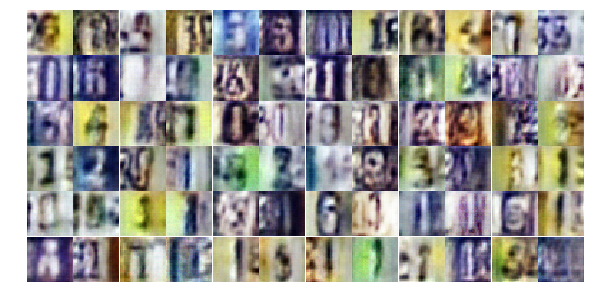

Epoch 6/25... Discriminator Loss: 0.5873... Generator Loss: 1.1831
Epoch 6/25... Discriminator Loss: 0.4703... Generator Loss: 1.6630
Epoch 6/25... Discriminator Loss: 0.5555... Generator Loss: 1.5061
Epoch 6/25... Discriminator Loss: 0.6577... Generator Loss: 1.0928
Epoch 6/25... Discriminator Loss: 0.8991... Generator Loss: 0.7060
Epoch 6/25... Discriminator Loss: 0.3602... Generator Loss: 2.2548
Epoch 6/25... Discriminator Loss: 0.3714... Generator Loss: 1.9028
Epoch 6/25... Discriminator Loss: 0.8410... Generator Loss: 0.7621
Epoch 6/25... Discriminator Loss: 0.5250... Generator Loss: 1.3606
Epoch 6/25... Discriminator Loss: 0.4953... Generator Loss: 1.6585


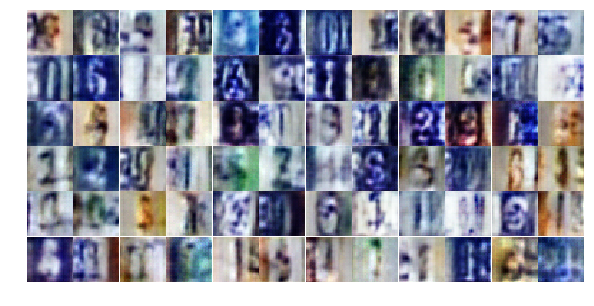

Epoch 6/25... Discriminator Loss: 0.3722... Generator Loss: 2.0398
Epoch 6/25... Discriminator Loss: 0.7171... Generator Loss: 1.1684
Epoch 6/25... Discriminator Loss: 0.9722... Generator Loss: 0.6346
Epoch 6/25... Discriminator Loss: 0.9335... Generator Loss: 0.7198
Epoch 6/25... Discriminator Loss: 0.4442... Generator Loss: 1.7817
Epoch 6/25... Discriminator Loss: 0.4604... Generator Loss: 1.7427
Epoch 6/25... Discriminator Loss: 0.5433... Generator Loss: 1.7435
Epoch 6/25... Discriminator Loss: 0.6366... Generator Loss: 1.0422
Epoch 6/25... Discriminator Loss: 0.8603... Generator Loss: 3.2618
Epoch 6/25... Discriminator Loss: 0.7296... Generator Loss: 0.9180


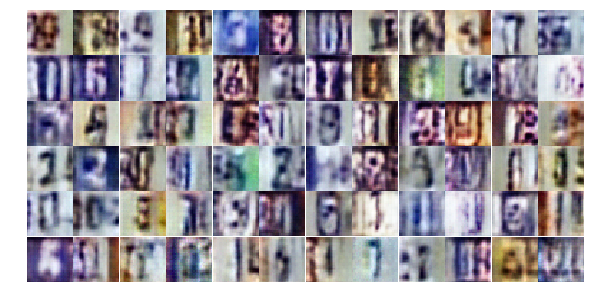

Epoch 6/25... Discriminator Loss: 1.1591... Generator Loss: 0.5015
Epoch 6/25... Discriminator Loss: 0.6214... Generator Loss: 1.1082
Epoch 6/25... Discriminator Loss: 1.3625... Generator Loss: 0.4555
Epoch 6/25... Discriminator Loss: 0.6099... Generator Loss: 1.9798
Epoch 6/25... Discriminator Loss: 0.5140... Generator Loss: 1.4650
Epoch 6/25... Discriminator Loss: 1.2817... Generator Loss: 0.5771
Epoch 6/25... Discriminator Loss: 0.6105... Generator Loss: 2.4443
Epoch 6/25... Discriminator Loss: 0.3312... Generator Loss: 1.8775
Epoch 6/25... Discriminator Loss: 0.5472... Generator Loss: 1.5217
Epoch 6/25... Discriminator Loss: 0.4435... Generator Loss: 2.0451


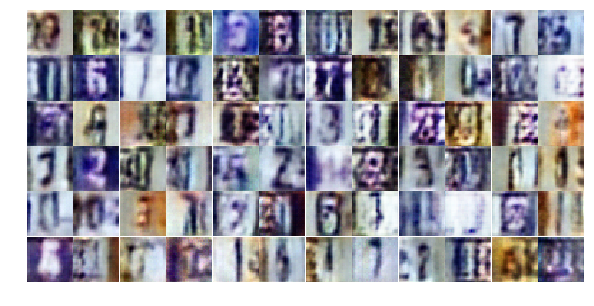

Epoch 6/25... Discriminator Loss: 0.8261... Generator Loss: 0.8178
Epoch 6/25... Discriminator Loss: 0.9648... Generator Loss: 4.2119
Epoch 6/25... Discriminator Loss: 1.0101... Generator Loss: 1.1024
Epoch 6/25... Discriminator Loss: 0.3581... Generator Loss: 1.6926
Epoch 6/25... Discriminator Loss: 0.5540... Generator Loss: 1.7728
Epoch 6/25... Discriminator Loss: 0.6755... Generator Loss: 1.0483
Epoch 6/25... Discriminator Loss: 0.9892... Generator Loss: 0.8801
Epoch 6/25... Discriminator Loss: 0.4320... Generator Loss: 1.6581
Epoch 6/25... Discriminator Loss: 0.8117... Generator Loss: 0.8548
Epoch 6/25... Discriminator Loss: 0.2897... Generator Loss: 2.0925


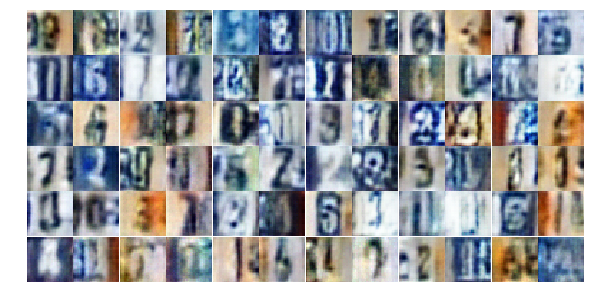

Epoch 6/25... Discriminator Loss: 0.6280... Generator Loss: 1.3864
Epoch 6/25... Discriminator Loss: 1.5931... Generator Loss: 0.3228
Epoch 6/25... Discriminator Loss: 0.7839... Generator Loss: 0.8762
Epoch 6/25... Discriminator Loss: 0.4092... Generator Loss: 1.7270
Epoch 6/25... Discriminator Loss: 0.4116... Generator Loss: 2.0349
Epoch 6/25... Discriminator Loss: 0.5591... Generator Loss: 1.2652
Epoch 6/25... Discriminator Loss: 0.9668... Generator Loss: 2.3966
Epoch 6/25... Discriminator Loss: 1.1372... Generator Loss: 0.5221
Epoch 6/25... Discriminator Loss: 1.0476... Generator Loss: 0.6229
Epoch 6/25... Discriminator Loss: 1.8697... Generator Loss: 0.2352


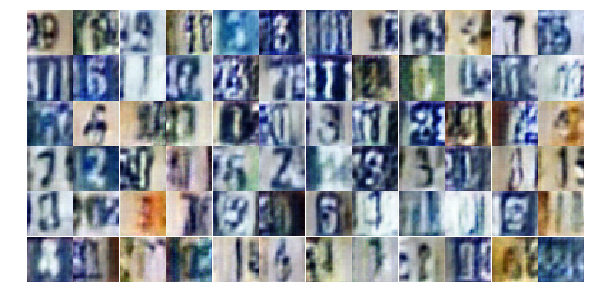

Epoch 6/25... Discriminator Loss: 0.4804... Generator Loss: 1.4810
Epoch 6/25... Discriminator Loss: 0.2644... Generator Loss: 2.2264
Epoch 6/25... Discriminator Loss: 0.7113... Generator Loss: 0.9607
Epoch 7/25... Discriminator Loss: 0.5036... Generator Loss: 2.0398
Epoch 7/25... Discriminator Loss: 0.6178... Generator Loss: 1.1906
Epoch 7/25... Discriminator Loss: 0.5090... Generator Loss: 1.4733
Epoch 7/25... Discriminator Loss: 0.6280... Generator Loss: 1.0375
Epoch 7/25... Discriminator Loss: 0.4472... Generator Loss: 1.8913
Epoch 7/25... Discriminator Loss: 0.4809... Generator Loss: 2.0784
Epoch 7/25... Discriminator Loss: 1.4583... Generator Loss: 0.3431


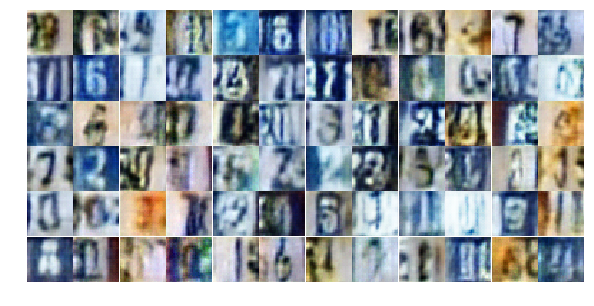

Epoch 7/25... Discriminator Loss: 0.7307... Generator Loss: 1.2506
Epoch 7/25... Discriminator Loss: 1.0712... Generator Loss: 0.5531
Epoch 7/25... Discriminator Loss: 0.9703... Generator Loss: 0.6807
Epoch 7/25... Discriminator Loss: 0.6638... Generator Loss: 1.1969
Epoch 7/25... Discriminator Loss: 0.5276... Generator Loss: 1.2226
Epoch 7/25... Discriminator Loss: 0.7226... Generator Loss: 0.8621
Epoch 7/25... Discriminator Loss: 0.6497... Generator Loss: 2.1723
Epoch 7/25... Discriminator Loss: 0.8064... Generator Loss: 2.6303
Epoch 7/25... Discriminator Loss: 0.5364... Generator Loss: 1.9040
Epoch 7/25... Discriminator Loss: 0.9634... Generator Loss: 1.2864


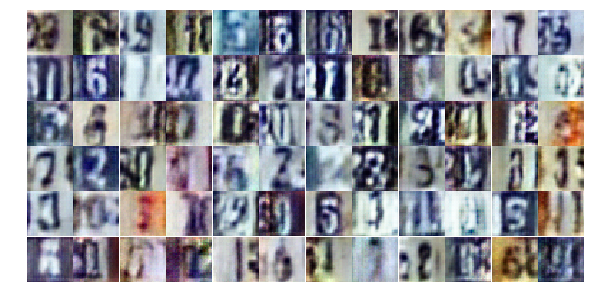

Epoch 7/25... Discriminator Loss: 0.6395... Generator Loss: 1.5817
Epoch 7/25... Discriminator Loss: 0.4227... Generator Loss: 1.6813
Epoch 7/25... Discriminator Loss: 0.7006... Generator Loss: 1.0774
Epoch 7/25... Discriminator Loss: 0.5078... Generator Loss: 1.4814
Epoch 7/25... Discriminator Loss: 0.4776... Generator Loss: 1.5892
Epoch 7/25... Discriminator Loss: 0.6374... Generator Loss: 1.1251
Epoch 7/25... Discriminator Loss: 0.6981... Generator Loss: 1.0673
Epoch 7/25... Discriminator Loss: 0.9705... Generator Loss: 0.6773
Epoch 7/25... Discriminator Loss: 0.3900... Generator Loss: 1.9484
Epoch 7/25... Discriminator Loss: 0.5427... Generator Loss: 1.4845


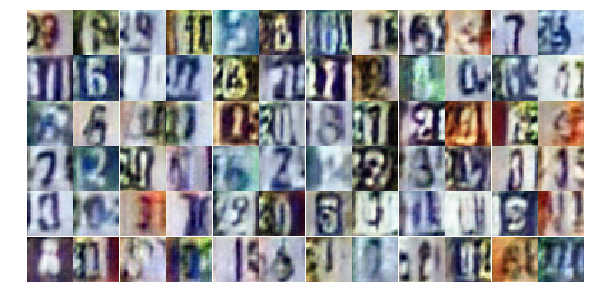

Epoch 7/25... Discriminator Loss: 0.8264... Generator Loss: 0.7891
Epoch 7/25... Discriminator Loss: 1.1462... Generator Loss: 0.5185
Epoch 7/25... Discriminator Loss: 0.7237... Generator Loss: 0.9410
Epoch 7/25... Discriminator Loss: 0.4751... Generator Loss: 1.4809
Epoch 7/25... Discriminator Loss: 0.7974... Generator Loss: 0.7890
Epoch 7/25... Discriminator Loss: 0.8938... Generator Loss: 0.7149
Epoch 7/25... Discriminator Loss: 0.5308... Generator Loss: 1.1735
Epoch 7/25... Discriminator Loss: 0.6328... Generator Loss: 1.4536
Epoch 7/25... Discriminator Loss: 1.4905... Generator Loss: 0.3447
Epoch 7/25... Discriminator Loss: 0.6894... Generator Loss: 3.0838


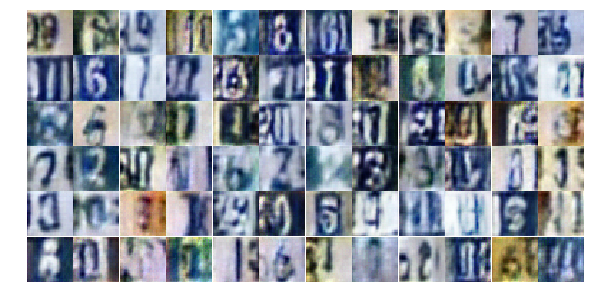

Epoch 7/25... Discriminator Loss: 1.0170... Generator Loss: 1.0213
Epoch 7/25... Discriminator Loss: 0.5669... Generator Loss: 1.3563
Epoch 7/25... Discriminator Loss: 0.3856... Generator Loss: 1.5293
Epoch 7/25... Discriminator Loss: 0.5719... Generator Loss: 1.2598
Epoch 7/25... Discriminator Loss: 0.6611... Generator Loss: 2.2803
Epoch 7/25... Discriminator Loss: 0.5971... Generator Loss: 1.1248
Epoch 7/25... Discriminator Loss: 0.6269... Generator Loss: 1.1223
Epoch 7/25... Discriminator Loss: 1.0364... Generator Loss: 2.0990
Epoch 7/25... Discriminator Loss: 0.3313... Generator Loss: 3.2020
Epoch 7/25... Discriminator Loss: 1.7507... Generator Loss: 0.2839


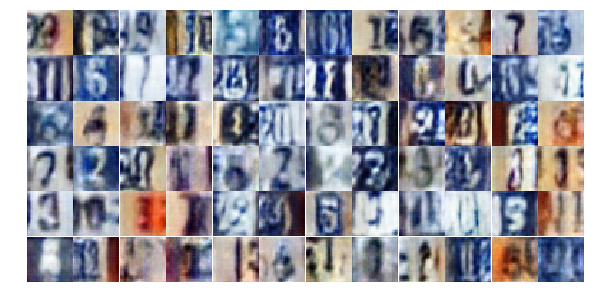

Epoch 7/25... Discriminator Loss: 0.6330... Generator Loss: 2.2629
Epoch 7/25... Discriminator Loss: 1.0136... Generator Loss: 1.0265
Epoch 7/25... Discriminator Loss: 0.7469... Generator Loss: 1.1593
Epoch 7/25... Discriminator Loss: 0.6854... Generator Loss: 1.0635
Epoch 7/25... Discriminator Loss: 0.5328... Generator Loss: 1.3439
Epoch 7/25... Discriminator Loss: 0.6135... Generator Loss: 1.7592
Epoch 7/25... Discriminator Loss: 1.6547... Generator Loss: 0.2913
Epoch 7/25... Discriminator Loss: 0.6262... Generator Loss: 1.4652
Epoch 7/25... Discriminator Loss: 0.6623... Generator Loss: 1.0509
Epoch 7/25... Discriminator Loss: 0.6009... Generator Loss: 1.1076


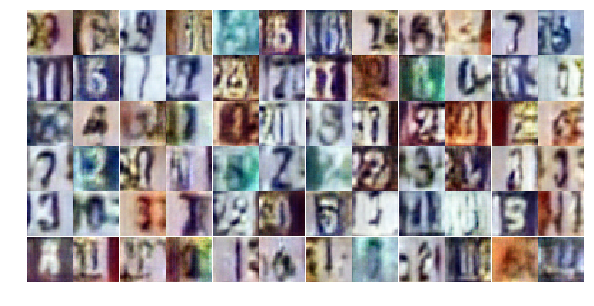

Epoch 7/25... Discriminator Loss: 0.6078... Generator Loss: 2.3307
Epoch 8/25... Discriminator Loss: 0.6986... Generator Loss: 0.9396
Epoch 8/25... Discriminator Loss: 0.8181... Generator Loss: 0.7873
Epoch 8/25... Discriminator Loss: 1.1150... Generator Loss: 0.5689
Epoch 8/25... Discriminator Loss: 0.6501... Generator Loss: 2.3299
Epoch 8/25... Discriminator Loss: 0.8595... Generator Loss: 1.7976
Epoch 8/25... Discriminator Loss: 0.8220... Generator Loss: 0.7677
Epoch 8/25... Discriminator Loss: 0.3931... Generator Loss: 1.9329
Epoch 8/25... Discriminator Loss: 0.6888... Generator Loss: 1.2136
Epoch 8/25... Discriminator Loss: 0.8317... Generator Loss: 1.5435


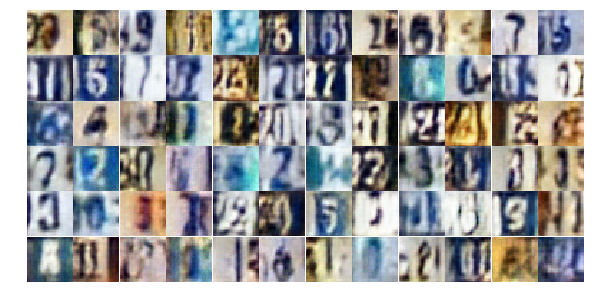

Epoch 8/25... Discriminator Loss: 0.4209... Generator Loss: 1.6897
Epoch 8/25... Discriminator Loss: 0.5315... Generator Loss: 1.1462
Epoch 8/25... Discriminator Loss: 0.9560... Generator Loss: 0.7667
Epoch 8/25... Discriminator Loss: 0.3985... Generator Loss: 1.7988
Epoch 8/25... Discriminator Loss: 0.8420... Generator Loss: 1.6090
Epoch 8/25... Discriminator Loss: 1.8709... Generator Loss: 3.9576
Epoch 8/25... Discriminator Loss: 0.6452... Generator Loss: 1.2837
Epoch 8/25... Discriminator Loss: 0.8358... Generator Loss: 0.8901
Epoch 8/25... Discriminator Loss: 0.8615... Generator Loss: 0.7888
Epoch 8/25... Discriminator Loss: 1.6122... Generator Loss: 0.3377


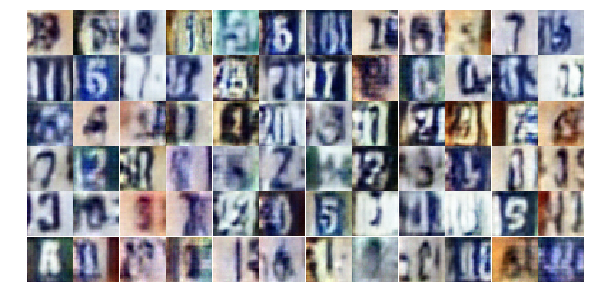

Epoch 8/25... Discriminator Loss: 0.4274... Generator Loss: 2.1570
Epoch 8/25... Discriminator Loss: 0.5050... Generator Loss: 1.3639
Epoch 8/25... Discriminator Loss: 0.8409... Generator Loss: 0.8135
Epoch 8/25... Discriminator Loss: 0.8651... Generator Loss: 0.8170
Epoch 8/25... Discriminator Loss: 0.4286... Generator Loss: 1.5816
Epoch 8/25... Discriminator Loss: 0.8067... Generator Loss: 1.7901
Epoch 8/25... Discriminator Loss: 0.5876... Generator Loss: 1.2427
Epoch 8/25... Discriminator Loss: 0.4752... Generator Loss: 1.4121
Epoch 8/25... Discriminator Loss: 0.5044... Generator Loss: 1.5580
Epoch 8/25... Discriminator Loss: 1.2152... Generator Loss: 0.4835


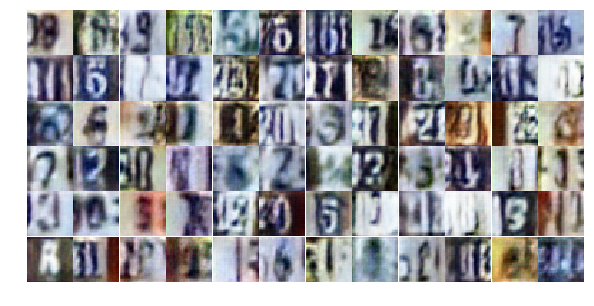

Epoch 8/25... Discriminator Loss: 0.5923... Generator Loss: 1.8634
Epoch 8/25... Discriminator Loss: 0.8753... Generator Loss: 0.7644
Epoch 8/25... Discriminator Loss: 0.6366... Generator Loss: 1.4015
Epoch 8/25... Discriminator Loss: 1.0071... Generator Loss: 0.5965
Epoch 8/25... Discriminator Loss: 0.7636... Generator Loss: 0.8797
Epoch 8/25... Discriminator Loss: 0.4533... Generator Loss: 1.6826
Epoch 8/25... Discriminator Loss: 0.5931... Generator Loss: 1.6411
Epoch 8/25... Discriminator Loss: 1.5653... Generator Loss: 0.3332
Epoch 8/25... Discriminator Loss: 1.1769... Generator Loss: 1.3002
Epoch 8/25... Discriminator Loss: 0.5613... Generator Loss: 1.4064


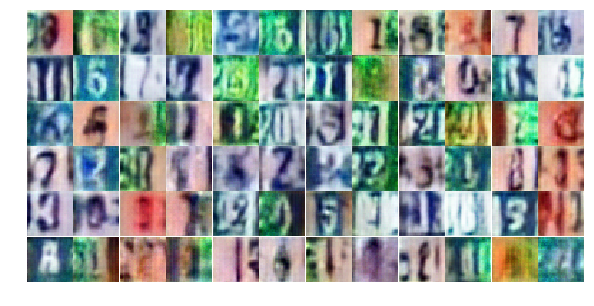

Epoch 8/25... Discriminator Loss: 0.5186... Generator Loss: 1.6966
Epoch 8/25... Discriminator Loss: 1.1024... Generator Loss: 0.6330
Epoch 8/25... Discriminator Loss: 0.6625... Generator Loss: 1.0710
Epoch 8/25... Discriminator Loss: 0.6506... Generator Loss: 1.0998
Epoch 8/25... Discriminator Loss: 1.2098... Generator Loss: 2.3631
Epoch 8/25... Discriminator Loss: 0.8017... Generator Loss: 0.8561
Epoch 8/25... Discriminator Loss: 0.4189... Generator Loss: 1.6030
Epoch 8/25... Discriminator Loss: 0.6094... Generator Loss: 1.1493
Epoch 8/25... Discriminator Loss: 0.5456... Generator Loss: 1.7065
Epoch 8/25... Discriminator Loss: 0.6914... Generator Loss: 1.2526


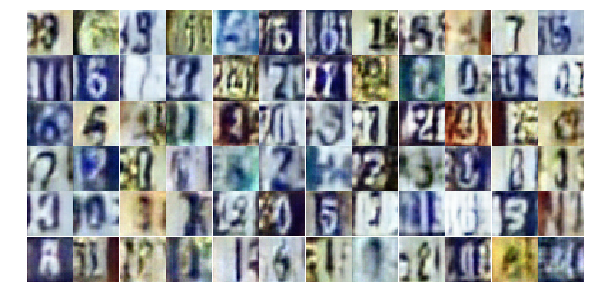

Epoch 8/25... Discriminator Loss: 0.5810... Generator Loss: 1.2364
Epoch 8/25... Discriminator Loss: 0.6668... Generator Loss: 0.9490
Epoch 8/25... Discriminator Loss: 0.3919... Generator Loss: 1.9367
Epoch 8/25... Discriminator Loss: 0.7459... Generator Loss: 0.9056
Epoch 8/25... Discriminator Loss: 0.6681... Generator Loss: 2.7716
Epoch 8/25... Discriminator Loss: 0.8940... Generator Loss: 0.7852
Epoch 8/25... Discriminator Loss: 0.5623... Generator Loss: 1.1265
Epoch 8/25... Discriminator Loss: 0.7648... Generator Loss: 2.7707
Epoch 9/25... Discriminator Loss: 1.3701... Generator Loss: 0.4200
Epoch 9/25... Discriminator Loss: 0.9365... Generator Loss: 0.6956


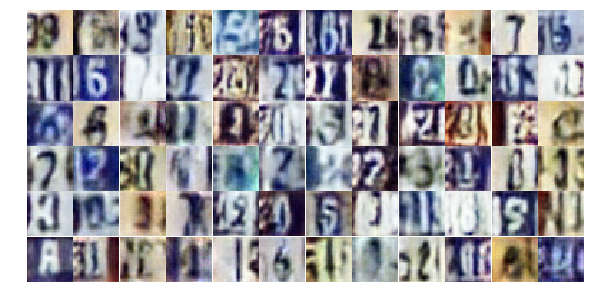

Epoch 9/25... Discriminator Loss: 0.9408... Generator Loss: 0.6830
Epoch 9/25... Discriminator Loss: 0.6225... Generator Loss: 1.2219
Epoch 9/25... Discriminator Loss: 0.6643... Generator Loss: 1.1157
Epoch 9/25... Discriminator Loss: 0.8899... Generator Loss: 0.8815
Epoch 9/25... Discriminator Loss: 1.3533... Generator Loss: 0.4487
Epoch 9/25... Discriminator Loss: 0.6417... Generator Loss: 2.2593
Epoch 9/25... Discriminator Loss: 0.5873... Generator Loss: 1.1856
Epoch 9/25... Discriminator Loss: 0.4481... Generator Loss: 1.4432
Epoch 9/25... Discriminator Loss: 0.6309... Generator Loss: 1.2358
Epoch 9/25... Discriminator Loss: 0.6906... Generator Loss: 1.2958


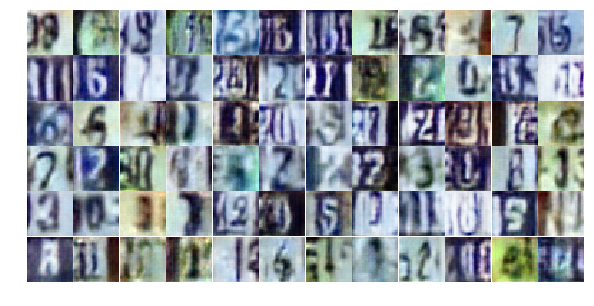

Epoch 9/25... Discriminator Loss: 1.0828... Generator Loss: 0.5921
Epoch 9/25... Discriminator Loss: 1.2898... Generator Loss: 1.7083
Epoch 9/25... Discriminator Loss: 0.6921... Generator Loss: 1.2950
Epoch 9/25... Discriminator Loss: 0.5377... Generator Loss: 1.3025
Epoch 9/25... Discriminator Loss: 0.4821... Generator Loss: 1.4591
Epoch 9/25... Discriminator Loss: 0.7379... Generator Loss: 0.9277
Epoch 9/25... Discriminator Loss: 0.9727... Generator Loss: 0.6715
Epoch 9/25... Discriminator Loss: 0.6622... Generator Loss: 1.3005
Epoch 9/25... Discriminator Loss: 1.2334... Generator Loss: 0.5079
Epoch 9/25... Discriminator Loss: 1.0421... Generator Loss: 0.5985


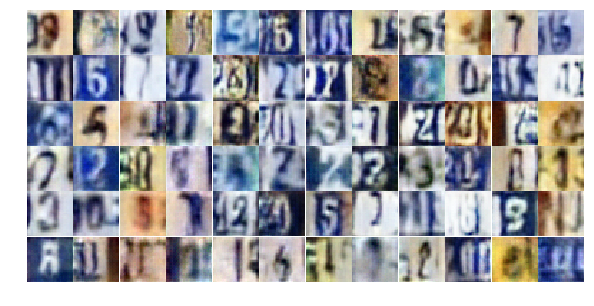

Epoch 9/25... Discriminator Loss: 0.8515... Generator Loss: 0.9571
Epoch 9/25... Discriminator Loss: 0.4821... Generator Loss: 1.8487
Epoch 9/25... Discriminator Loss: 0.4753... Generator Loss: 1.5679
Epoch 9/25... Discriminator Loss: 0.6640... Generator Loss: 1.4608
Epoch 9/25... Discriminator Loss: 0.5091... Generator Loss: 1.6550
Epoch 9/25... Discriminator Loss: 0.6077... Generator Loss: 2.0022
Epoch 9/25... Discriminator Loss: 1.3206... Generator Loss: 0.4639
Epoch 9/25... Discriminator Loss: 0.5747... Generator Loss: 1.2807
Epoch 9/25... Discriminator Loss: 0.5571... Generator Loss: 1.2931
Epoch 9/25... Discriminator Loss: 0.4260... Generator Loss: 1.5938


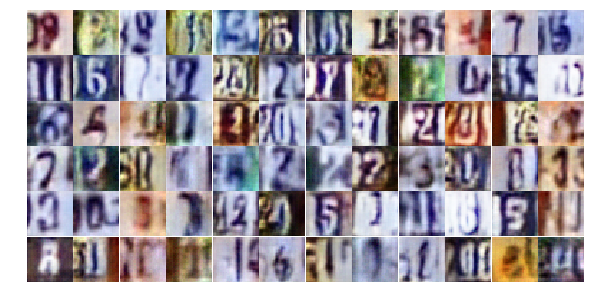

Epoch 9/25... Discriminator Loss: 0.7150... Generator Loss: 1.0515
Epoch 9/25... Discriminator Loss: 0.9401... Generator Loss: 0.6858
Epoch 9/25... Discriminator Loss: 1.2824... Generator Loss: 0.4577
Epoch 9/25... Discriminator Loss: 0.5907... Generator Loss: 1.1402
Epoch 9/25... Discriminator Loss: 0.6662... Generator Loss: 1.0517
Epoch 9/25... Discriminator Loss: 0.5548... Generator Loss: 1.6893
Epoch 9/25... Discriminator Loss: 0.6561... Generator Loss: 1.5417
Epoch 9/25... Discriminator Loss: 0.5354... Generator Loss: 1.2504
Epoch 9/25... Discriminator Loss: 1.1138... Generator Loss: 0.6917
Epoch 9/25... Discriminator Loss: 0.7979... Generator Loss: 0.8420


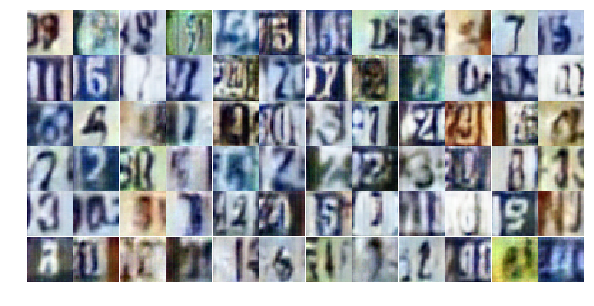

Epoch 9/25... Discriminator Loss: 0.4935... Generator Loss: 1.9057
Epoch 9/25... Discriminator Loss: 0.5912... Generator Loss: 1.4438
Epoch 9/25... Discriminator Loss: 0.4342... Generator Loss: 2.1691
Epoch 9/25... Discriminator Loss: 0.5776... Generator Loss: 1.2814
Epoch 9/25... Discriminator Loss: 2.0117... Generator Loss: 4.3549
Epoch 9/25... Discriminator Loss: 1.1983... Generator Loss: 0.4493
Epoch 9/25... Discriminator Loss: 0.8316... Generator Loss: 0.9336
Epoch 9/25... Discriminator Loss: 0.7513... Generator Loss: 0.8581
Epoch 9/25... Discriminator Loss: 0.8452... Generator Loss: 0.7527
Epoch 9/25... Discriminator Loss: 0.6236... Generator Loss: 3.0431


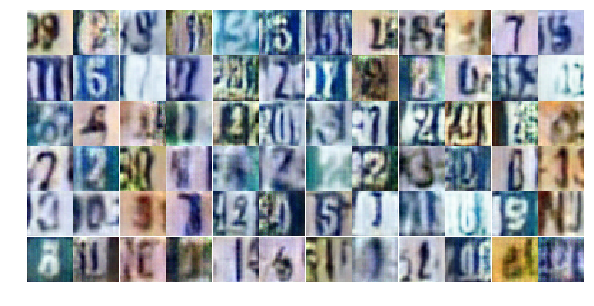

Epoch 9/25... Discriminator Loss: 0.8352... Generator Loss: 1.0706
Epoch 9/25... Discriminator Loss: 1.2385... Generator Loss: 2.6981
Epoch 9/25... Discriminator Loss: 0.6110... Generator Loss: 1.3141
Epoch 9/25... Discriminator Loss: 1.1156... Generator Loss: 0.5432
Epoch 9/25... Discriminator Loss: 0.6802... Generator Loss: 0.9951
Epoch 10/25... Discriminator Loss: 0.4564... Generator Loss: 2.2052
Epoch 10/25... Discriminator Loss: 0.5797... Generator Loss: 1.2461
Epoch 10/25... Discriminator Loss: 0.7532... Generator Loss: 0.8844
Epoch 10/25... Discriminator Loss: 0.5257... Generator Loss: 1.2737
Epoch 10/25... Discriminator Loss: 1.1946... Generator Loss: 0.4944


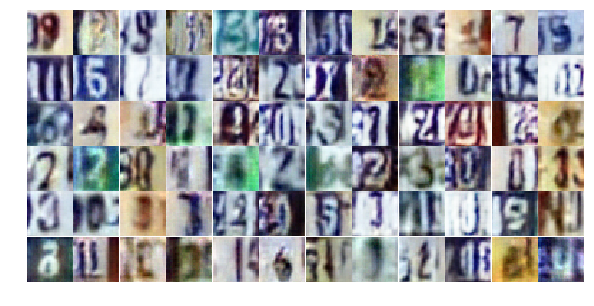

Epoch 10/25... Discriminator Loss: 1.0054... Generator Loss: 0.6213
Epoch 10/25... Discriminator Loss: 0.6126... Generator Loss: 3.0026
Epoch 10/25... Discriminator Loss: 0.7779... Generator Loss: 0.9926
Epoch 10/25... Discriminator Loss: 0.6614... Generator Loss: 1.2641
Epoch 10/25... Discriminator Loss: 0.4867... Generator Loss: 2.1104
Epoch 10/25... Discriminator Loss: 0.7981... Generator Loss: 0.8331
Epoch 10/25... Discriminator Loss: 0.6214... Generator Loss: 1.1716
Epoch 10/25... Discriminator Loss: 1.1276... Generator Loss: 0.5885
Epoch 10/25... Discriminator Loss: 1.2053... Generator Loss: 0.5373
Epoch 10/25... Discriminator Loss: 1.0644... Generator Loss: 0.7007


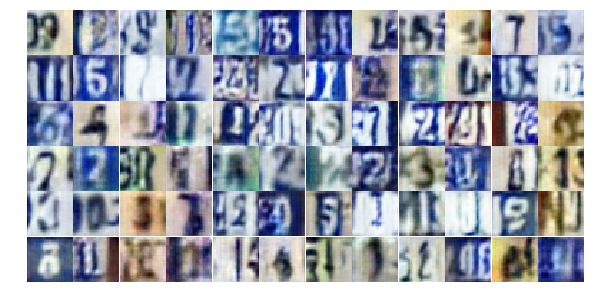

Epoch 10/25... Discriminator Loss: 0.5883... Generator Loss: 1.8505
Epoch 10/25... Discriminator Loss: 0.7169... Generator Loss: 1.0457
Epoch 10/25... Discriminator Loss: 0.8354... Generator Loss: 0.7979
Epoch 10/25... Discriminator Loss: 1.0123... Generator Loss: 0.6641
Epoch 10/25... Discriminator Loss: 0.7131... Generator Loss: 1.0243
Epoch 10/25... Discriminator Loss: 0.7168... Generator Loss: 0.9940
Epoch 10/25... Discriminator Loss: 0.8476... Generator Loss: 0.7964
Epoch 10/25... Discriminator Loss: 0.5170... Generator Loss: 1.3430
Epoch 10/25... Discriminator Loss: 0.5867... Generator Loss: 1.1846
Epoch 10/25... Discriminator Loss: 0.3690... Generator Loss: 1.8899


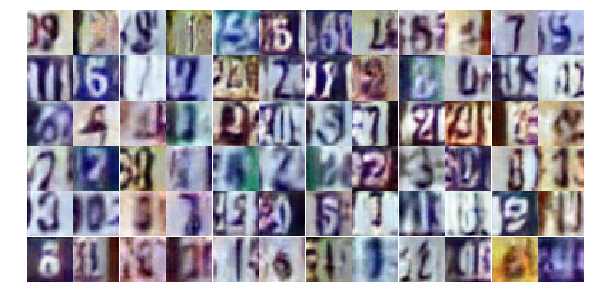

Epoch 10/25... Discriminator Loss: 0.9234... Generator Loss: 0.6623
Epoch 10/25... Discriminator Loss: 0.6584... Generator Loss: 1.0674
Epoch 10/25... Discriminator Loss: 0.3928... Generator Loss: 1.7713
Epoch 10/25... Discriminator Loss: 0.7659... Generator Loss: 2.1106
Epoch 10/25... Discriminator Loss: 1.6419... Generator Loss: 0.2731
Epoch 10/25... Discriminator Loss: 0.8317... Generator Loss: 0.9210
Epoch 10/25... Discriminator Loss: 0.4722... Generator Loss: 1.3709
Epoch 10/25... Discriminator Loss: 0.8870... Generator Loss: 0.7832
Epoch 10/25... Discriminator Loss: 0.7979... Generator Loss: 0.8432
Epoch 10/25... Discriminator Loss: 0.9635... Generator Loss: 0.6667


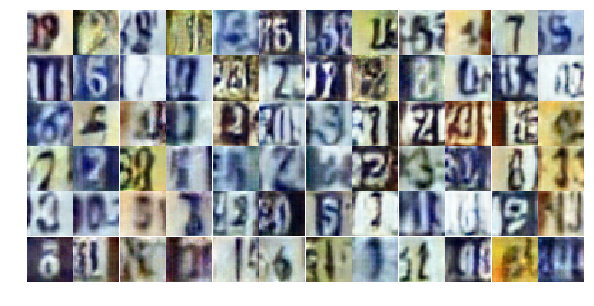

Epoch 10/25... Discriminator Loss: 0.5747... Generator Loss: 1.3279
Epoch 10/25... Discriminator Loss: 0.7015... Generator Loss: 1.0754
Epoch 10/25... Discriminator Loss: 0.7794... Generator Loss: 0.8559
Epoch 10/25... Discriminator Loss: 0.6325... Generator Loss: 1.9245
Epoch 10/25... Discriminator Loss: 0.8860... Generator Loss: 0.7248
Epoch 10/25... Discriminator Loss: 0.7663... Generator Loss: 0.9117
Epoch 10/25... Discriminator Loss: 0.7428... Generator Loss: 0.9572
Epoch 10/25... Discriminator Loss: 0.9983... Generator Loss: 0.6926
Epoch 10/25... Discriminator Loss: 0.6609... Generator Loss: 1.1199
Epoch 10/25... Discriminator Loss: 0.8417... Generator Loss: 2.4475


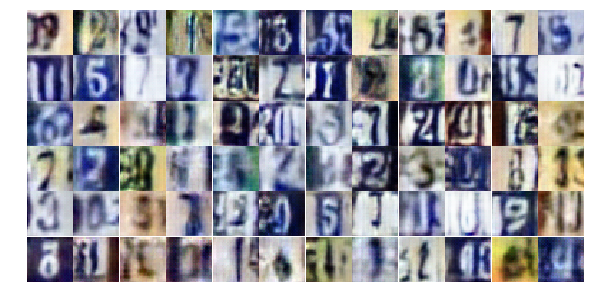

Epoch 10/25... Discriminator Loss: 1.3001... Generator Loss: 0.4442
Epoch 10/25... Discriminator Loss: 0.7467... Generator Loss: 0.9744
Epoch 10/25... Discriminator Loss: 0.6265... Generator Loss: 1.0886
Epoch 10/25... Discriminator Loss: 0.9985... Generator Loss: 0.6289
Epoch 10/25... Discriminator Loss: 0.5521... Generator Loss: 2.0185
Epoch 10/25... Discriminator Loss: 0.7212... Generator Loss: 1.0723
Epoch 10/25... Discriminator Loss: 0.6476... Generator Loss: 1.1570
Epoch 10/25... Discriminator Loss: 0.6117... Generator Loss: 1.1252
Epoch 10/25... Discriminator Loss: 0.7679... Generator Loss: 2.0612
Epoch 10/25... Discriminator Loss: 0.6716... Generator Loss: 1.1345


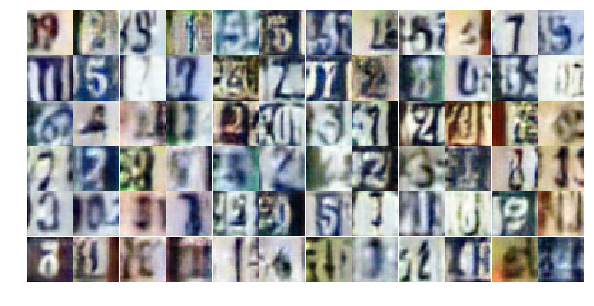

Epoch 10/25... Discriminator Loss: 0.7788... Generator Loss: 1.5234
Epoch 10/25... Discriminator Loss: 0.7996... Generator Loss: 0.7952
Epoch 10/25... Discriminator Loss: 0.3569... Generator Loss: 1.8976
Epoch 11/25... Discriminator Loss: 0.8977... Generator Loss: 0.8707
Epoch 11/25... Discriminator Loss: 0.7683... Generator Loss: 0.9170
Epoch 11/25... Discriminator Loss: 1.0605... Generator Loss: 0.5682
Epoch 11/25... Discriminator Loss: 0.9603... Generator Loss: 0.6500
Epoch 11/25... Discriminator Loss: 0.7192... Generator Loss: 1.4102
Epoch 11/25... Discriminator Loss: 1.4069... Generator Loss: 0.4484
Epoch 11/25... Discriminator Loss: 0.3923... Generator Loss: 1.7624


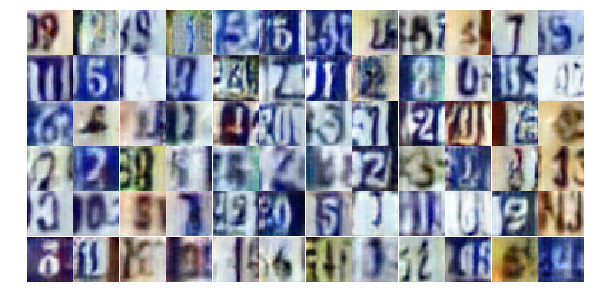

Epoch 11/25... Discriminator Loss: 0.3932... Generator Loss: 2.5470
Epoch 11/25... Discriminator Loss: 0.7580... Generator Loss: 1.0336
Epoch 11/25... Discriminator Loss: 0.5148... Generator Loss: 1.2777
Epoch 11/25... Discriminator Loss: 1.0696... Generator Loss: 0.5724
Epoch 11/25... Discriminator Loss: 0.9415... Generator Loss: 0.7794
Epoch 11/25... Discriminator Loss: 0.5376... Generator Loss: 1.9750
Epoch 11/25... Discriminator Loss: 1.0053... Generator Loss: 0.9647
Epoch 11/25... Discriminator Loss: 0.4188... Generator Loss: 2.3125
Epoch 11/25... Discriminator Loss: 0.6943... Generator Loss: 0.9441
Epoch 11/25... Discriminator Loss: 1.0030... Generator Loss: 0.7182


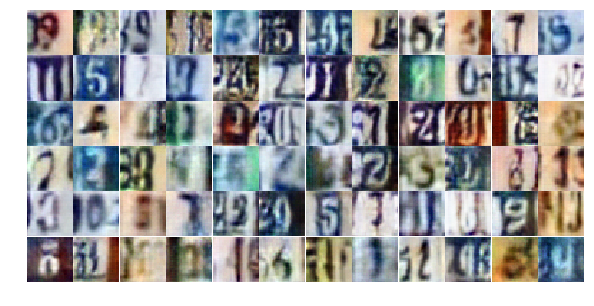

Epoch 11/25... Discriminator Loss: 0.9423... Generator Loss: 0.7237
Epoch 11/25... Discriminator Loss: 0.6505... Generator Loss: 1.3417
Epoch 11/25... Discriminator Loss: 0.8342... Generator Loss: 0.7779
Epoch 11/25... Discriminator Loss: 0.7126... Generator Loss: 0.9580
Epoch 11/25... Discriminator Loss: 0.3934... Generator Loss: 1.8398
Epoch 11/25... Discriminator Loss: 0.3739... Generator Loss: 1.9714
Epoch 11/25... Discriminator Loss: 0.5061... Generator Loss: 1.4311
Epoch 11/25... Discriminator Loss: 1.0014... Generator Loss: 0.6500
Epoch 11/25... Discriminator Loss: 0.4311... Generator Loss: 1.5343
Epoch 11/25... Discriminator Loss: 1.4627... Generator Loss: 0.3857


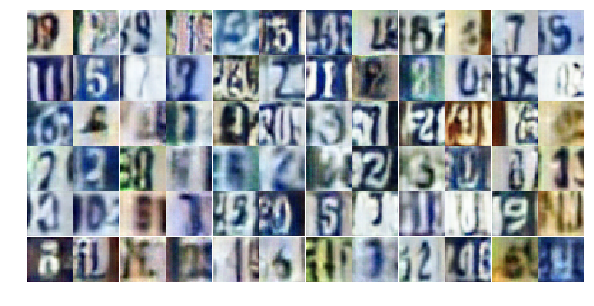

Epoch 11/25... Discriminator Loss: 0.8851... Generator Loss: 0.8854
Epoch 11/25... Discriminator Loss: 0.5902... Generator Loss: 1.5062
Epoch 11/25... Discriminator Loss: 0.7546... Generator Loss: 1.0969
Epoch 11/25... Discriminator Loss: 0.6124... Generator Loss: 1.1069
Epoch 11/25... Discriminator Loss: 1.0750... Generator Loss: 0.5559
Epoch 11/25... Discriminator Loss: 0.8047... Generator Loss: 0.8652
Epoch 11/25... Discriminator Loss: 1.0956... Generator Loss: 0.6660
Epoch 11/25... Discriminator Loss: 1.1200... Generator Loss: 0.5566
Epoch 11/25... Discriminator Loss: 0.5833... Generator Loss: 1.2382
Epoch 11/25... Discriminator Loss: 1.4004... Generator Loss: 0.3841


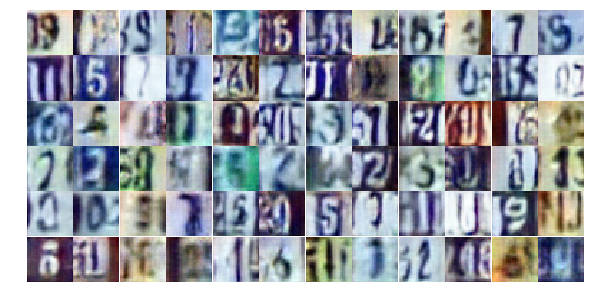

Epoch 11/25... Discriminator Loss: 0.5090... Generator Loss: 1.4581
Epoch 11/25... Discriminator Loss: 0.5072... Generator Loss: 1.4516
Epoch 11/25... Discriminator Loss: 0.8072... Generator Loss: 0.8498
Epoch 11/25... Discriminator Loss: 0.9442... Generator Loss: 2.5388
Epoch 11/25... Discriminator Loss: 0.8301... Generator Loss: 0.8524
Epoch 11/25... Discriminator Loss: 0.5793... Generator Loss: 1.2595
Epoch 11/25... Discriminator Loss: 0.2504... Generator Loss: 2.5419
Epoch 11/25... Discriminator Loss: 0.6023... Generator Loss: 1.3629
Epoch 11/25... Discriminator Loss: 1.3195... Generator Loss: 0.4179
Epoch 11/25... Discriminator Loss: 0.6955... Generator Loss: 0.9319


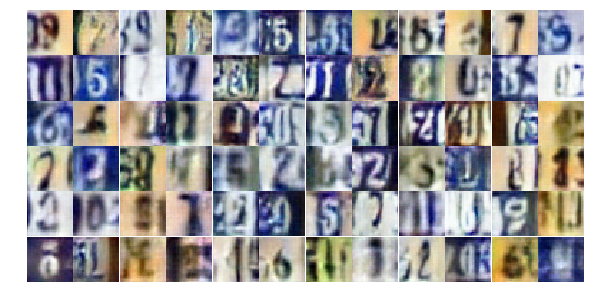

Epoch 11/25... Discriminator Loss: 0.7823... Generator Loss: 0.8785
Epoch 11/25... Discriminator Loss: 0.5130... Generator Loss: 1.5730
Epoch 11/25... Discriminator Loss: 1.0949... Generator Loss: 0.5921
Epoch 11/25... Discriminator Loss: 1.0662... Generator Loss: 0.6073
Epoch 11/25... Discriminator Loss: 1.6623... Generator Loss: 0.3523
Epoch 11/25... Discriminator Loss: 1.2456... Generator Loss: 0.5402
Epoch 11/25... Discriminator Loss: 1.0953... Generator Loss: 0.5640
Epoch 11/25... Discriminator Loss: 0.5672... Generator Loss: 1.7561
Epoch 11/25... Discriminator Loss: 0.9788... Generator Loss: 0.6525
Epoch 11/25... Discriminator Loss: 0.9221... Generator Loss: 0.7341


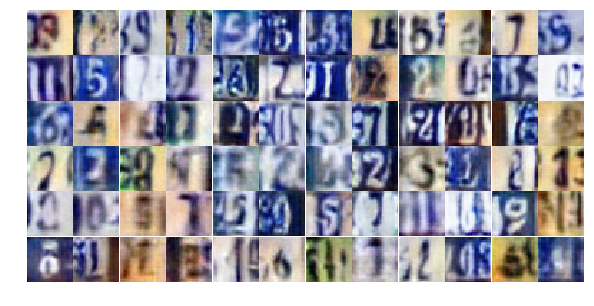

Epoch 12/25... Discriminator Loss: 0.8334... Generator Loss: 1.1362
Epoch 12/25... Discriminator Loss: 0.6653... Generator Loss: 1.6133
Epoch 12/25... Discriminator Loss: 1.1892... Generator Loss: 0.4898
Epoch 12/25... Discriminator Loss: 0.6893... Generator Loss: 1.1154
Epoch 12/25... Discriminator Loss: 0.3442... Generator Loss: 1.9828
Epoch 12/25... Discriminator Loss: 1.1634... Generator Loss: 0.5372
Epoch 12/25... Discriminator Loss: 0.6914... Generator Loss: 1.1603
Epoch 12/25... Discriminator Loss: 0.8926... Generator Loss: 1.1563
Epoch 12/25... Discriminator Loss: 0.6365... Generator Loss: 1.2113
Epoch 12/25... Discriminator Loss: 1.3418... Generator Loss: 0.4415


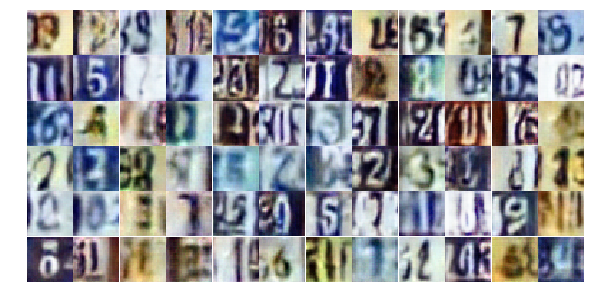

Epoch 12/25... Discriminator Loss: 0.5154... Generator Loss: 1.2780
Epoch 12/25... Discriminator Loss: 0.8432... Generator Loss: 1.5069
Epoch 12/25... Discriminator Loss: 0.6180... Generator Loss: 1.1052
Epoch 12/25... Discriminator Loss: 0.6263... Generator Loss: 1.5876
Epoch 12/25... Discriminator Loss: 0.4721... Generator Loss: 1.6145
Epoch 12/25... Discriminator Loss: 1.1952... Generator Loss: 0.5019
Epoch 12/25... Discriminator Loss: 1.7300... Generator Loss: 0.2640
Epoch 12/25... Discriminator Loss: 0.5818... Generator Loss: 2.0386
Epoch 12/25... Discriminator Loss: 0.3584... Generator Loss: 1.8943
Epoch 12/25... Discriminator Loss: 1.1470... Generator Loss: 0.5566


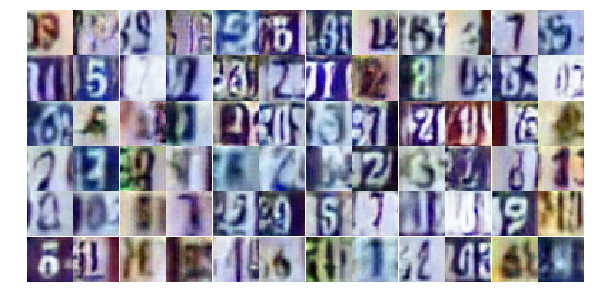

Epoch 12/25... Discriminator Loss: 0.4156... Generator Loss: 2.0661
Epoch 12/25... Discriminator Loss: 0.5481... Generator Loss: 1.3490
Epoch 12/25... Discriminator Loss: 0.7803... Generator Loss: 0.8648
Epoch 12/25... Discriminator Loss: 0.5264... Generator Loss: 1.4363
Epoch 12/25... Discriminator Loss: 0.3758... Generator Loss: 1.7070
Epoch 12/25... Discriminator Loss: 0.5420... Generator Loss: 1.3532
Epoch 12/25... Discriminator Loss: 0.4116... Generator Loss: 1.6348
Epoch 12/25... Discriminator Loss: 0.3986... Generator Loss: 1.6417
Epoch 12/25... Discriminator Loss: 0.5402... Generator Loss: 1.3030
Epoch 12/25... Discriminator Loss: 0.5330... Generator Loss: 1.7613


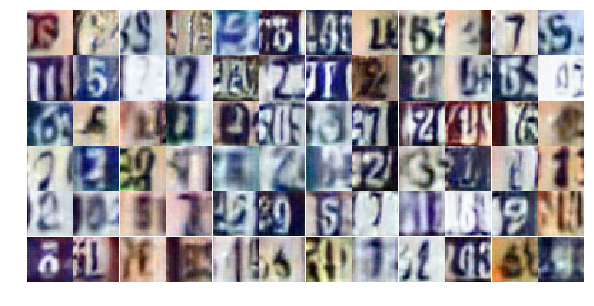

Epoch 12/25... Discriminator Loss: 0.5594... Generator Loss: 1.3108
Epoch 12/25... Discriminator Loss: 0.9552... Generator Loss: 0.6466
Epoch 12/25... Discriminator Loss: 0.6191... Generator Loss: 1.2602
Epoch 12/25... Discriminator Loss: 1.3545... Generator Loss: 0.4622
Epoch 12/25... Discriminator Loss: 0.6069... Generator Loss: 1.6102
Epoch 12/25... Discriminator Loss: 0.6494... Generator Loss: 1.0065
Epoch 12/25... Discriminator Loss: 1.0341... Generator Loss: 0.5719
Epoch 12/25... Discriminator Loss: 0.7009... Generator Loss: 1.4210
Epoch 12/25... Discriminator Loss: 0.6450... Generator Loss: 1.0795
Epoch 12/25... Discriminator Loss: 0.3418... Generator Loss: 2.0138


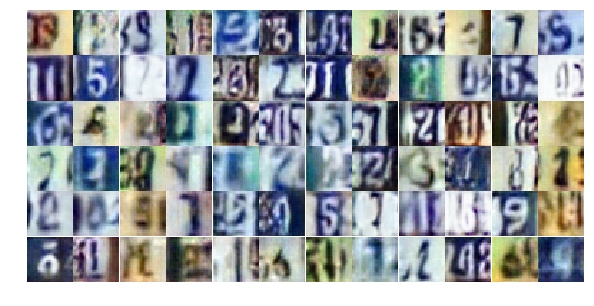

Epoch 12/25... Discriminator Loss: 0.4599... Generator Loss: 1.6583
Epoch 12/25... Discriminator Loss: 0.3881... Generator Loss: 1.6774
Epoch 12/25... Discriminator Loss: 0.3798... Generator Loss: 1.6274
Epoch 12/25... Discriminator Loss: 1.1455... Generator Loss: 0.5627
Epoch 12/25... Discriminator Loss: 0.7776... Generator Loss: 0.8565
Epoch 12/25... Discriminator Loss: 2.0475... Generator Loss: 0.2369
Epoch 12/25... Discriminator Loss: 0.9356... Generator Loss: 0.7791
Epoch 12/25... Discriminator Loss: 1.0728... Generator Loss: 0.6923
Epoch 12/25... Discriminator Loss: 0.4349... Generator Loss: 1.9342
Epoch 12/25... Discriminator Loss: 1.2512... Generator Loss: 0.4636


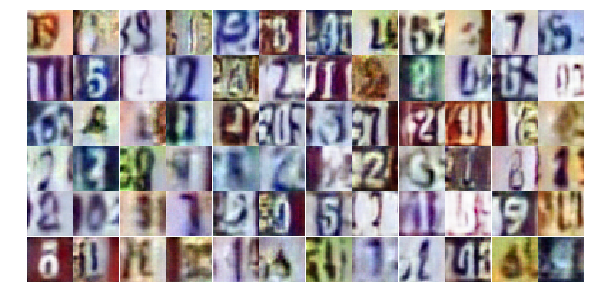

Epoch 12/25... Discriminator Loss: 1.0507... Generator Loss: 0.6003
Epoch 12/25... Discriminator Loss: 1.0631... Generator Loss: 0.6258
Epoch 12/25... Discriminator Loss: 0.6995... Generator Loss: 1.0795
Epoch 12/25... Discriminator Loss: 0.7877... Generator Loss: 0.9211
Epoch 12/25... Discriminator Loss: 0.5522... Generator Loss: 1.2705
Epoch 12/25... Discriminator Loss: 0.6715... Generator Loss: 2.1206
Epoch 12/25... Discriminator Loss: 1.0017... Generator Loss: 0.6298
Epoch 13/25... Discriminator Loss: 0.5047... Generator Loss: 1.2630
Epoch 13/25... Discriminator Loss: 0.5532... Generator Loss: 1.1927
Epoch 13/25... Discriminator Loss: 0.9806... Generator Loss: 0.6912


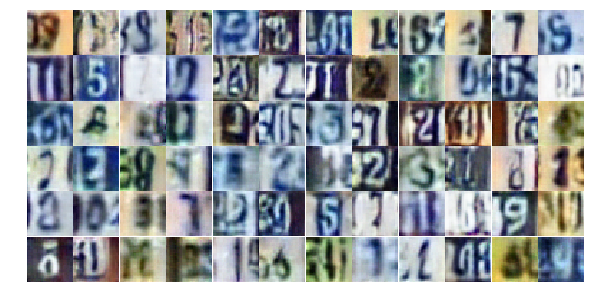

Epoch 13/25... Discriminator Loss: 0.5436... Generator Loss: 1.7509
Epoch 13/25... Discriminator Loss: 0.4127... Generator Loss: 1.8977
Epoch 13/25... Discriminator Loss: 0.9804... Generator Loss: 0.8068
Epoch 13/25... Discriminator Loss: 1.0468... Generator Loss: 0.6575
Epoch 13/25... Discriminator Loss: 0.8506... Generator Loss: 0.8256
Epoch 13/25... Discriminator Loss: 0.5729... Generator Loss: 1.3270
Epoch 13/25... Discriminator Loss: 0.3969... Generator Loss: 2.0479
Epoch 13/25... Discriminator Loss: 0.8277... Generator Loss: 0.7683
Epoch 13/25... Discriminator Loss: 0.5473... Generator Loss: 1.9629
Epoch 13/25... Discriminator Loss: 0.7125... Generator Loss: 0.9625


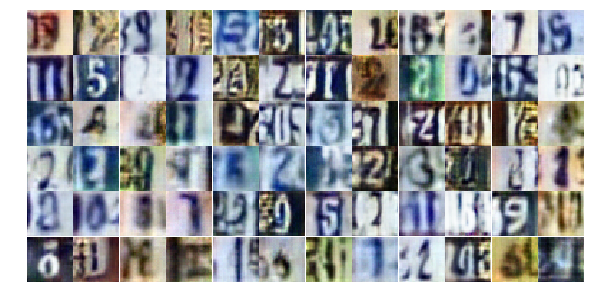

Epoch 13/25... Discriminator Loss: 0.8167... Generator Loss: 0.7867
Epoch 13/25... Discriminator Loss: 0.5597... Generator Loss: 1.1165
Epoch 13/25... Discriminator Loss: 1.1627... Generator Loss: 0.6018
Epoch 13/25... Discriminator Loss: 0.6692... Generator Loss: 1.0658
Epoch 13/25... Discriminator Loss: 0.6589... Generator Loss: 1.1499
Epoch 13/25... Discriminator Loss: 0.7197... Generator Loss: 1.0690
Epoch 13/25... Discriminator Loss: 0.5183... Generator Loss: 1.5364
Epoch 13/25... Discriminator Loss: 1.1191... Generator Loss: 0.5478
Epoch 13/25... Discriminator Loss: 0.6878... Generator Loss: 0.9811
Epoch 13/25... Discriminator Loss: 0.9518... Generator Loss: 0.6788


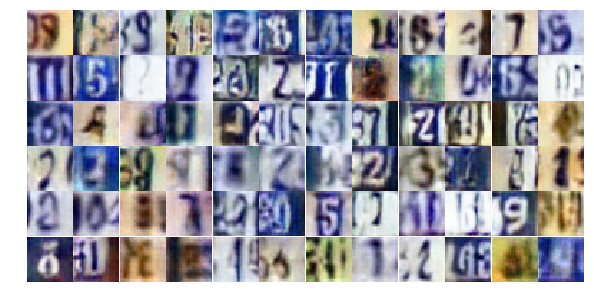

Epoch 13/25... Discriminator Loss: 0.7253... Generator Loss: 0.9330
Epoch 13/25... Discriminator Loss: 0.6115... Generator Loss: 1.4924
Epoch 13/25... Discriminator Loss: 0.9639... Generator Loss: 2.7951
Epoch 13/25... Discriminator Loss: 0.6996... Generator Loss: 1.4287
Epoch 13/25... Discriminator Loss: 0.6643... Generator Loss: 1.0082
Epoch 13/25... Discriminator Loss: 0.7272... Generator Loss: 0.9680
Epoch 13/25... Discriminator Loss: 1.2997... Generator Loss: 2.5771
Epoch 13/25... Discriminator Loss: 0.6121... Generator Loss: 1.6629
Epoch 13/25... Discriminator Loss: 0.7955... Generator Loss: 0.9342
Epoch 13/25... Discriminator Loss: 0.4949... Generator Loss: 1.3979


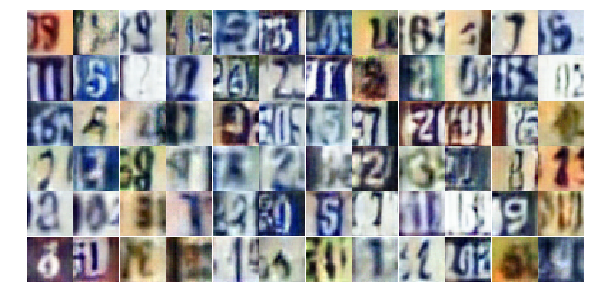

Epoch 13/25... Discriminator Loss: 1.3084... Generator Loss: 0.4385
Epoch 13/25... Discriminator Loss: 0.8219... Generator Loss: 0.9195
Epoch 13/25... Discriminator Loss: 0.8398... Generator Loss: 0.9072
Epoch 13/25... Discriminator Loss: 1.2653... Generator Loss: 0.4752
Epoch 13/25... Discriminator Loss: 0.5505... Generator Loss: 1.2886
Epoch 13/25... Discriminator Loss: 0.5090... Generator Loss: 1.8227
Epoch 13/25... Discriminator Loss: 0.3662... Generator Loss: 1.8362
Epoch 13/25... Discriminator Loss: 0.8249... Generator Loss: 0.8610
Epoch 13/25... Discriminator Loss: 1.0107... Generator Loss: 2.9654
Epoch 13/25... Discriminator Loss: 0.6628... Generator Loss: 1.1020


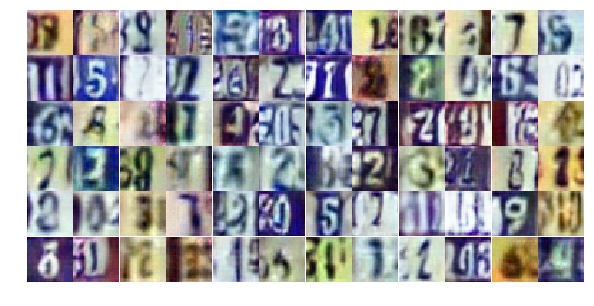

Epoch 13/25... Discriminator Loss: 0.6006... Generator Loss: 1.3411
Epoch 13/25... Discriminator Loss: 2.1923... Generator Loss: 0.2504
Epoch 13/25... Discriminator Loss: 1.2748... Generator Loss: 0.5643
Epoch 13/25... Discriminator Loss: 0.7551... Generator Loss: 1.0405
Epoch 13/25... Discriminator Loss: 1.0497... Generator Loss: 0.5823
Epoch 13/25... Discriminator Loss: 0.7303... Generator Loss: 1.0551
Epoch 13/25... Discriminator Loss: 0.6855... Generator Loss: 1.0955
Epoch 13/25... Discriminator Loss: 0.6572... Generator Loss: 1.1946
Epoch 13/25... Discriminator Loss: 1.1515... Generator Loss: 0.5482
Epoch 13/25... Discriminator Loss: 0.6969... Generator Loss: 1.1763


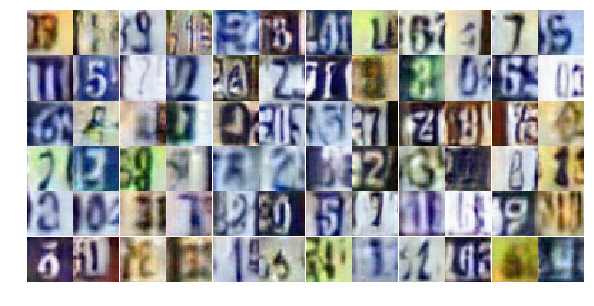

Epoch 13/25... Discriminator Loss: 0.3283... Generator Loss: 2.1587
Epoch 13/25... Discriminator Loss: 1.3206... Generator Loss: 0.4645
Epoch 13/25... Discriminator Loss: 0.7961... Generator Loss: 0.9648
Epoch 13/25... Discriminator Loss: 1.4147... Generator Loss: 0.3959
Epoch 14/25... Discriminator Loss: 0.8860... Generator Loss: 0.7764
Epoch 14/25... Discriminator Loss: 0.6221... Generator Loss: 1.7863
Epoch 14/25... Discriminator Loss: 0.9159... Generator Loss: 0.8169
Epoch 14/25... Discriminator Loss: 0.5091... Generator Loss: 1.7802
Epoch 14/25... Discriminator Loss: 0.7135... Generator Loss: 2.3593
Epoch 14/25... Discriminator Loss: 0.9036... Generator Loss: 0.7484


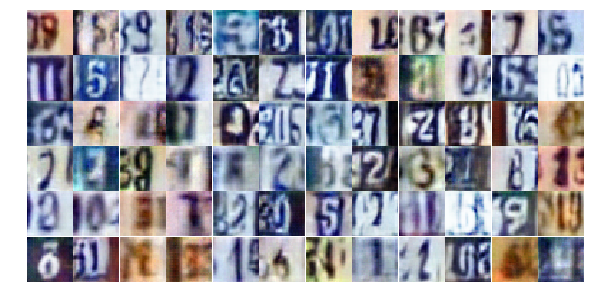

Epoch 14/25... Discriminator Loss: 1.1153... Generator Loss: 2.4405
Epoch 14/25... Discriminator Loss: 0.7890... Generator Loss: 0.8752
Epoch 14/25... Discriminator Loss: 0.5795... Generator Loss: 1.0802
Epoch 14/25... Discriminator Loss: 0.5722... Generator Loss: 2.0831
Epoch 14/25... Discriminator Loss: 0.9903... Generator Loss: 0.6373
Epoch 14/25... Discriminator Loss: 0.4265... Generator Loss: 1.4030
Epoch 14/25... Discriminator Loss: 0.4822... Generator Loss: 1.7809
Epoch 14/25... Discriminator Loss: 1.5373... Generator Loss: 0.3444
Epoch 14/25... Discriminator Loss: 1.4227... Generator Loss: 0.3586
Epoch 14/25... Discriminator Loss: 1.8412... Generator Loss: 0.2893


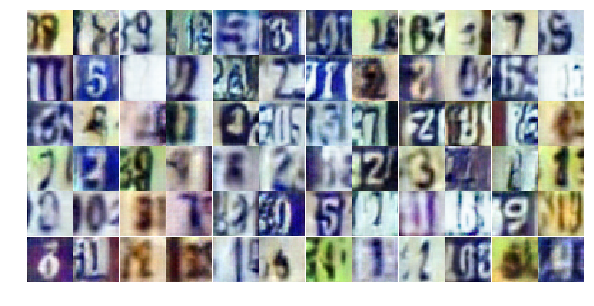

Epoch 14/25... Discriminator Loss: 0.5117... Generator Loss: 1.2721
Epoch 14/25... Discriminator Loss: 0.5518... Generator Loss: 2.3994
Epoch 14/25... Discriminator Loss: 0.9087... Generator Loss: 1.3187
Epoch 14/25... Discriminator Loss: 0.5130... Generator Loss: 1.7198
Epoch 14/25... Discriminator Loss: 1.0617... Generator Loss: 0.6024
Epoch 14/25... Discriminator Loss: 0.6023... Generator Loss: 1.1348
Epoch 14/25... Discriminator Loss: 0.7504... Generator Loss: 0.9374
Epoch 14/25... Discriminator Loss: 1.0997... Generator Loss: 0.5417
Epoch 14/25... Discriminator Loss: 0.6646... Generator Loss: 1.2464
Epoch 14/25... Discriminator Loss: 0.5217... Generator Loss: 1.2471


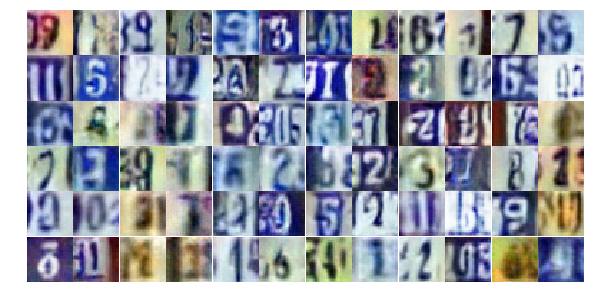

Epoch 14/25... Discriminator Loss: 1.5458... Generator Loss: 0.3658
Epoch 14/25... Discriminator Loss: 0.4822... Generator Loss: 1.7273
Epoch 14/25... Discriminator Loss: 0.4697... Generator Loss: 1.6792
Epoch 14/25... Discriminator Loss: 0.4586... Generator Loss: 1.3879
Epoch 14/25... Discriminator Loss: 0.6412... Generator Loss: 1.1086
Epoch 14/25... Discriminator Loss: 0.8563... Generator Loss: 0.8314
Epoch 14/25... Discriminator Loss: 0.8992... Generator Loss: 0.7927
Epoch 14/25... Discriminator Loss: 0.3642... Generator Loss: 2.2932
Epoch 14/25... Discriminator Loss: 0.5148... Generator Loss: 1.6567
Epoch 14/25... Discriminator Loss: 0.8823... Generator Loss: 0.8848


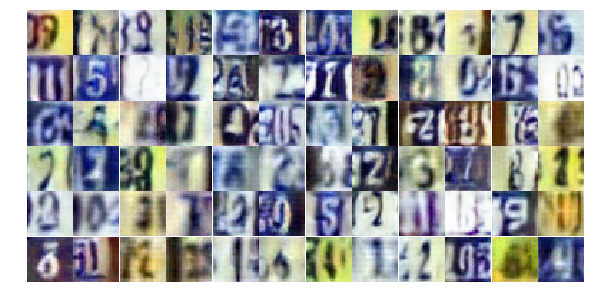

Epoch 14/25... Discriminator Loss: 1.0419... Generator Loss: 0.6289
Epoch 14/25... Discriminator Loss: 0.7038... Generator Loss: 1.3706
Epoch 14/25... Discriminator Loss: 0.9313... Generator Loss: 0.6832
Epoch 14/25... Discriminator Loss: 1.3333... Generator Loss: 0.4072
Epoch 14/25... Discriminator Loss: 0.7658... Generator Loss: 0.9726
Epoch 14/25... Discriminator Loss: 0.7603... Generator Loss: 0.9121
Epoch 14/25... Discriminator Loss: 0.6768... Generator Loss: 1.2747
Epoch 14/25... Discriminator Loss: 0.4844... Generator Loss: 1.4680
Epoch 14/25... Discriminator Loss: 3.4455... Generator Loss: 1.0588
Epoch 14/25... Discriminator Loss: 1.7913... Generator Loss: 0.4866


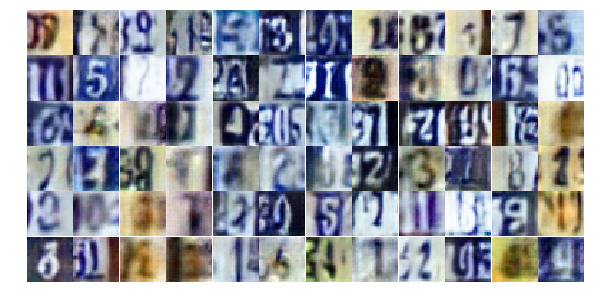

Epoch 14/25... Discriminator Loss: 0.7786... Generator Loss: 1.1109
Epoch 14/25... Discriminator Loss: 0.8621... Generator Loss: 0.7836
Epoch 14/25... Discriminator Loss: 0.6184... Generator Loss: 1.1950
Epoch 14/25... Discriminator Loss: 0.7701... Generator Loss: 0.9284
Epoch 14/25... Discriminator Loss: 0.7054... Generator Loss: 0.9290
Epoch 14/25... Discriminator Loss: 0.8451... Generator Loss: 0.7508
Epoch 14/25... Discriminator Loss: 0.6439... Generator Loss: 2.2325
Epoch 14/25... Discriminator Loss: 0.7283... Generator Loss: 0.9385
Epoch 14/25... Discriminator Loss: 1.0602... Generator Loss: 0.5851
Epoch 14/25... Discriminator Loss: 1.2298... Generator Loss: 0.4981


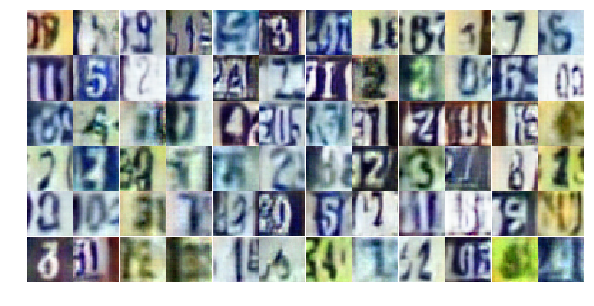

Epoch 14/25... Discriminator Loss: 0.7344... Generator Loss: 0.9929
Epoch 14/25... Discriminator Loss: 0.7525... Generator Loss: 1.2245
Epoch 15/25... Discriminator Loss: 1.1265... Generator Loss: 0.5562
Epoch 15/25... Discriminator Loss: 0.5423... Generator Loss: 1.5743
Epoch 15/25... Discriminator Loss: 0.7470... Generator Loss: 1.0319
Epoch 15/25... Discriminator Loss: 0.7320... Generator Loss: 0.9033
Epoch 15/25... Discriminator Loss: 0.7603... Generator Loss: 1.0707
Epoch 15/25... Discriminator Loss: 0.5781... Generator Loss: 1.2157
Epoch 15/25... Discriminator Loss: 1.6124... Generator Loss: 0.3144
Epoch 15/25... Discriminator Loss: 0.7096... Generator Loss: 1.0191


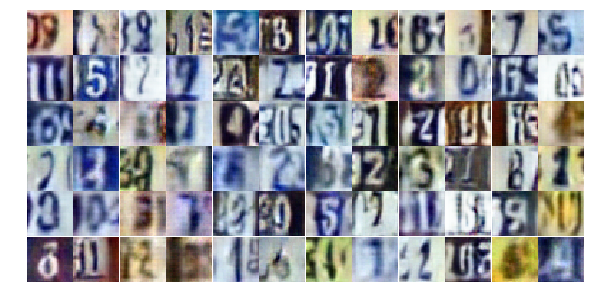

Epoch 15/25... Discriminator Loss: 0.5592... Generator Loss: 1.2520
Epoch 15/25... Discriminator Loss: 0.7223... Generator Loss: 1.0334
Epoch 15/25... Discriminator Loss: 0.9168... Generator Loss: 0.6905
Epoch 15/25... Discriminator Loss: 0.8361... Generator Loss: 0.7867
Epoch 15/25... Discriminator Loss: 0.9785... Generator Loss: 0.7073
Epoch 15/25... Discriminator Loss: 0.5089... Generator Loss: 1.4136
Epoch 15/25... Discriminator Loss: 1.3446... Generator Loss: 0.4529
Epoch 15/25... Discriminator Loss: 0.7573... Generator Loss: 1.3320
Epoch 15/25... Discriminator Loss: 0.8198... Generator Loss: 3.7696
Epoch 15/25... Discriminator Loss: 1.5565... Generator Loss: 0.3804


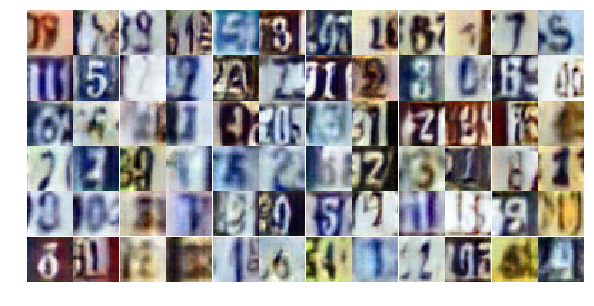

Epoch 15/25... Discriminator Loss: 0.8518... Generator Loss: 1.3159
Epoch 15/25... Discriminator Loss: 0.7298... Generator Loss: 0.9690
Epoch 15/25... Discriminator Loss: 0.5569... Generator Loss: 1.3330
Epoch 15/25... Discriminator Loss: 0.9264... Generator Loss: 0.7101
Epoch 15/25... Discriminator Loss: 1.0771... Generator Loss: 0.6619
Epoch 15/25... Discriminator Loss: 0.7426... Generator Loss: 0.9247
Epoch 15/25... Discriminator Loss: 1.1219... Generator Loss: 0.5949
Epoch 15/25... Discriminator Loss: 0.7771... Generator Loss: 0.8720
Epoch 15/25... Discriminator Loss: 0.5382... Generator Loss: 1.4421
Epoch 15/25... Discriminator Loss: 1.3432... Generator Loss: 0.4464


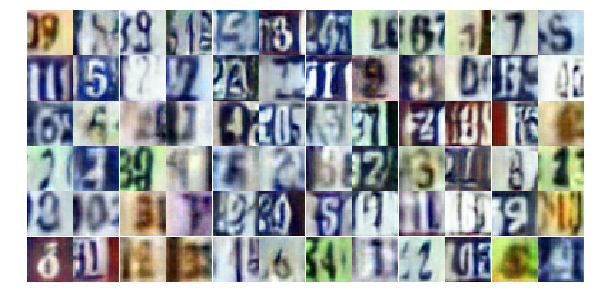

Epoch 15/25... Discriminator Loss: 0.7181... Generator Loss: 0.9374
Epoch 15/25... Discriminator Loss: 1.2020... Generator Loss: 0.5189
Epoch 15/25... Discriminator Loss: 0.4982... Generator Loss: 1.3789
Epoch 15/25... Discriminator Loss: 0.7559... Generator Loss: 0.9635
Epoch 15/25... Discriminator Loss: 0.5997... Generator Loss: 1.2609
Epoch 15/25... Discriminator Loss: 1.6911... Generator Loss: 3.8669
Epoch 15/25... Discriminator Loss: 0.5660... Generator Loss: 1.5073
Epoch 15/25... Discriminator Loss: 0.6216... Generator Loss: 1.2339
Epoch 15/25... Discriminator Loss: 0.5726... Generator Loss: 1.2795
Epoch 15/25... Discriminator Loss: 0.9046... Generator Loss: 0.7776


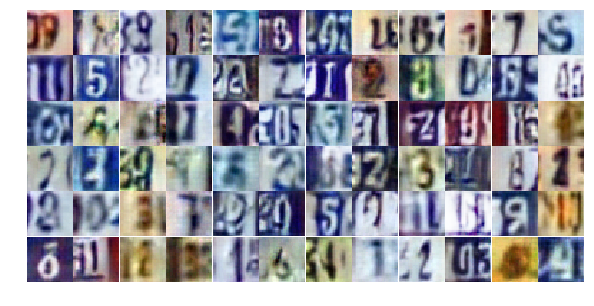

Epoch 15/25... Discriminator Loss: 0.8465... Generator Loss: 0.7881
Epoch 15/25... Discriminator Loss: 1.2767... Generator Loss: 0.5094
Epoch 15/25... Discriminator Loss: 1.0774... Generator Loss: 0.5934
Epoch 15/25... Discriminator Loss: 0.5197... Generator Loss: 1.4399
Epoch 15/25... Discriminator Loss: 0.5038... Generator Loss: 1.3069
Epoch 15/25... Discriminator Loss: 0.8278... Generator Loss: 1.1249
Epoch 15/25... Discriminator Loss: 0.5489... Generator Loss: 1.3264
Epoch 15/25... Discriminator Loss: 0.8244... Generator Loss: 0.8383
Epoch 15/25... Discriminator Loss: 0.5934... Generator Loss: 1.4051
Epoch 15/25... Discriminator Loss: 0.8245... Generator Loss: 0.9623


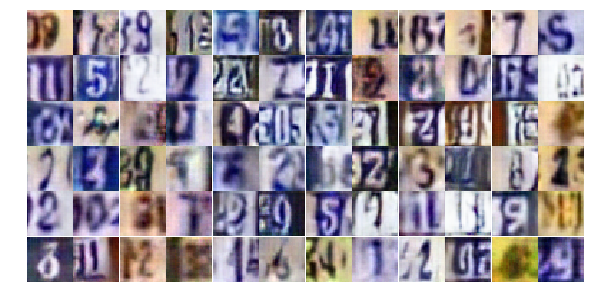

Epoch 15/25... Discriminator Loss: 0.7470... Generator Loss: 0.8925
Epoch 15/25... Discriminator Loss: 0.9868... Generator Loss: 0.6190
Epoch 15/25... Discriminator Loss: 0.5747... Generator Loss: 1.2979
Epoch 15/25... Discriminator Loss: 1.2262... Generator Loss: 0.5822
Epoch 15/25... Discriminator Loss: 0.8365... Generator Loss: 0.8460
Epoch 15/25... Discriminator Loss: 0.7812... Generator Loss: 1.2431
Epoch 15/25... Discriminator Loss: 1.0163... Generator Loss: 0.7126
Epoch 15/25... Discriminator Loss: 1.8277... Generator Loss: 0.2622
Epoch 15/25... Discriminator Loss: 1.1491... Generator Loss: 1.1568
Epoch 16/25... Discriminator Loss: 1.4948... Generator Loss: 0.3965


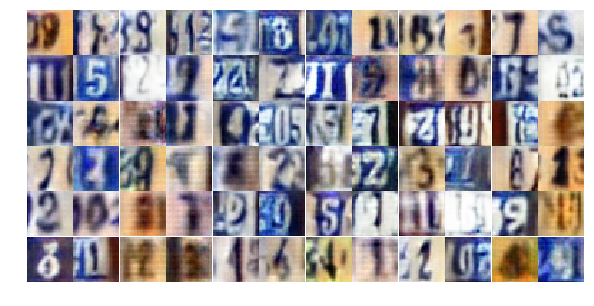

Epoch 16/25... Discriminator Loss: 0.5898... Generator Loss: 1.2360
Epoch 16/25... Discriminator Loss: 0.8819... Generator Loss: 0.8468
Epoch 16/25... Discriminator Loss: 0.8843... Generator Loss: 0.8293
Epoch 16/25... Discriminator Loss: 0.7486... Generator Loss: 1.1961
Epoch 16/25... Discriminator Loss: 0.5549... Generator Loss: 2.0728
Epoch 16/25... Discriminator Loss: 0.5943... Generator Loss: 1.4526
Epoch 16/25... Discriminator Loss: 1.6464... Generator Loss: 0.2772
Epoch 16/25... Discriminator Loss: 1.1754... Generator Loss: 0.5456
Epoch 16/25... Discriminator Loss: 0.6988... Generator Loss: 0.9308
Epoch 16/25... Discriminator Loss: 0.8211... Generator Loss: 0.8191


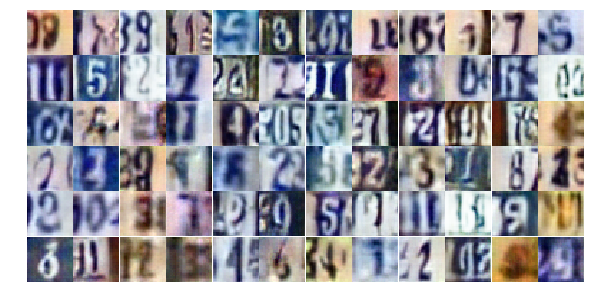

Epoch 16/25... Discriminator Loss: 1.1035... Generator Loss: 0.6253
Epoch 16/25... Discriminator Loss: 0.7199... Generator Loss: 0.9297
Epoch 16/25... Discriminator Loss: 0.8070... Generator Loss: 0.8787
Epoch 16/25... Discriminator Loss: 1.3263... Generator Loss: 0.4406
Epoch 16/25... Discriminator Loss: 0.6370... Generator Loss: 1.2105
Epoch 16/25... Discriminator Loss: 0.6708... Generator Loss: 1.1579
Epoch 16/25... Discriminator Loss: 0.9361... Generator Loss: 0.8422
Epoch 16/25... Discriminator Loss: 0.5137... Generator Loss: 1.3785
Epoch 16/25... Discriminator Loss: 0.4325... Generator Loss: 1.5058
Epoch 16/25... Discriminator Loss: 0.8432... Generator Loss: 0.9015


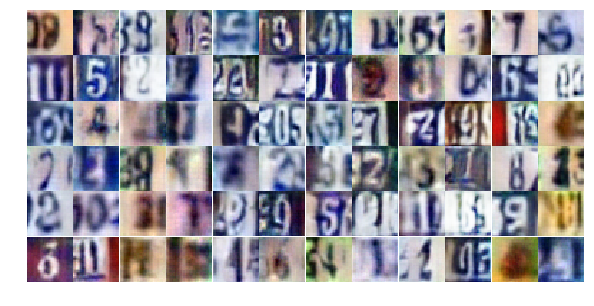

Epoch 16/25... Discriminator Loss: 0.7219... Generator Loss: 1.0304
Epoch 16/25... Discriminator Loss: 0.7921... Generator Loss: 0.8369
Epoch 16/25... Discriminator Loss: 0.8366... Generator Loss: 0.8064
Epoch 16/25... Discriminator Loss: 0.8891... Generator Loss: 0.6655
Epoch 16/25... Discriminator Loss: 0.9427... Generator Loss: 0.8337
Epoch 16/25... Discriminator Loss: 0.7621... Generator Loss: 1.2128
Epoch 16/25... Discriminator Loss: 0.8813... Generator Loss: 0.7414
Epoch 16/25... Discriminator Loss: 0.5816... Generator Loss: 1.2518
Epoch 16/25... Discriminator Loss: 0.8206... Generator Loss: 1.3465
Epoch 16/25... Discriminator Loss: 0.6442... Generator Loss: 1.0962


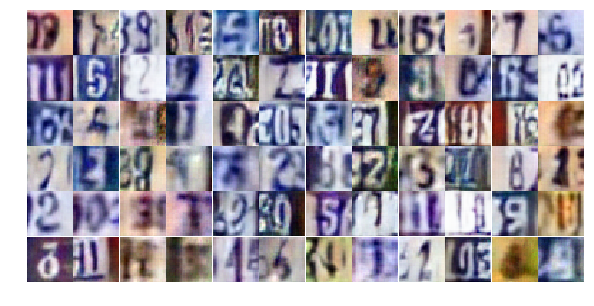

Epoch 16/25... Discriminator Loss: 0.7079... Generator Loss: 0.9857
Epoch 16/25... Discriminator Loss: 0.5797... Generator Loss: 1.2687
Epoch 16/25... Discriminator Loss: 0.5301... Generator Loss: 1.3691
Epoch 16/25... Discriminator Loss: 0.5959... Generator Loss: 1.5301
Epoch 16/25... Discriminator Loss: 0.7601... Generator Loss: 1.1772
Epoch 16/25... Discriminator Loss: 0.6718... Generator Loss: 1.3401
Epoch 16/25... Discriminator Loss: 1.1506... Generator Loss: 0.5349
Epoch 16/25... Discriminator Loss: 1.3532... Generator Loss: 0.4196
Epoch 16/25... Discriminator Loss: 1.1652... Generator Loss: 0.5402
Epoch 16/25... Discriminator Loss: 0.5598... Generator Loss: 2.0072


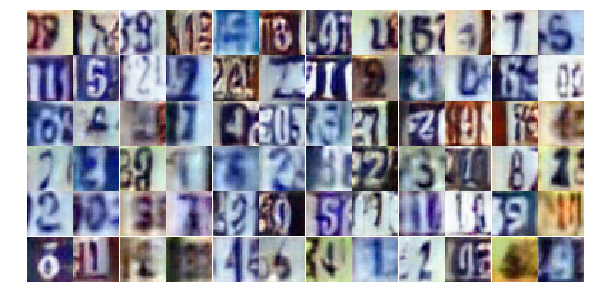

Epoch 16/25... Discriminator Loss: 0.5834... Generator Loss: 1.3694
Epoch 16/25... Discriminator Loss: 0.8914... Generator Loss: 2.1813
Epoch 16/25... Discriminator Loss: 0.6503... Generator Loss: 1.0225
Epoch 16/25... Discriminator Loss: 1.2420... Generator Loss: 0.5862
Epoch 16/25... Discriminator Loss: 0.6226... Generator Loss: 1.3705
Epoch 16/25... Discriminator Loss: 1.2611... Generator Loss: 0.4720
Epoch 16/25... Discriminator Loss: 0.5021... Generator Loss: 1.7280
Epoch 16/25... Discriminator Loss: 0.7371... Generator Loss: 0.9468
Epoch 16/25... Discriminator Loss: 0.4775... Generator Loss: 1.3827
Epoch 16/25... Discriminator Loss: 0.8794... Generator Loss: 0.7505


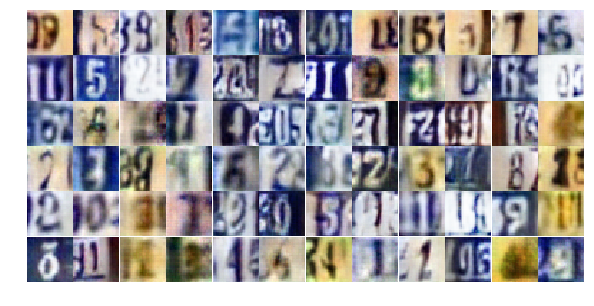

Epoch 16/25... Discriminator Loss: 1.4510... Generator Loss: 0.3828
Epoch 16/25... Discriminator Loss: 0.6326... Generator Loss: 1.8180
Epoch 16/25... Discriminator Loss: 1.3137... Generator Loss: 0.4362
Epoch 16/25... Discriminator Loss: 0.3638... Generator Loss: 2.5256
Epoch 16/25... Discriminator Loss: 0.5461... Generator Loss: 1.8909
Epoch 16/25... Discriminator Loss: 0.7138... Generator Loss: 1.0291
Epoch 17/25... Discriminator Loss: 0.7682... Generator Loss: 2.4945
Epoch 17/25... Discriminator Loss: 1.0523... Generator Loss: 0.6002
Epoch 17/25... Discriminator Loss: 0.9186... Generator Loss: 0.8087
Epoch 17/25... Discriminator Loss: 0.6438... Generator Loss: 1.4064


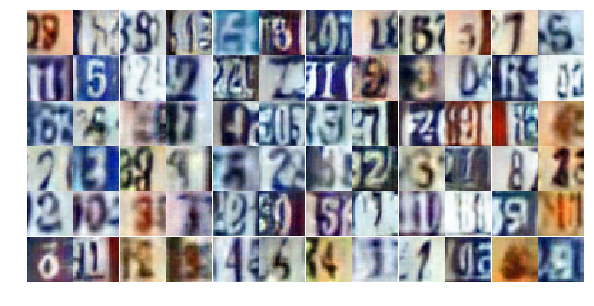

Epoch 17/25... Discriminator Loss: 0.5094... Generator Loss: 1.3477
Epoch 17/25... Discriminator Loss: 0.4408... Generator Loss: 1.5584
Epoch 17/25... Discriminator Loss: 1.1804... Generator Loss: 0.5615
Epoch 17/25... Discriminator Loss: 0.9633... Generator Loss: 0.6514
Epoch 17/25... Discriminator Loss: 0.9279... Generator Loss: 0.6994
Epoch 17/25... Discriminator Loss: 1.0943... Generator Loss: 0.5421
Epoch 17/25... Discriminator Loss: 0.8176... Generator Loss: 0.8598
Epoch 17/25... Discriminator Loss: 0.6913... Generator Loss: 1.0208
Epoch 17/25... Discriminator Loss: 0.3444... Generator Loss: 1.7463
Epoch 17/25... Discriminator Loss: 0.5937... Generator Loss: 1.5533


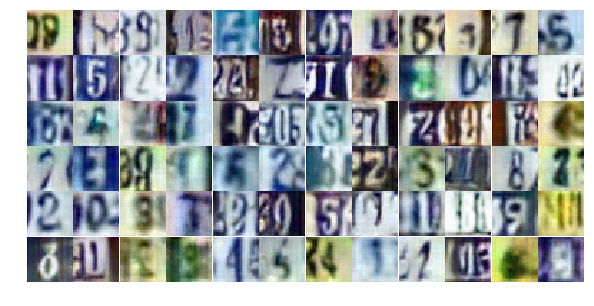

Epoch 17/25... Discriminator Loss: 0.7143... Generator Loss: 1.5095
Epoch 17/25... Discriminator Loss: 0.8252... Generator Loss: 3.0532
Epoch 17/25... Discriminator Loss: 0.9994... Generator Loss: 0.7131
Epoch 17/25... Discriminator Loss: 1.5792... Generator Loss: 0.4829
Epoch 17/25... Discriminator Loss: 0.5929... Generator Loss: 1.5003
Epoch 17/25... Discriminator Loss: 0.8582... Generator Loss: 0.8703
Epoch 17/25... Discriminator Loss: 0.5578... Generator Loss: 1.3327
Epoch 17/25... Discriminator Loss: 0.6123... Generator Loss: 1.2479
Epoch 17/25... Discriminator Loss: 0.7321... Generator Loss: 1.0098
Epoch 17/25... Discriminator Loss: 0.6905... Generator Loss: 1.0013


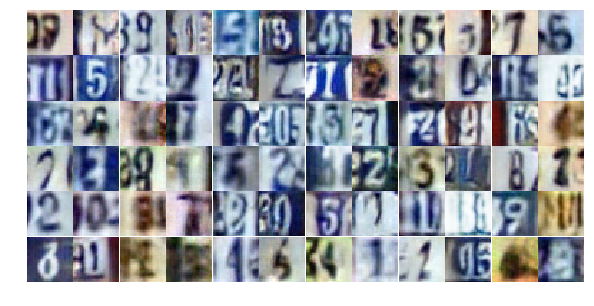

Epoch 17/25... Discriminator Loss: 1.5720... Generator Loss: 0.3774
Epoch 17/25... Discriminator Loss: 0.7375... Generator Loss: 1.0040
Epoch 17/25... Discriminator Loss: 0.4461... Generator Loss: 1.4385
Epoch 17/25... Discriminator Loss: 0.8170... Generator Loss: 0.8415
Epoch 17/25... Discriminator Loss: 1.1929... Generator Loss: 0.5180
Epoch 17/25... Discriminator Loss: 0.4075... Generator Loss: 1.7263
Epoch 17/25... Discriminator Loss: 0.5641... Generator Loss: 1.3735
Epoch 17/25... Discriminator Loss: 0.9753... Generator Loss: 0.7029
Epoch 17/25... Discriminator Loss: 1.2945... Generator Loss: 0.4648
Epoch 17/25... Discriminator Loss: 0.4523... Generator Loss: 1.7109


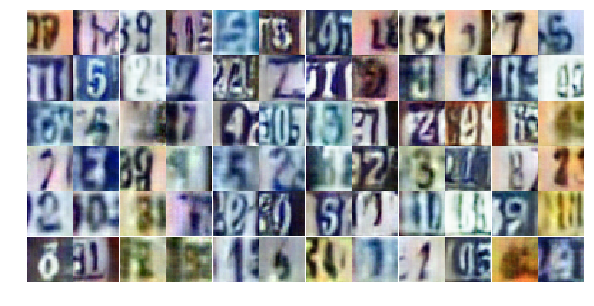

Epoch 17/25... Discriminator Loss: 1.2732... Generator Loss: 0.5442
Epoch 17/25... Discriminator Loss: 1.0840... Generator Loss: 0.7242
Epoch 17/25... Discriminator Loss: 0.7971... Generator Loss: 0.9066
Epoch 17/25... Discriminator Loss: 1.0881... Generator Loss: 0.5897
Epoch 17/25... Discriminator Loss: 1.2537... Generator Loss: 0.4535
Epoch 17/25... Discriminator Loss: 0.9430... Generator Loss: 0.7063
Epoch 17/25... Discriminator Loss: 0.9840... Generator Loss: 2.1423
Epoch 17/25... Discriminator Loss: 0.4495... Generator Loss: 1.8100
Epoch 17/25... Discriminator Loss: 0.3008... Generator Loss: 2.1789
Epoch 17/25... Discriminator Loss: 0.9972... Generator Loss: 0.6264


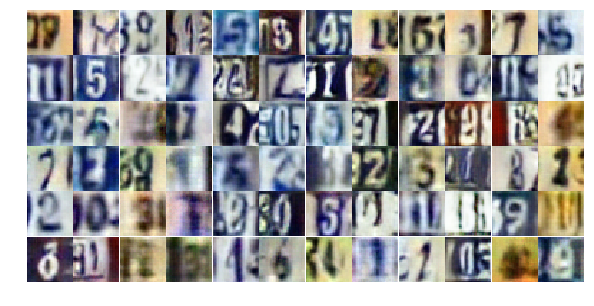

Epoch 17/25... Discriminator Loss: 1.2165... Generator Loss: 2.0770
Epoch 17/25... Discriminator Loss: 0.3711... Generator Loss: 1.7755
Epoch 17/25... Discriminator Loss: 0.8417... Generator Loss: 1.7382
Epoch 17/25... Discriminator Loss: 0.5166... Generator Loss: 1.4649
Epoch 17/25... Discriminator Loss: 0.9341... Generator Loss: 0.7764
Epoch 17/25... Discriminator Loss: 0.9329... Generator Loss: 0.7589
Epoch 17/25... Discriminator Loss: 1.4455... Generator Loss: 0.3955
Epoch 17/25... Discriminator Loss: 0.6002... Generator Loss: 1.2538
Epoch 17/25... Discriminator Loss: 0.7496... Generator Loss: 1.8291
Epoch 17/25... Discriminator Loss: 1.1568... Generator Loss: 0.5987


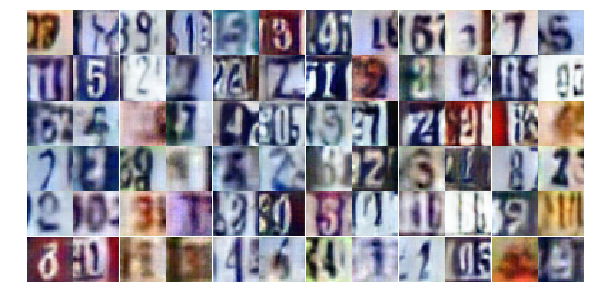

Epoch 17/25... Discriminator Loss: 0.6996... Generator Loss: 1.5817
Epoch 17/25... Discriminator Loss: 0.7736... Generator Loss: 1.0164
Epoch 17/25... Discriminator Loss: 0.5303... Generator Loss: 1.2828
Epoch 17/25... Discriminator Loss: 0.5938... Generator Loss: 1.7970
Epoch 18/25... Discriminator Loss: 1.0685... Generator Loss: 0.6192
Epoch 18/25... Discriminator Loss: 1.1634... Generator Loss: 0.5225
Epoch 18/25... Discriminator Loss: 0.6888... Generator Loss: 1.0490
Epoch 18/25... Discriminator Loss: 0.9011... Generator Loss: 0.6887
Epoch 18/25... Discriminator Loss: 0.8335... Generator Loss: 1.1426
Epoch 18/25... Discriminator Loss: 0.6315... Generator Loss: 1.3000


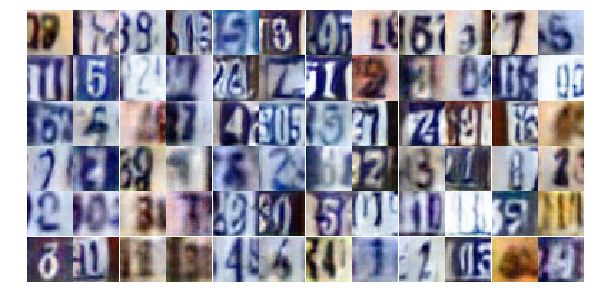

Epoch 18/25... Discriminator Loss: 0.4511... Generator Loss: 2.0690
Epoch 18/25... Discriminator Loss: 1.5163... Generator Loss: 0.3719
Epoch 18/25... Discriminator Loss: 0.7106... Generator Loss: 1.0082
Epoch 18/25... Discriminator Loss: 0.4225... Generator Loss: 1.5892
Epoch 18/25... Discriminator Loss: 0.6849... Generator Loss: 0.9651
Epoch 18/25... Discriminator Loss: 1.0841... Generator Loss: 0.6052
Epoch 18/25... Discriminator Loss: 0.7099... Generator Loss: 1.0147
Epoch 18/25... Discriminator Loss: 1.2251... Generator Loss: 0.4951
Epoch 18/25... Discriminator Loss: 0.7469... Generator Loss: 0.9642
Epoch 18/25... Discriminator Loss: 0.4033... Generator Loss: 1.6957


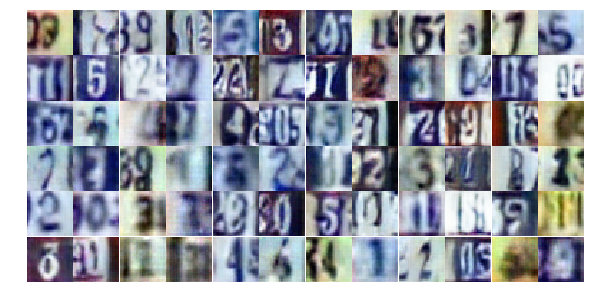

Epoch 18/25... Discriminator Loss: 0.4783... Generator Loss: 1.5886
Epoch 18/25... Discriminator Loss: 0.6343... Generator Loss: 2.1368
Epoch 18/25... Discriminator Loss: 1.1862... Generator Loss: 0.5878
Epoch 18/25... Discriminator Loss: 0.4670... Generator Loss: 1.4427
Epoch 18/25... Discriminator Loss: 0.9635... Generator Loss: 0.7952
Epoch 18/25... Discriminator Loss: 0.9525... Generator Loss: 0.7047
Epoch 18/25... Discriminator Loss: 0.8838... Generator Loss: 1.1177
Epoch 18/25... Discriminator Loss: 1.2362... Generator Loss: 0.5096
Epoch 18/25... Discriminator Loss: 0.9520... Generator Loss: 0.7875
Epoch 18/25... Discriminator Loss: 0.6061... Generator Loss: 1.2658


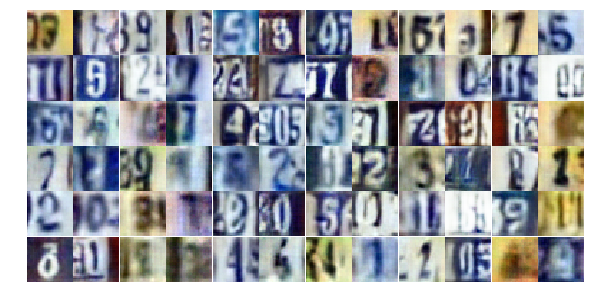

Epoch 18/25... Discriminator Loss: 0.5184... Generator Loss: 1.2628
Epoch 18/25... Discriminator Loss: 0.7682... Generator Loss: 1.0696
Epoch 18/25... Discriminator Loss: 0.9228... Generator Loss: 0.7435
Epoch 18/25... Discriminator Loss: 0.6843... Generator Loss: 1.1196
Epoch 18/25... Discriminator Loss: 1.2709... Generator Loss: 0.4741
Epoch 18/25... Discriminator Loss: 0.8666... Generator Loss: 0.8290
Epoch 18/25... Discriminator Loss: 0.6995... Generator Loss: 1.0665
Epoch 18/25... Discriminator Loss: 0.7940... Generator Loss: 0.9183
Epoch 18/25... Discriminator Loss: 0.7849... Generator Loss: 0.8463
Epoch 18/25... Discriminator Loss: 0.6912... Generator Loss: 1.0646


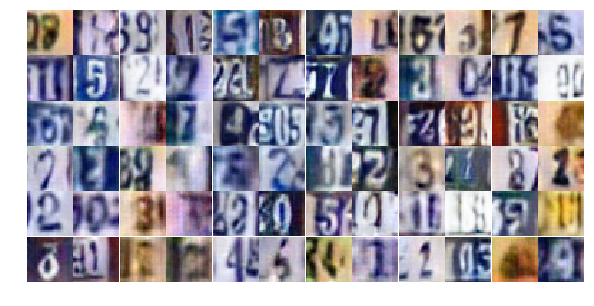

Epoch 18/25... Discriminator Loss: 0.7716... Generator Loss: 0.9101
Epoch 18/25... Discriminator Loss: 0.6921... Generator Loss: 1.1310
Epoch 18/25... Discriminator Loss: 0.5874... Generator Loss: 1.1808
Epoch 18/25... Discriminator Loss: 0.7846... Generator Loss: 0.8186
Epoch 18/25... Discriminator Loss: 0.9696... Generator Loss: 0.7914
Epoch 18/25... Discriminator Loss: 0.4384... Generator Loss: 1.4807
Epoch 18/25... Discriminator Loss: 1.0651... Generator Loss: 0.6060
Epoch 18/25... Discriminator Loss: 2.3480... Generator Loss: 3.8975
Epoch 18/25... Discriminator Loss: 1.4889... Generator Loss: 0.4145
Epoch 18/25... Discriminator Loss: 0.4754... Generator Loss: 2.0161


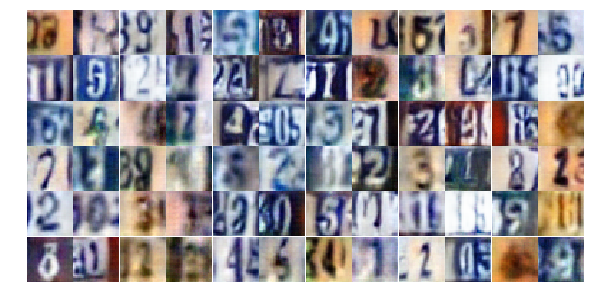

Epoch 18/25... Discriminator Loss: 0.6756... Generator Loss: 1.0459
Epoch 18/25... Discriminator Loss: 0.7569... Generator Loss: 1.3223
Epoch 18/25... Discriminator Loss: 0.7136... Generator Loss: 1.0320
Epoch 18/25... Discriminator Loss: 0.8929... Generator Loss: 1.0575
Epoch 18/25... Discriminator Loss: 0.9844... Generator Loss: 0.6875
Epoch 18/25... Discriminator Loss: 0.6706... Generator Loss: 1.9535
Epoch 18/25... Discriminator Loss: 0.8818... Generator Loss: 0.7308
Epoch 18/25... Discriminator Loss: 0.4830... Generator Loss: 1.7108
Epoch 18/25... Discriminator Loss: 0.8198... Generator Loss: 0.9800
Epoch 18/25... Discriminator Loss: 0.9390... Generator Loss: 0.7536


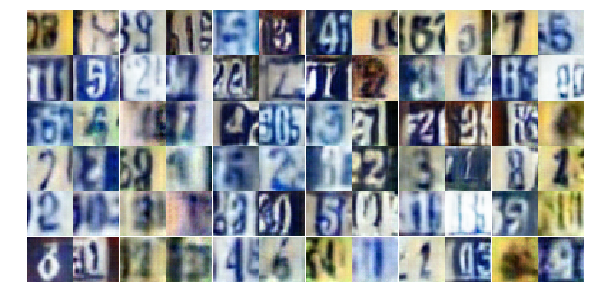

Epoch 18/25... Discriminator Loss: 0.5973... Generator Loss: 1.8140
Epoch 19/25... Discriminator Loss: 1.0291... Generator Loss: 0.5769
Epoch 19/25... Discriminator Loss: 1.4815... Generator Loss: 0.3897
Epoch 19/25... Discriminator Loss: 0.8360... Generator Loss: 0.9603
Epoch 19/25... Discriminator Loss: 0.7837... Generator Loss: 1.0921
Epoch 19/25... Discriminator Loss: 0.9203... Generator Loss: 0.7931
Epoch 19/25... Discriminator Loss: 0.6916... Generator Loss: 1.1309
Epoch 19/25... Discriminator Loss: 1.3140... Generator Loss: 0.4835
Epoch 19/25... Discriminator Loss: 0.7376... Generator Loss: 1.7186
Epoch 19/25... Discriminator Loss: 0.9168... Generator Loss: 0.7593


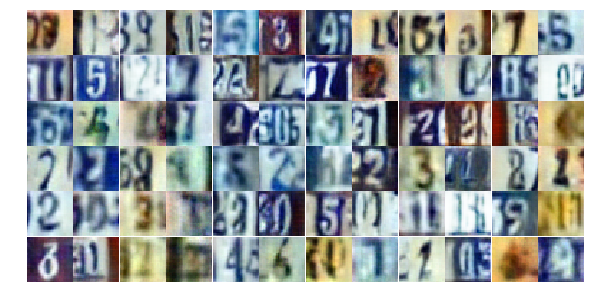

Epoch 19/25... Discriminator Loss: 0.6671... Generator Loss: 1.0541
Epoch 19/25... Discriminator Loss: 0.8331... Generator Loss: 0.8206
Epoch 19/25... Discriminator Loss: 0.8729... Generator Loss: 0.9357
Epoch 19/25... Discriminator Loss: 1.0653... Generator Loss: 0.6632
Epoch 19/25... Discriminator Loss: 0.9974... Generator Loss: 0.7753
Epoch 19/25... Discriminator Loss: 0.6828... Generator Loss: 1.0687
Epoch 19/25... Discriminator Loss: 0.9512... Generator Loss: 0.7565
Epoch 19/25... Discriminator Loss: 0.7044... Generator Loss: 1.0136
Epoch 19/25... Discriminator Loss: 0.7538... Generator Loss: 1.2314
Epoch 19/25... Discriminator Loss: 0.9672... Generator Loss: 0.8245


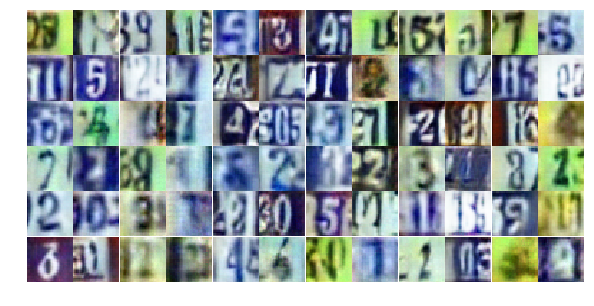

Epoch 19/25... Discriminator Loss: 1.4148... Generator Loss: 0.3939
Epoch 19/25... Discriminator Loss: 1.0889... Generator Loss: 0.6122
Epoch 19/25... Discriminator Loss: 0.9283... Generator Loss: 0.7164
Epoch 19/25... Discriminator Loss: 0.9716... Generator Loss: 0.7768
Epoch 19/25... Discriminator Loss: 1.2750... Generator Loss: 0.5065
Epoch 19/25... Discriminator Loss: 0.7604... Generator Loss: 0.9485
Epoch 19/25... Discriminator Loss: 0.8085... Generator Loss: 0.8809
Epoch 19/25... Discriminator Loss: 0.4370... Generator Loss: 1.5305
Epoch 19/25... Discriminator Loss: 0.7204... Generator Loss: 2.3594
Epoch 19/25... Discriminator Loss: 0.8844... Generator Loss: 0.8983


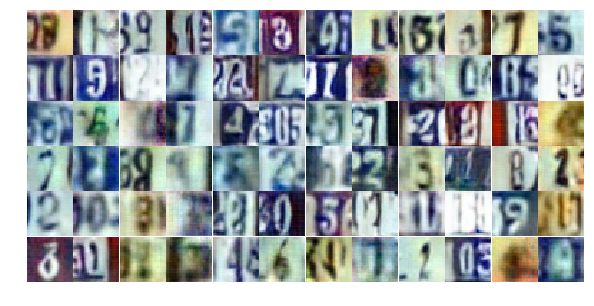

Epoch 19/25... Discriminator Loss: 1.1422... Generator Loss: 0.5424
Epoch 19/25... Discriminator Loss: 0.6351... Generator Loss: 1.2349
Epoch 19/25... Discriminator Loss: 1.1686... Generator Loss: 0.5289
Epoch 19/25... Discriminator Loss: 0.6199... Generator Loss: 1.1050
Epoch 19/25... Discriminator Loss: 0.5383... Generator Loss: 1.3032
Epoch 19/25... Discriminator Loss: 2.3311... Generator Loss: 3.4899
Epoch 19/25... Discriminator Loss: 0.7461... Generator Loss: 1.1650
Epoch 19/25... Discriminator Loss: 0.4857... Generator Loss: 1.4742
Epoch 19/25... Discriminator Loss: 0.7816... Generator Loss: 1.1133
Epoch 19/25... Discriminator Loss: 0.5620... Generator Loss: 1.2731


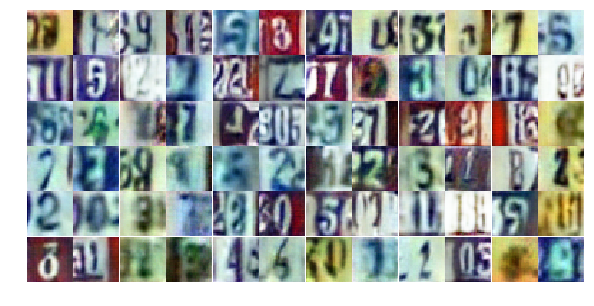

Epoch 19/25... Discriminator Loss: 0.5519... Generator Loss: 1.2826
Epoch 19/25... Discriminator Loss: 2.0133... Generator Loss: 0.2172
Epoch 19/25... Discriminator Loss: 1.4722... Generator Loss: 0.3642
Epoch 19/25... Discriminator Loss: 0.8054... Generator Loss: 0.8907
Epoch 19/25... Discriminator Loss: 0.9594... Generator Loss: 0.7163
Epoch 19/25... Discriminator Loss: 0.5949... Generator Loss: 1.3501
Epoch 19/25... Discriminator Loss: 0.6471... Generator Loss: 1.0558
Epoch 19/25... Discriminator Loss: 0.6222... Generator Loss: 1.0320
Epoch 19/25... Discriminator Loss: 0.6523... Generator Loss: 1.0709
Epoch 19/25... Discriminator Loss: 1.0313... Generator Loss: 0.6556


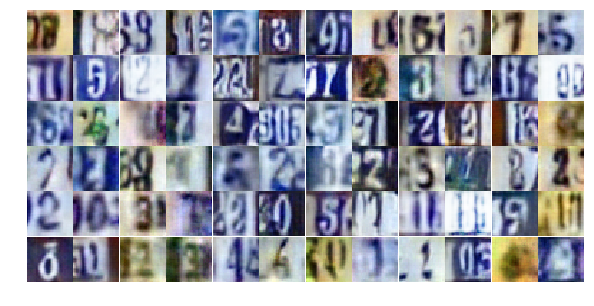

Epoch 19/25... Discriminator Loss: 0.8111... Generator Loss: 0.7910
Epoch 19/25... Discriminator Loss: 0.7566... Generator Loss: 1.0043
Epoch 19/25... Discriminator Loss: 0.5960... Generator Loss: 2.6007
Epoch 19/25... Discriminator Loss: 1.6261... Generator Loss: 0.3560
Epoch 19/25... Discriminator Loss: 0.7112... Generator Loss: 1.1769
Epoch 19/25... Discriminator Loss: 0.8144... Generator Loss: 0.9109
Epoch 19/25... Discriminator Loss: 1.0203... Generator Loss: 0.6424
Epoch 19/25... Discriminator Loss: 0.6588... Generator Loss: 1.2317
Epoch 20/25... Discriminator Loss: 0.8525... Generator Loss: 0.7885
Epoch 20/25... Discriminator Loss: 0.8019... Generator Loss: 0.8609


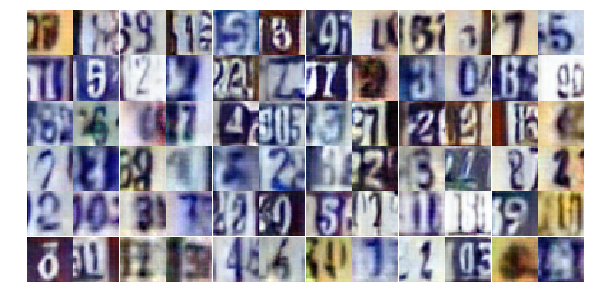

Epoch 20/25... Discriminator Loss: 0.6722... Generator Loss: 1.0308
Epoch 20/25... Discriminator Loss: 1.3039... Generator Loss: 0.4458
Epoch 20/25... Discriminator Loss: 1.3795... Generator Loss: 0.4891
Epoch 20/25... Discriminator Loss: 0.9954... Generator Loss: 0.6890
Epoch 20/25... Discriminator Loss: 0.5772... Generator Loss: 1.3285
Epoch 20/25... Discriminator Loss: 0.6135... Generator Loss: 1.2048
Epoch 20/25... Discriminator Loss: 0.7686... Generator Loss: 0.8598
Epoch 20/25... Discriminator Loss: 0.6689... Generator Loss: 1.1979
Epoch 20/25... Discriminator Loss: 0.7200... Generator Loss: 1.1387
Epoch 20/25... Discriminator Loss: 0.9782... Generator Loss: 0.6180


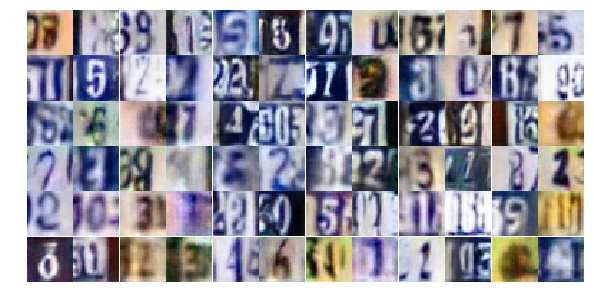

Epoch 20/25... Discriminator Loss: 1.1865... Generator Loss: 0.5808
Epoch 20/25... Discriminator Loss: 1.3171... Generator Loss: 0.4365
Epoch 20/25... Discriminator Loss: 0.8450... Generator Loss: 1.1449
Epoch 20/25... Discriminator Loss: 4.6919... Generator Loss: 0.0380
Epoch 20/25... Discriminator Loss: 1.1981... Generator Loss: 0.6976
Epoch 20/25... Discriminator Loss: 0.9500... Generator Loss: 0.7868
Epoch 20/25... Discriminator Loss: 0.7133... Generator Loss: 1.1788
Epoch 20/25... Discriminator Loss: 0.7398... Generator Loss: 1.1837
Epoch 20/25... Discriminator Loss: 0.7553... Generator Loss: 0.9959
Epoch 20/25... Discriminator Loss: 1.2444... Generator Loss: 0.5811


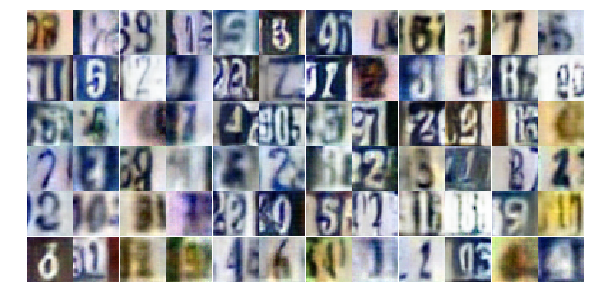

Epoch 20/25... Discriminator Loss: 0.8193... Generator Loss: 0.8892
Epoch 20/25... Discriminator Loss: 0.8285... Generator Loss: 0.8376
Epoch 20/25... Discriminator Loss: 0.4544... Generator Loss: 1.8496
Epoch 20/25... Discriminator Loss: 1.2283... Generator Loss: 0.5456
Epoch 20/25... Discriminator Loss: 0.8068... Generator Loss: 1.1502
Epoch 20/25... Discriminator Loss: 0.5599... Generator Loss: 1.6089
Epoch 20/25... Discriminator Loss: 0.8109... Generator Loss: 3.0226
Epoch 20/25... Discriminator Loss: 1.6336... Generator Loss: 0.2925
Epoch 20/25... Discriminator Loss: 0.9342... Generator Loss: 0.7375
Epoch 20/25... Discriminator Loss: 0.6243... Generator Loss: 1.1125


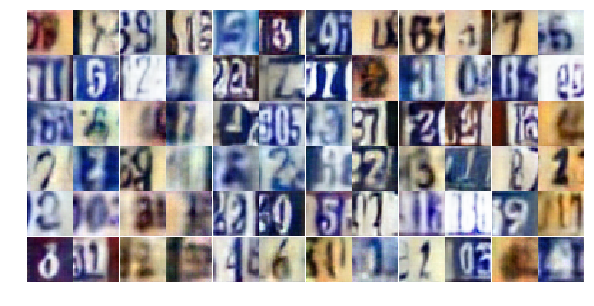

Epoch 20/25... Discriminator Loss: 0.9869... Generator Loss: 0.7020
Epoch 20/25... Discriminator Loss: 0.4186... Generator Loss: 1.5668
Epoch 20/25... Discriminator Loss: 0.9500... Generator Loss: 0.7389
Epoch 20/25... Discriminator Loss: 1.0471... Generator Loss: 0.6725
Epoch 20/25... Discriminator Loss: 0.7835... Generator Loss: 0.9139
Epoch 20/25... Discriminator Loss: 0.7347... Generator Loss: 1.0811
Epoch 20/25... Discriminator Loss: 0.8316... Generator Loss: 0.8950
Epoch 20/25... Discriminator Loss: 0.9220... Generator Loss: 0.6964
Epoch 20/25... Discriminator Loss: 0.7488... Generator Loss: 0.9368
Epoch 20/25... Discriminator Loss: 0.7747... Generator Loss: 0.9957


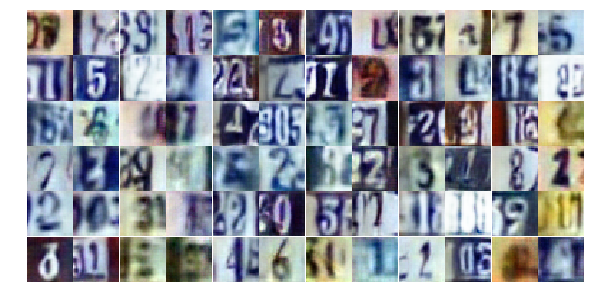

Epoch 20/25... Discriminator Loss: 0.7326... Generator Loss: 1.0053
Epoch 20/25... Discriminator Loss: 0.8965... Generator Loss: 0.7773
Epoch 20/25... Discriminator Loss: 1.7416... Generator Loss: 0.4250
Epoch 20/25... Discriminator Loss: 1.1381... Generator Loss: 0.6606
Epoch 20/25... Discriminator Loss: 0.7016... Generator Loss: 1.0692
Epoch 20/25... Discriminator Loss: 0.8778... Generator Loss: 0.8102
Epoch 20/25... Discriminator Loss: 0.9614... Generator Loss: 0.6792
Epoch 20/25... Discriminator Loss: 0.5470... Generator Loss: 1.7118
Epoch 20/25... Discriminator Loss: 0.6420... Generator Loss: 1.0280
Epoch 20/25... Discriminator Loss: 0.6844... Generator Loss: 1.1708


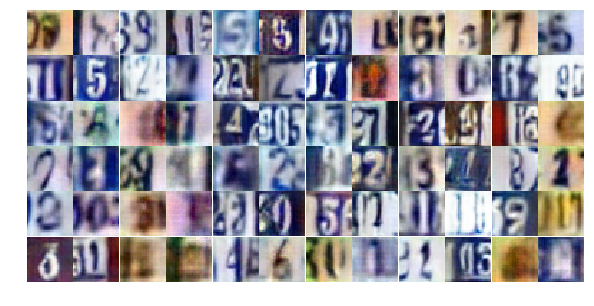

Epoch 20/25... Discriminator Loss: 0.5346... Generator Loss: 1.3398
Epoch 20/25... Discriminator Loss: 0.6264... Generator Loss: 1.3312
Epoch 20/25... Discriminator Loss: 0.5362... Generator Loss: 2.0926
Epoch 20/25... Discriminator Loss: 0.9980... Generator Loss: 1.8093
Epoch 20/25... Discriminator Loss: 0.6910... Generator Loss: 1.0935
Epoch 20/25... Discriminator Loss: 0.5909... Generator Loss: 1.0867
Epoch 21/25... Discriminator Loss: 0.8411... Generator Loss: 1.4877
Epoch 21/25... Discriminator Loss: 1.1373... Generator Loss: 0.5566
Epoch 21/25... Discriminator Loss: 1.2156... Generator Loss: 0.5031
Epoch 21/25... Discriminator Loss: 1.2107... Generator Loss: 0.5391


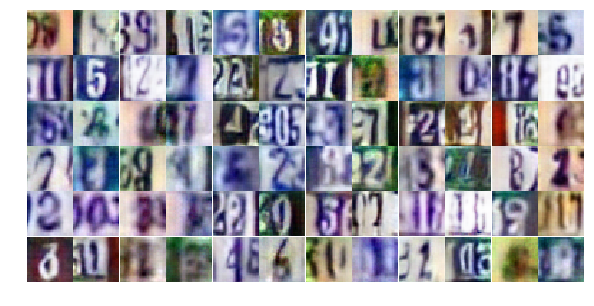

Epoch 21/25... Discriminator Loss: 0.6416... Generator Loss: 1.3302
Epoch 21/25... Discriminator Loss: 1.7509... Generator Loss: 0.2855
Epoch 21/25... Discriminator Loss: 0.5676... Generator Loss: 1.1659
Epoch 21/25... Discriminator Loss: 0.6099... Generator Loss: 1.0270
Epoch 21/25... Discriminator Loss: 0.6178... Generator Loss: 1.5336
Epoch 21/25... Discriminator Loss: 0.4486... Generator Loss: 1.6413
Epoch 21/25... Discriminator Loss: 0.8911... Generator Loss: 0.8563
Epoch 21/25... Discriminator Loss: 0.8711... Generator Loss: 0.9222
Epoch 21/25... Discriminator Loss: 0.7235... Generator Loss: 0.9527
Epoch 21/25... Discriminator Loss: 1.0864... Generator Loss: 0.6178


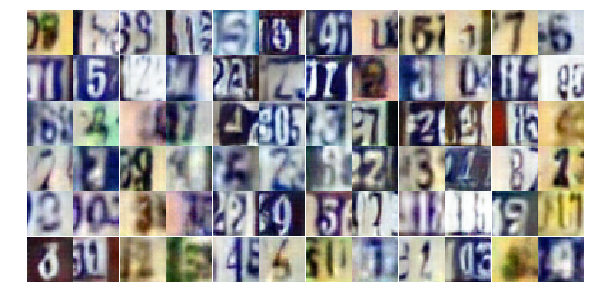

Epoch 21/25... Discriminator Loss: 0.4603... Generator Loss: 1.4057
Epoch 21/25... Discriminator Loss: 0.8211... Generator Loss: 0.7849
Epoch 21/25... Discriminator Loss: 1.8172... Generator Loss: 0.3082
Epoch 21/25... Discriminator Loss: 1.7861... Generator Loss: 0.3333
Epoch 21/25... Discriminator Loss: 0.4547... Generator Loss: 2.2535
Epoch 21/25... Discriminator Loss: 1.6703... Generator Loss: 0.2974
Epoch 21/25... Discriminator Loss: 0.8895... Generator Loss: 0.7272
Epoch 21/25... Discriminator Loss: 0.6045... Generator Loss: 1.1072
Epoch 21/25... Discriminator Loss: 0.5883... Generator Loss: 1.2486
Epoch 21/25... Discriminator Loss: 0.5911... Generator Loss: 1.1642


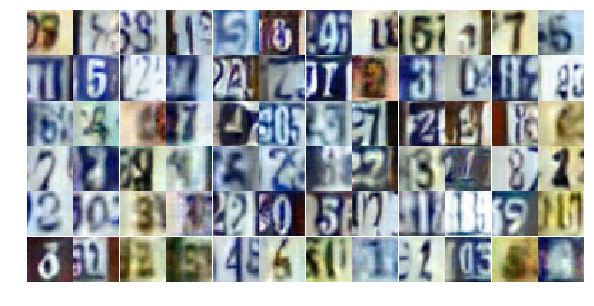

Epoch 21/25... Discriminator Loss: 1.2495... Generator Loss: 0.4925
Epoch 21/25... Discriminator Loss: 0.4830... Generator Loss: 1.5528
Epoch 21/25... Discriminator Loss: 1.1832... Generator Loss: 0.5256
Epoch 21/25... Discriminator Loss: 0.5981... Generator Loss: 1.2291
Epoch 21/25... Discriminator Loss: 1.1991... Generator Loss: 0.5834
Epoch 21/25... Discriminator Loss: 1.4638... Generator Loss: 0.3563
Epoch 21/25... Discriminator Loss: 0.5391... Generator Loss: 1.2545
Epoch 21/25... Discriminator Loss: 1.1667... Generator Loss: 0.5492
Epoch 21/25... Discriminator Loss: 1.1402... Generator Loss: 0.6216
Epoch 21/25... Discriminator Loss: 1.6744... Generator Loss: 0.3197


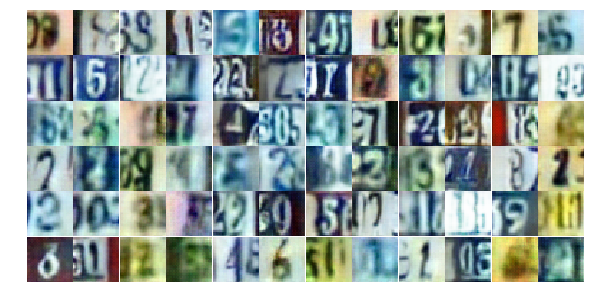

Epoch 21/25... Discriminator Loss: 1.0090... Generator Loss: 1.4712
Epoch 21/25... Discriminator Loss: 1.0142... Generator Loss: 0.7137
Epoch 21/25... Discriminator Loss: 1.3668... Generator Loss: 0.4205
Epoch 21/25... Discriminator Loss: 0.6418... Generator Loss: 1.2964
Epoch 21/25... Discriminator Loss: 0.6430... Generator Loss: 1.1336
Epoch 21/25... Discriminator Loss: 1.0585... Generator Loss: 0.6274
Epoch 21/25... Discriminator Loss: 0.7429... Generator Loss: 1.2157
Epoch 21/25... Discriminator Loss: 1.6277... Generator Loss: 0.3406
Epoch 21/25... Discriminator Loss: 0.9556... Generator Loss: 0.7707
Epoch 21/25... Discriminator Loss: 0.4127... Generator Loss: 2.0478


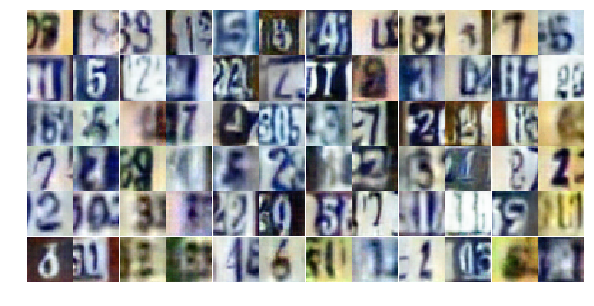

Epoch 21/25... Discriminator Loss: 0.9694... Generator Loss: 0.7092
Epoch 21/25... Discriminator Loss: 1.2247... Generator Loss: 0.5601
Epoch 21/25... Discriminator Loss: 0.6847... Generator Loss: 0.9771
Epoch 21/25... Discriminator Loss: 0.8553... Generator Loss: 0.8876
Epoch 21/25... Discriminator Loss: 0.3962... Generator Loss: 1.7278
Epoch 21/25... Discriminator Loss: 1.0136... Generator Loss: 0.7684
Epoch 21/25... Discriminator Loss: 0.9673... Generator Loss: 0.6800
Epoch 21/25... Discriminator Loss: 1.3963... Generator Loss: 0.4876
Epoch 21/25... Discriminator Loss: 1.0502... Generator Loss: 0.6499
Epoch 21/25... Discriminator Loss: 0.6812... Generator Loss: 1.0821


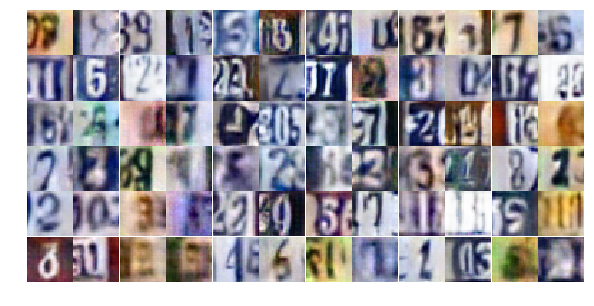

Epoch 21/25... Discriminator Loss: 0.5947... Generator Loss: 1.3113
Epoch 21/25... Discriminator Loss: 1.0034... Generator Loss: 0.7100
Epoch 21/25... Discriminator Loss: 1.4465... Generator Loss: 0.5152
Epoch 22/25... Discriminator Loss: 0.7826... Generator Loss: 0.9681
Epoch 22/25... Discriminator Loss: 0.8502... Generator Loss: 1.0423
Epoch 22/25... Discriminator Loss: 0.7158... Generator Loss: 1.2337
Epoch 22/25... Discriminator Loss: 0.5995... Generator Loss: 1.5274
Epoch 22/25... Discriminator Loss: 0.5677... Generator Loss: 1.1767
Epoch 22/25... Discriminator Loss: 1.1726... Generator Loss: 0.5373
Epoch 22/25... Discriminator Loss: 0.9208... Generator Loss: 0.7321


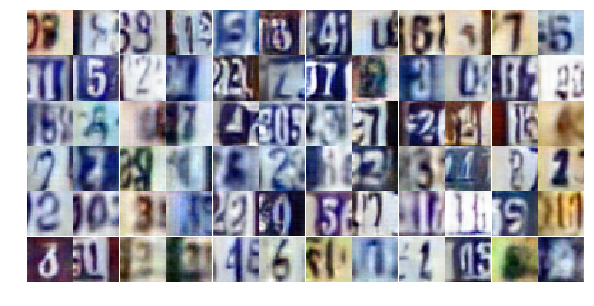

Epoch 22/25... Discriminator Loss: 0.6990... Generator Loss: 1.0942
Epoch 22/25... Discriminator Loss: 0.7017... Generator Loss: 1.3769
Epoch 22/25... Discriminator Loss: 1.3372... Generator Loss: 0.5331
Epoch 22/25... Discriminator Loss: 0.9764... Generator Loss: 0.6904
Epoch 22/25... Discriminator Loss: 1.2613... Generator Loss: 0.4947
Epoch 22/25... Discriminator Loss: 0.7207... Generator Loss: 0.9967
Epoch 22/25... Discriminator Loss: 0.7916... Generator Loss: 1.0346
Epoch 22/25... Discriminator Loss: 0.4709... Generator Loss: 1.5062
Epoch 22/25... Discriminator Loss: 0.9944... Generator Loss: 0.7380
Epoch 22/25... Discriminator Loss: 1.8110... Generator Loss: 0.2765


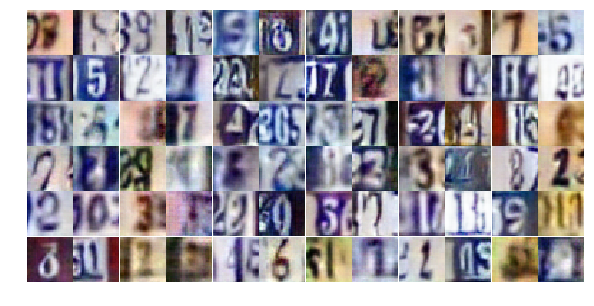

Epoch 22/25... Discriminator Loss: 0.5838... Generator Loss: 1.2941
Epoch 22/25... Discriminator Loss: 0.6196... Generator Loss: 1.2121
Epoch 22/25... Discriminator Loss: 1.1321... Generator Loss: 0.5526
Epoch 22/25... Discriminator Loss: 0.4801... Generator Loss: 2.6213
Epoch 22/25... Discriminator Loss: 0.5970... Generator Loss: 2.5782
Epoch 22/25... Discriminator Loss: 1.6028... Generator Loss: 2.9098
Epoch 22/25... Discriminator Loss: 0.5265... Generator Loss: 1.3841
Epoch 22/25... Discriminator Loss: 0.5359... Generator Loss: 1.3056
Epoch 22/25... Discriminator Loss: 0.6624... Generator Loss: 1.2273
Epoch 22/25... Discriminator Loss: 0.7206... Generator Loss: 0.9957


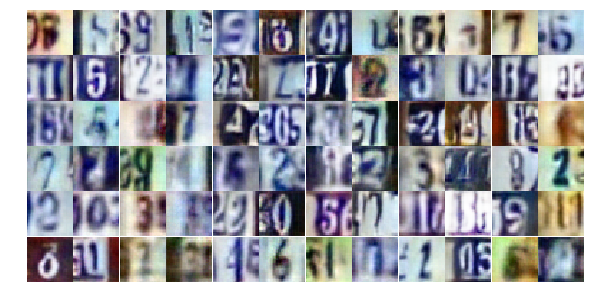

Epoch 22/25... Discriminator Loss: 0.5487... Generator Loss: 1.2044
Epoch 22/25... Discriminator Loss: 0.5651... Generator Loss: 1.2983
Epoch 22/25... Discriminator Loss: 1.0218... Generator Loss: 0.6307
Epoch 22/25... Discriminator Loss: 0.9598... Generator Loss: 0.7063
Epoch 22/25... Discriminator Loss: 1.1380... Generator Loss: 0.5669
Epoch 22/25... Discriminator Loss: 0.8412... Generator Loss: 0.8308
Epoch 22/25... Discriminator Loss: 2.0231... Generator Loss: 0.2138
Epoch 22/25... Discriminator Loss: 0.5369... Generator Loss: 1.6786
Epoch 22/25... Discriminator Loss: 1.3470... Generator Loss: 0.4592
Epoch 22/25... Discriminator Loss: 1.1587... Generator Loss: 0.5961


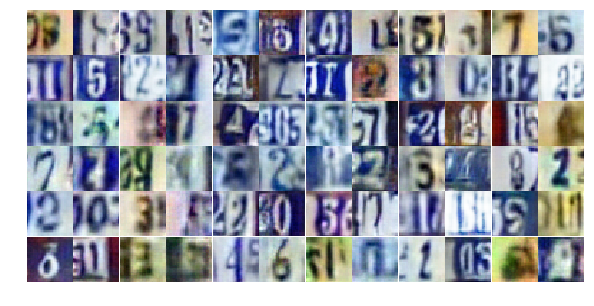

Epoch 22/25... Discriminator Loss: 0.8448... Generator Loss: 0.9171
Epoch 22/25... Discriminator Loss: 0.7815... Generator Loss: 0.9034
Epoch 22/25... Discriminator Loss: 0.4605... Generator Loss: 1.3841
Epoch 22/25... Discriminator Loss: 0.7525... Generator Loss: 0.9758
Epoch 22/25... Discriminator Loss: 0.5203... Generator Loss: 1.4513
Epoch 22/25... Discriminator Loss: 0.6618... Generator Loss: 0.9838
Epoch 22/25... Discriminator Loss: 0.8520... Generator Loss: 0.9191
Epoch 22/25... Discriminator Loss: 1.0831... Generator Loss: 0.7240
Epoch 22/25... Discriminator Loss: 0.8315... Generator Loss: 1.0122
Epoch 22/25... Discriminator Loss: 0.8231... Generator Loss: 0.8325


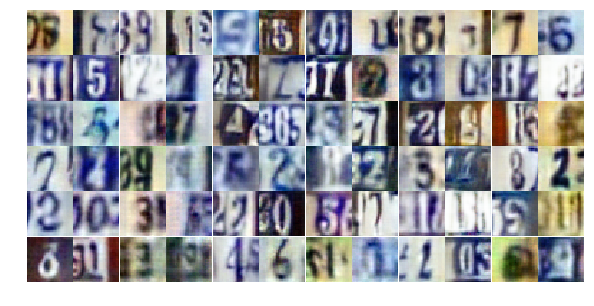

Epoch 22/25... Discriminator Loss: 0.9143... Generator Loss: 0.7955
Epoch 22/25... Discriminator Loss: 0.4765... Generator Loss: 1.7936
Epoch 22/25... Discriminator Loss: 0.8217... Generator Loss: 0.7873
Epoch 22/25... Discriminator Loss: 0.8251... Generator Loss: 0.8479
Epoch 22/25... Discriminator Loss: 1.0847... Generator Loss: 0.6218
Epoch 22/25... Discriminator Loss: 0.6094... Generator Loss: 1.9442
Epoch 22/25... Discriminator Loss: 2.5183... Generator Loss: 0.1533
Epoch 22/25... Discriminator Loss: 0.7312... Generator Loss: 1.0093
Epoch 22/25... Discriminator Loss: 0.9844... Generator Loss: 2.0409
Epoch 22/25... Discriminator Loss: 1.0204... Generator Loss: 0.7428


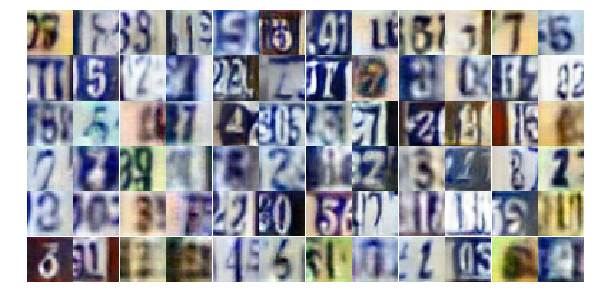

Epoch 23/25... Discriminator Loss: 0.7947... Generator Loss: 0.9666
Epoch 23/25... Discriminator Loss: 0.6082... Generator Loss: 1.2366
Epoch 23/25... Discriminator Loss: 1.0932... Generator Loss: 0.6037
Epoch 23/25... Discriminator Loss: 0.7526... Generator Loss: 0.9458
Epoch 23/25... Discriminator Loss: 0.8509... Generator Loss: 0.8420
Epoch 23/25... Discriminator Loss: 1.6014... Generator Loss: 0.3293
Epoch 23/25... Discriminator Loss: 0.7685... Generator Loss: 1.1073
Epoch 23/25... Discriminator Loss: 0.7425... Generator Loss: 1.8528
Epoch 23/25... Discriminator Loss: 1.0608... Generator Loss: 0.6672
Epoch 23/25... Discriminator Loss: 0.4063... Generator Loss: 1.6731


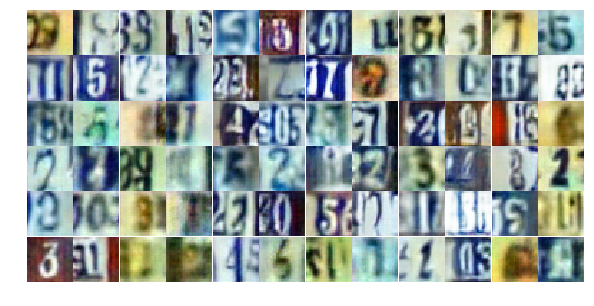

Epoch 23/25... Discriminator Loss: 0.5543... Generator Loss: 1.2646
Epoch 23/25... Discriminator Loss: 0.9209... Generator Loss: 0.7411
Epoch 23/25... Discriminator Loss: 0.9465... Generator Loss: 0.7528
Epoch 23/25... Discriminator Loss: 0.9138... Generator Loss: 0.7412
Epoch 23/25... Discriminator Loss: 0.4953... Generator Loss: 1.5717
Epoch 23/25... Discriminator Loss: 0.9252... Generator Loss: 0.7753
Epoch 23/25... Discriminator Loss: 1.0433... Generator Loss: 0.7445
Epoch 23/25... Discriminator Loss: 0.6029... Generator Loss: 1.7072
Epoch 23/25... Discriminator Loss: 1.3737... Generator Loss: 0.4219
Epoch 23/25... Discriminator Loss: 0.8579... Generator Loss: 0.9064


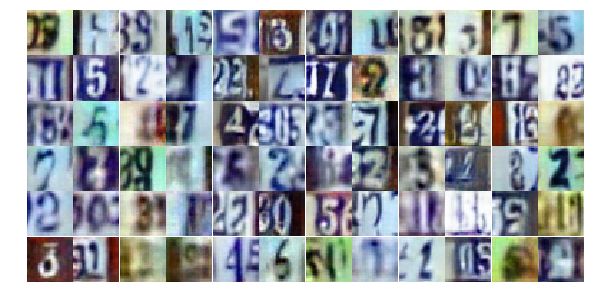

Epoch 23/25... Discriminator Loss: 1.3336... Generator Loss: 0.4802
Epoch 23/25... Discriminator Loss: 0.7280... Generator Loss: 0.9338
Epoch 23/25... Discriminator Loss: 1.3539... Generator Loss: 0.4141
Epoch 23/25... Discriminator Loss: 0.8174... Generator Loss: 0.8684
Epoch 23/25... Discriminator Loss: 1.0407... Generator Loss: 0.6775
Epoch 23/25... Discriminator Loss: 0.9827... Generator Loss: 0.6575
Epoch 23/25... Discriminator Loss: 0.7446... Generator Loss: 0.9103
Epoch 23/25... Discriminator Loss: 0.6327... Generator Loss: 1.1753
Epoch 23/25... Discriminator Loss: 0.7482... Generator Loss: 1.0706
Epoch 23/25... Discriminator Loss: 0.9849... Generator Loss: 1.1132


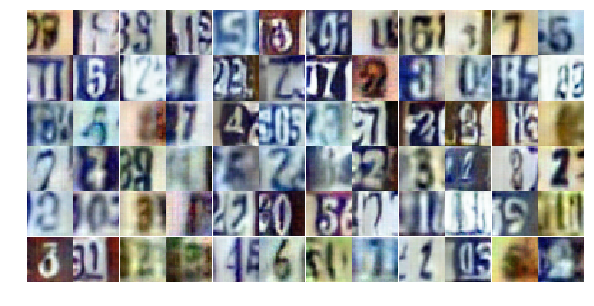

Epoch 23/25... Discriminator Loss: 0.6410... Generator Loss: 1.1017
Epoch 23/25... Discriminator Loss: 0.6515... Generator Loss: 1.0393
Epoch 23/25... Discriminator Loss: 0.6266... Generator Loss: 1.1945
Epoch 23/25... Discriminator Loss: 1.3433... Generator Loss: 0.4640
Epoch 23/25... Discriminator Loss: 0.8632... Generator Loss: 1.4271
Epoch 23/25... Discriminator Loss: 1.3761... Generator Loss: 0.4333
Epoch 23/25... Discriminator Loss: 1.3134... Generator Loss: 0.5144
Epoch 23/25... Discriminator Loss: 0.8348... Generator Loss: 0.8739
Epoch 23/25... Discriminator Loss: 0.6727... Generator Loss: 1.0656
Epoch 23/25... Discriminator Loss: 0.4810... Generator Loss: 1.3703


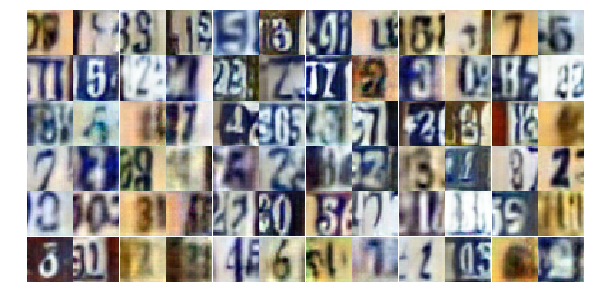

Epoch 23/25... Discriminator Loss: 1.0852... Generator Loss: 0.6586
Epoch 23/25... Discriminator Loss: 0.5795... Generator Loss: 1.8960
Epoch 23/25... Discriminator Loss: 1.0141... Generator Loss: 0.6753
Epoch 23/25... Discriminator Loss: 0.6572... Generator Loss: 1.3782
Epoch 23/25... Discriminator Loss: 0.7669... Generator Loss: 0.9356
Epoch 23/25... Discriminator Loss: 1.1146... Generator Loss: 0.6370
Epoch 23/25... Discriminator Loss: 0.7528... Generator Loss: 0.9542
Epoch 23/25... Discriminator Loss: 1.1069... Generator Loss: 0.6098
Epoch 23/25... Discriminator Loss: 0.6978... Generator Loss: 0.9581
Epoch 23/25... Discriminator Loss: 0.9205... Generator Loss: 0.7850


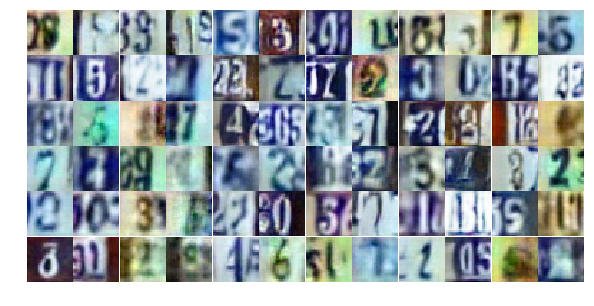

Epoch 23/25... Discriminator Loss: 0.6936... Generator Loss: 1.1188
Epoch 23/25... Discriminator Loss: 1.2876... Generator Loss: 0.4952
Epoch 23/25... Discriminator Loss: 1.6178... Generator Loss: 0.3404
Epoch 23/25... Discriminator Loss: 0.4229... Generator Loss: 2.0587
Epoch 23/25... Discriminator Loss: 1.8153... Generator Loss: 0.2614
Epoch 23/25... Discriminator Loss: 0.5814... Generator Loss: 1.3778
Epoch 23/25... Discriminator Loss: 1.1418... Generator Loss: 0.5485
Epoch 24/25... Discriminator Loss: 0.9297... Generator Loss: 0.7731
Epoch 24/25... Discriminator Loss: 0.6396... Generator Loss: 1.7374
Epoch 24/25... Discriminator Loss: 0.7317... Generator Loss: 1.1466


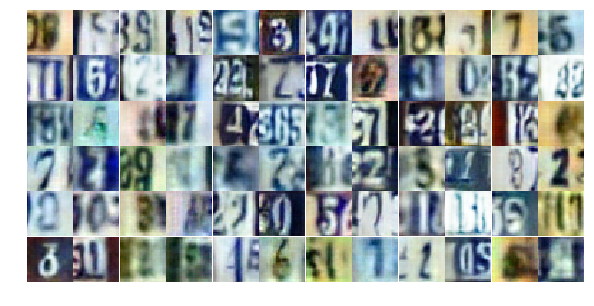

Epoch 24/25... Discriminator Loss: 0.5592... Generator Loss: 1.3897
Epoch 24/25... Discriminator Loss: 0.5455... Generator Loss: 1.3915
Epoch 24/25... Discriminator Loss: 1.0111... Generator Loss: 0.7489
Epoch 24/25... Discriminator Loss: 0.8690... Generator Loss: 0.8517
Epoch 24/25... Discriminator Loss: 1.1941... Generator Loss: 0.5600
Epoch 24/25... Discriminator Loss: 0.7457... Generator Loss: 1.0580
Epoch 24/25... Discriminator Loss: 0.8405... Generator Loss: 1.1880
Epoch 24/25... Discriminator Loss: 1.0548... Generator Loss: 0.6390
Epoch 24/25... Discriminator Loss: 0.3984... Generator Loss: 1.4773
Epoch 24/25... Discriminator Loss: 0.4566... Generator Loss: 1.5473


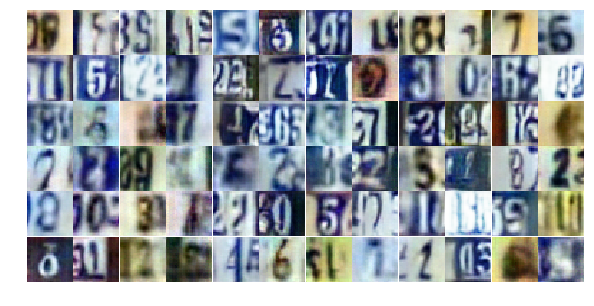

Epoch 24/25... Discriminator Loss: 1.5806... Generator Loss: 0.3786
Epoch 24/25... Discriminator Loss: 0.6860... Generator Loss: 1.1112
Epoch 24/25... Discriminator Loss: 2.0241... Generator Loss: 0.2455
Epoch 24/25... Discriminator Loss: 1.5734... Generator Loss: 0.3982
Epoch 24/25... Discriminator Loss: 0.6076... Generator Loss: 1.7279
Epoch 24/25... Discriminator Loss: 1.1088... Generator Loss: 0.6246
Epoch 24/25... Discriminator Loss: 0.5176... Generator Loss: 1.5593
Epoch 24/25... Discriminator Loss: 1.1270... Generator Loss: 0.6004
Epoch 24/25... Discriminator Loss: 0.7731... Generator Loss: 1.0208
Epoch 24/25... Discriminator Loss: 0.8898... Generator Loss: 0.8605


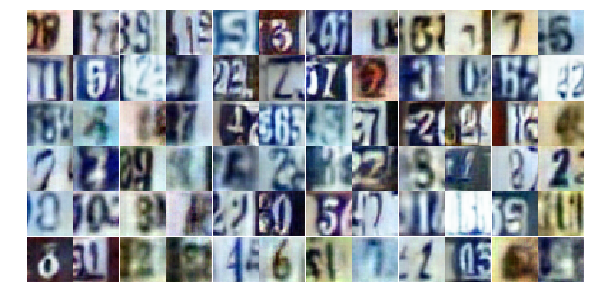

Epoch 24/25... Discriminator Loss: 0.8140... Generator Loss: 0.8567
Epoch 24/25... Discriminator Loss: 0.6626... Generator Loss: 1.0582
Epoch 24/25... Discriminator Loss: 0.6517... Generator Loss: 1.0945
Epoch 24/25... Discriminator Loss: 1.0755... Generator Loss: 0.6215
Epoch 24/25... Discriminator Loss: 0.7585... Generator Loss: 0.8937
Epoch 24/25... Discriminator Loss: 0.4509... Generator Loss: 1.7684
Epoch 24/25... Discriminator Loss: 0.6389... Generator Loss: 1.0867
Epoch 24/25... Discriminator Loss: 0.7226... Generator Loss: 1.1198
Epoch 24/25... Discriminator Loss: 0.6520... Generator Loss: 1.0714
Epoch 24/25... Discriminator Loss: 0.9363... Generator Loss: 0.7171


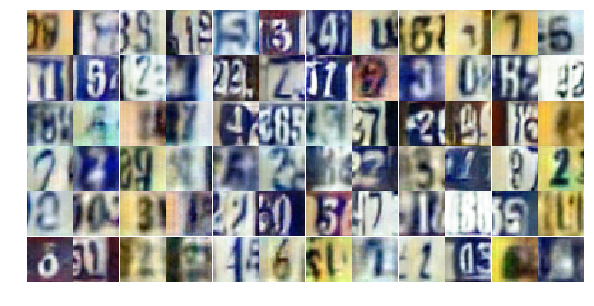

Epoch 24/25... Discriminator Loss: 0.6117... Generator Loss: 1.3024
Epoch 24/25... Discriminator Loss: 0.9264... Generator Loss: 0.7263
Epoch 24/25... Discriminator Loss: 0.8048... Generator Loss: 0.8458
Epoch 24/25... Discriminator Loss: 1.9279... Generator Loss: 0.2588
Epoch 24/25... Discriminator Loss: 0.7446... Generator Loss: 1.3878
Epoch 24/25... Discriminator Loss: 1.0102... Generator Loss: 0.6664
Epoch 24/25... Discriminator Loss: 1.3281... Generator Loss: 0.4696
Epoch 24/25... Discriminator Loss: 0.7635... Generator Loss: 0.9870
Epoch 24/25... Discriminator Loss: 0.9922... Generator Loss: 0.6732
Epoch 24/25... Discriminator Loss: 0.7693... Generator Loss: 1.0187


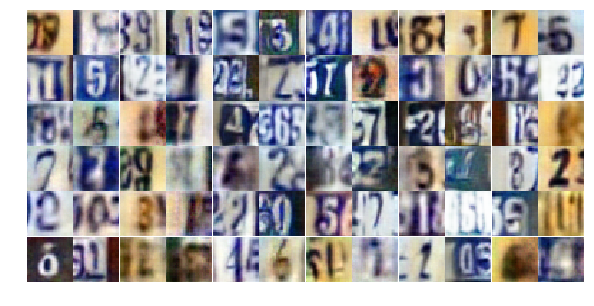

Epoch 24/25... Discriminator Loss: 0.8648... Generator Loss: 0.7589
Epoch 24/25... Discriminator Loss: 0.6317... Generator Loss: 1.0881
Epoch 24/25... Discriminator Loss: 1.0037... Generator Loss: 0.6814
Epoch 24/25... Discriminator Loss: 1.3000... Generator Loss: 0.4639
Epoch 24/25... Discriminator Loss: 1.8410... Generator Loss: 0.2644
Epoch 24/25... Discriminator Loss: 0.6171... Generator Loss: 1.2286
Epoch 24/25... Discriminator Loss: 1.6147... Generator Loss: 0.3243
Epoch 24/25... Discriminator Loss: 0.8275... Generator Loss: 0.8407
Epoch 24/25... Discriminator Loss: 1.0455... Generator Loss: 0.6459
Epoch 24/25... Discriminator Loss: 0.7839... Generator Loss: 1.1325


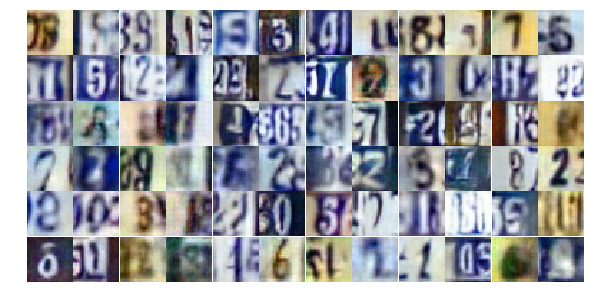

Epoch 24/25... Discriminator Loss: 1.1952... Generator Loss: 0.5109
Epoch 24/25... Discriminator Loss: 1.0954... Generator Loss: 0.6560
Epoch 24/25... Discriminator Loss: 1.2872... Generator Loss: 0.4439
Epoch 24/25... Discriminator Loss: 1.0497... Generator Loss: 2.2783
Epoch 24/25... Discriminator Loss: 0.7693... Generator Loss: 1.2187
Epoch 25/25... Discriminator Loss: 0.9692... Generator Loss: 0.6913
Epoch 25/25... Discriminator Loss: 0.5139... Generator Loss: 1.7705
Epoch 25/25... Discriminator Loss: 1.0868... Generator Loss: 0.5781
Epoch 25/25... Discriminator Loss: 0.9229... Generator Loss: 0.7684
Epoch 25/25... Discriminator Loss: 0.8193... Generator Loss: 0.8797


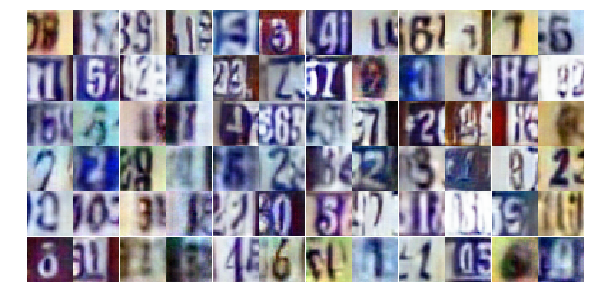

Epoch 25/25... Discriminator Loss: 0.6216... Generator Loss: 1.2091
Epoch 25/25... Discriminator Loss: 1.0859... Generator Loss: 0.6491
Epoch 25/25... Discriminator Loss: 0.5617... Generator Loss: 1.2175
Epoch 25/25... Discriminator Loss: 0.6617... Generator Loss: 1.2977
Epoch 25/25... Discriminator Loss: 0.8183... Generator Loss: 1.0201
Epoch 25/25... Discriminator Loss: 0.6847... Generator Loss: 1.1176
Epoch 25/25... Discriminator Loss: 1.1648... Generator Loss: 0.5977
Epoch 25/25... Discriminator Loss: 0.6375... Generator Loss: 1.2774
Epoch 25/25... Discriminator Loss: 0.4562... Generator Loss: 1.5582
Epoch 25/25... Discriminator Loss: 1.0803... Generator Loss: 0.6875


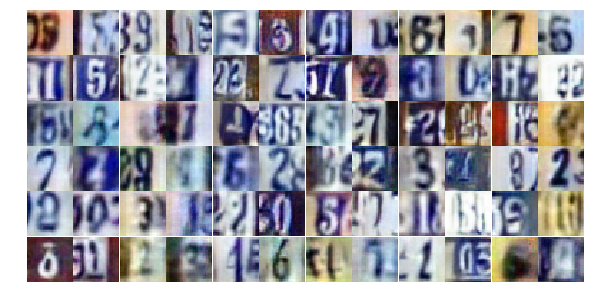

Epoch 25/25... Discriminator Loss: 0.7874... Generator Loss: 0.9585
Epoch 25/25... Discriminator Loss: 0.5774... Generator Loss: 2.4793
Epoch 25/25... Discriminator Loss: 1.5268... Generator Loss: 0.4205
Epoch 25/25... Discriminator Loss: 0.5389... Generator Loss: 1.8838
Epoch 25/25... Discriminator Loss: 1.0359... Generator Loss: 0.8711
Epoch 25/25... Discriminator Loss: 0.6933... Generator Loss: 1.2151
Epoch 25/25... Discriminator Loss: 0.9198... Generator Loss: 0.7433
Epoch 25/25... Discriminator Loss: 0.8887... Generator Loss: 1.2469
Epoch 25/25... Discriminator Loss: 0.5367... Generator Loss: 1.2997
Epoch 25/25... Discriminator Loss: 1.0789... Generator Loss: 0.6759


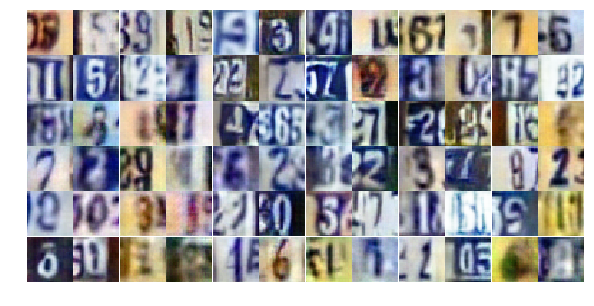

Epoch 25/25... Discriminator Loss: 0.7261... Generator Loss: 1.0574
Epoch 25/25... Discriminator Loss: 0.6313... Generator Loss: 1.1155
Epoch 25/25... Discriminator Loss: 1.4000... Generator Loss: 0.4600
Epoch 25/25... Discriminator Loss: 1.0940... Generator Loss: 0.5453
Epoch 25/25... Discriminator Loss: 0.7002... Generator Loss: 1.3332
Epoch 25/25... Discriminator Loss: 0.8356... Generator Loss: 0.7672
Epoch 25/25... Discriminator Loss: 0.7980... Generator Loss: 0.9489
Epoch 25/25... Discriminator Loss: 0.9843... Generator Loss: 0.8222
Epoch 25/25... Discriminator Loss: 1.1331... Generator Loss: 2.3795
Epoch 25/25... Discriminator Loss: 0.5510... Generator Loss: 1.3261


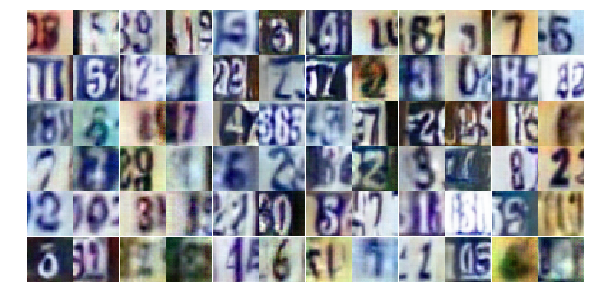

Epoch 25/25... Discriminator Loss: 0.8862... Generator Loss: 0.9083
Epoch 25/25... Discriminator Loss: 0.5133... Generator Loss: 1.2511
Epoch 25/25... Discriminator Loss: 0.7725... Generator Loss: 0.9996
Epoch 25/25... Discriminator Loss: 0.6541... Generator Loss: 1.0936
Epoch 25/25... Discriminator Loss: 1.2914... Generator Loss: 0.5191
Epoch 25/25... Discriminator Loss: 0.7138... Generator Loss: 0.9440
Epoch 25/25... Discriminator Loss: 0.4651... Generator Loss: 1.5232
Epoch 25/25... Discriminator Loss: 0.6776... Generator Loss: 1.2000
Epoch 25/25... Discriminator Loss: 1.8963... Generator Loss: 0.2626
Epoch 25/25... Discriminator Loss: 0.7917... Generator Loss: 0.9552


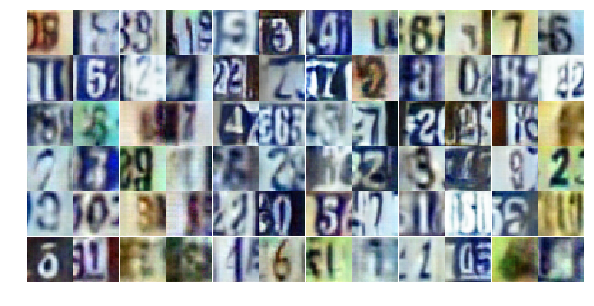

Epoch 25/25... Discriminator Loss: 0.7381... Generator Loss: 1.6865
Epoch 25/25... Discriminator Loss: 0.8400... Generator Loss: 0.9367
Epoch 25/25... Discriminator Loss: 0.9225... Generator Loss: 0.8213
Epoch 25/25... Discriminator Loss: 1.0721... Generator Loss: 0.6405
Epoch 25/25... Discriminator Loss: 0.6736... Generator Loss: 1.3652
Epoch 25/25... Discriminator Loss: 0.6180... Generator Loss: 1.1725
Epoch 25/25... Discriminator Loss: 1.8993... Generator Loss: 0.2921
Epoch 25/25... Discriminator Loss: 0.6410... Generator Loss: 1.2137
Epoch 25/25... Discriminator Loss: 0.7264... Generator Loss: 1.1534
Epoch 25/25... Discriminator Loss: 0.7022... Generator Loss: 1.0224


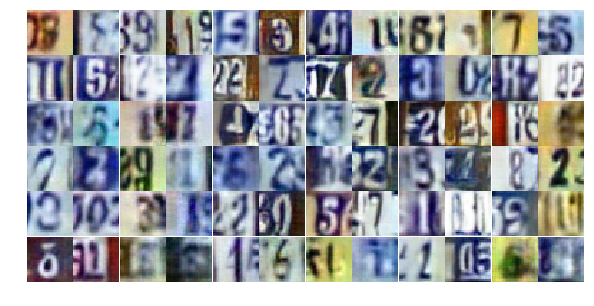

Epoch 25/25... Discriminator Loss: 0.8511... Generator Loss: 0.9288
Epoch 25/25... Discriminator Loss: 1.8747... Generator Loss: 0.3047


In [19]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

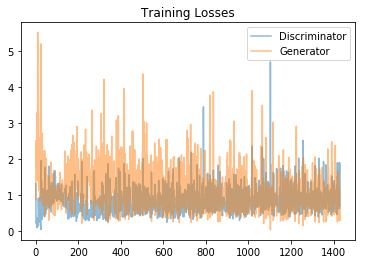

In [20]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

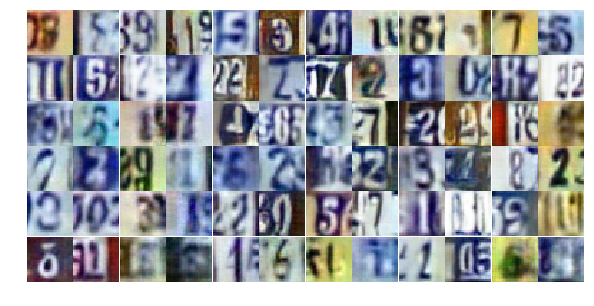

In [21]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))